This notebook contains code to create all the main and supplementary figures in Bartusek et al., 2023 ("Higher-resolution tropopause folding accounts for more stratospheric ozone intrusions", Geophys. Res. Lett.). The folding algorithm and compositing scripts that are also in this code repository are necessary to generate some of the data that this notebook uses. _Samuel Bartusek, March 2023_

# Imports and definitions

In [3]:
import numpy as np
from numpy import diff
import xarray as xr
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import ticker
from matplotlib import cm
import matplotlib.cm
from matplotlib.colors import ListedColormap
from matplotlib import colors
import cartopy.crs as ccrs
import cartopy
from cartopy.util import add_cyclic_point
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import scipy
import scipy.stats as ss
from scipy.interpolate import griddata
from scipy.signal import argrelmin
from scipy.ndimage import interpolation
import scipy.signal
import dask.diagnostics as dd
import dask.array as da
from dask.diagnostics import ProgressBar
pbar = ProgressBar() 
import xskillscore
import gc
import glob
import re
import copy
import datetime
import time
import os
import math
import pickle

# modify turbo colormap:
turbo_colormap_data = [[0.18995,0.07176,0.23217],[0.19483,0.08339,0.26149],[0.19956,0.09498,0.29024],[0.20415,0.10652,0.31844],[0.20860,0.11802,0.34607],[0.21291,0.12947,0.37314],[0.21708,0.14087,0.39964],[0.22111,0.15223,0.42558],[0.22500,0.16354,0.45096],[0.22875,0.17481,0.47578],[0.23236,0.18603,0.50004],[0.23582,0.19720,0.52373],[0.23915,0.20833,0.54686],[0.24234,0.21941,0.56942],[0.24539,0.23044,0.59142],[0.24830,0.24143,0.61286],[0.25107,0.25237,0.63374],[0.25369,0.26327,0.65406],[0.25618,0.27412,0.67381],[0.25853,0.28492,0.69300],[0.26074,0.29568,0.71162],[0.26280,0.30639,0.72968],[0.26473,0.31706,0.74718],[0.26652,0.32768,0.76412],[0.26816,0.33825,0.78050],[0.26967,0.34878,0.79631],[0.27103,0.35926,0.81156],[0.27226,0.36970,0.82624],[0.27334,0.38008,0.84037],[0.27429,0.39043,0.85393],[0.27509,0.40072,0.86692],[0.27576,0.41097,0.87936],[0.27628,0.42118,0.89123],[0.27667,0.43134,0.90254],[0.27691,0.44145,0.91328],[0.27701,0.45152,0.92347],[0.27698,0.46153,0.93309],[0.27680,0.47151,0.94214],[0.27648,0.48144,0.95064],[0.27603,0.49132,0.95857],[0.27543,0.50115,0.96594],[0.27469,0.51094,0.97275],[0.27381,0.52069,0.97899],[0.27273,0.53040,0.98461],[0.27106,0.54015,0.98930],[0.26878,0.54995,0.99303],[0.26592,0.55979,0.99583],[0.26252,0.56967,0.99773],[0.25862,0.57958,0.99876],[0.25425,0.58950,0.99896],[0.24946,0.59943,0.99835],[0.24427,0.60937,0.99697],[0.23874,0.61931,0.99485],[0.23288,0.62923,0.99202],[0.22676,0.63913,0.98851],[0.22039,0.64901,0.98436],[0.21382,0.65886,0.97959],[0.20708,0.66866,0.97423],[0.20021,0.67842,0.96833],[0.19326,0.68812,0.96190],[0.18625,0.69775,0.95498],[0.17923,0.70732,0.94761],[0.17223,0.71680,0.93981],[0.16529,0.72620,0.93161],[0.15844,0.73551,0.92305],[0.15173,0.74472,0.91416],[0.14519,0.75381,0.90496],[0.13886,0.76279,0.89550],[0.13278,0.77165,0.88580],[0.12698,0.78037,0.87590],[0.12151,0.78896,0.86581],[0.11639,0.79740,0.85559],[0.11167,0.80569,0.84525],[0.10738,0.81381,0.83484],[0.10357,0.82177,0.82437],[0.10026,0.82955,0.81389],[0.09750,0.83714,0.80342],[0.09532,0.84455,0.79299],[0.09377,0.85175,0.78264],[0.09287,0.85875,0.77240],[0.09267,0.86554,0.76230],[0.09320,0.87211,0.75237],[0.09451,0.87844,0.74265],[0.09662,0.88454,0.73316],[0.09958,0.89040,0.72393],[0.10342,0.89600,0.71500],[0.10815,0.90142,0.70599],[0.11374,0.90673,0.69651],[0.12014,0.91193,0.68660],[0.12733,0.91701,0.67627],[0.13526,0.92197,0.66556],[0.14391,0.92680,0.65448],[0.15323,0.93151,0.64308],[0.16319,0.93609,0.63137],[0.17377,0.94053,0.61938],[0.18491,0.94484,0.60713],[0.19659,0.94901,0.59466],[0.20877,0.95304,0.58199],[0.22142,0.95692,0.56914],[0.23449,0.96065,0.55614],[0.24797,0.96423,0.54303],[0.26180,0.96765,0.52981],[0.27597,0.97092,0.51653],[0.29042,0.97403,0.50321],[0.30513,0.97697,0.48987],[0.32006,0.97974,0.47654],[0.33517,0.98234,0.46325],[0.35043,0.98477,0.45002],[0.36581,0.98702,0.43688],[0.38127,0.98909,0.42386],[0.39678,0.99098,0.41098],[0.41229,0.99268,0.39826],[0.42778,0.99419,0.38575],[0.44321,0.99551,0.37345],[0.45854,0.99663,0.36140],[0.47375,0.99755,0.34963],[0.48879,0.99828,0.33816],[0.50362,0.99879,0.32701],[0.51822,0.99910,0.31622],[0.53255,0.99919,0.30581],[0.54658,0.99907,0.29581],[0.56026,0.99873,0.28623],[0.57357,0.99817,0.27712],[0.58646,0.99739,0.26849],[0.59891,0.99638,0.26038],[0.61088,0.99514,0.25280],[0.62233,0.99366,0.24579],[0.63323,0.99195,0.23937],[0.64362,0.98999,0.23356],[0.65394,0.98775,0.22835],[0.66428,0.98524,0.22370],[0.67462,0.98246,0.21960],[0.68494,0.97941,0.21602],[0.69525,0.97610,0.21294],[0.70553,0.97255,0.21032],[0.71577,0.96875,0.20815],[0.72596,0.96470,0.20640],[0.73610,0.96043,0.20504],[0.74617,0.95593,0.20406],[0.75617,0.95121,0.20343],[0.76608,0.94627,0.20311],[0.77591,0.94113,0.20310],[0.78563,0.93579,0.20336],[0.79524,0.93025,0.20386],[0.80473,0.92452,0.20459],[0.81410,0.91861,0.20552],[0.82333,0.91253,0.20663],[0.83241,0.90627,0.20788],[0.84133,0.89986,0.20926],[0.85010,0.89328,0.21074],[0.85868,0.88655,0.21230],[0.86709,0.87968,0.21391],[0.87530,0.87267,0.21555],[0.88331,0.86553,0.21719],[0.89112,0.85826,0.21880],[0.89870,0.85087,0.22038],[0.90605,0.84337,0.22188],[0.91317,0.83576,0.22328],[0.92004,0.82806,0.22456],[0.92666,0.82025,0.22570],[0.93301,0.81236,0.22667],[0.93909,0.80439,0.22744],[0.94489,0.79634,0.22800],[0.95039,0.78823,0.22831],[0.95560,0.78005,0.22836],[0.96049,0.77181,0.22811],[0.96507,0.76352,0.22754],[0.96931,0.75519,0.22663],[0.97323,0.74682,0.22536],[0.97679,0.73842,0.22369],[0.98000,0.73000,0.22161],[0.98289,0.72140,0.21918],[0.98549,0.71250,0.21650],[0.98781,0.70330,0.21358],[0.98986,0.69382,0.21043],[0.99163,0.68408,0.20706],[0.99314,0.67408,0.20348],[0.99438,0.66386,0.19971],[0.99535,0.65341,0.19577],[0.99607,0.64277,0.19165],[0.99654,0.63193,0.18738],[0.99675,0.62093,0.18297],[0.99672,0.60977,0.17842],[0.99644,0.59846,0.17376],[0.99593,0.58703,0.16899],[0.99517,0.57549,0.16412],[0.99419,0.56386,0.15918],[0.99297,0.55214,0.15417],[0.99153,0.54036,0.14910],[0.98987,0.52854,0.14398],[0.98799,0.51667,0.13883],[0.98590,0.50479,0.13367],[0.98360,0.49291,0.12849],[0.98108,0.48104,0.12332],[0.97837,0.46920,0.11817],[0.97545,0.45740,0.11305],[0.97234,0.44565,0.10797],[0.96904,0.43399,0.10294],[0.96555,0.42241,0.09798],[0.96187,0.41093,0.09310],[0.95801,0.39958,0.08831],[0.95398,0.38836,0.08362],[0.94977,0.37729,0.07905],[0.94538,0.36638,0.07461],[0.94084,0.35566,0.07031],[0.93612,0.34513,0.06616],[0.93125,0.33482,0.06218],[0.92623,0.32473,0.05837],[0.92105,0.31489,0.05475],[0.91572,0.30530,0.05134],[0.91024,0.29599,0.04814],[0.90463,0.28696,0.04516],[0.89888,0.27824,0.04243],[0.89298,0.26981,0.03993],[0.88691,0.26152,0.03753],[0.88066,0.25334,0.03521],[0.87422,0.24526,0.03297],[0.86760,0.23730,0.03082],[0.86079,0.22945,0.02875],[0.85380,0.22170,0.02677],[0.84662,0.21407,0.02487],[0.83926,0.20654,0.02305],[0.83172,0.19912,0.02131],[0.82399,0.19182,0.01966],[0.81608,0.18462,0.01809],[0.80799,0.17753,0.01660],[0.79971,0.17055,0.01520],[0.79125,0.16368,0.01387],[0.78260,0.15693,0.01264],[0.77377,0.15028,0.01148],[0.76476,0.14374,0.01041],[0.75556,0.13731,0.00942],[0.74617,0.13098,0.00851],[0.73661,0.12477,0.00769],[0.72686,0.11867,0.00695],[0.71692,0.11268,0.00629],[0.70680,0.10680,0.00571],[0.69650,0.10102,0.00522],[0.68602,0.09536,0.00481],[0.67535,0.08980,0.00449],[0.66449,0.08436,0.00424],[0.65345,0.07902,0.00408],[0.64223,0.07380,0.00401],[0.63082,0.06868,0.00401],[0.61923,0.06367,0.00410],[0.60746,0.05878,0.00427],[0.59550,0.05399,0.00453],[0.58336,0.04931,0.00486],[0.57103,0.04474,0.00529],[0.55852,0.04028,0.00579],[0.54583,0.03593,0.00638],[0.53295,0.03169,0.00705],[0.51989,0.02756,0.00780],[0.50664,0.02354,0.00863],[0.49321,0.01963,0.00955],[0.47960,0.01583,0.01055]]
N = 256
vals = np.ones((N, 3))
vals[:, 0] = np.linspace(1, turbo_colormap_data[int(.2*256)][0], N)
vals[:, 1] = np.linspace(1, turbo_colormap_data[int(.2*256)][1], N)
vals[:, 2] = np.linspace(1, turbo_colormap_data[int(.2*256)][2], N)
white_to_turbo_first = ListedColormap(vals)
turbo_rest = ListedColormap(turbo_colormap_data[int(.2*256+1):])
white_to_turbo = np.vstack((white_to_turbo_first(np.linspace(0,1,int(.2*256))),
                            turbo_rest(np.linspace(0,1,int(.8*256)))))
cm.register_cmap('white_to_turbo', cmap=ListedColormap(white_to_turbo))
cm.register_cmap('white_to_turbo_r', cmap=ListedColormap(white_to_turbo[::-1]))

# pressure solutions for hyam & hybm with 1035.24 hPa surface pressure:
plev_CAMSRA = [80.3968,95.9781,113.4212,132.7577,153.9952,177.1176,202.0859,228.8387,257.3558,287.6383,319.6307,353.2256,388.2700,424.5707,461.8996,500.0000,538.5913,577.3754,616.0417,654.2732,691.7515,728.1631,763.2045,796.5879,828.0468,857.3419,884.2660,908.6505,930.3702,949.3494,965.5672,979.0633,989.9435,998.3854,1004.6437,1009.0563,1012.0494] #CAMSRA
plev_CAMSRA_high = [54.6236,66.6233,80.3968,95.9781,113.4212,132.7577,153.9952,177.1176,202.0859,228.8387,257.3558,287.6383,319.6307,353.2256,388.2700,424.5707,461.8996,500.0000,538.5913,577.3754,616.0417,654.2732,691.7515,728.1631,763.2045,796.5879,828.0468,857.3419,884.2660,908.6505,930.3702,949.3494,965.5672,979.0633,989.9435,998.3854,1004.6437,1009.0563,1012.0494]
phalf_CAMSRA_high = [49.0671,60.1802,73.0663,87.7274,104.2288,122.6137,142.9017,165.0886,189.1466,215.0251,242.6523,272.0593,303.2174,336.0439,370.4072,406.1328,443.0086,480.7907,519.2093,557.9734,596.7774,635.306,673.2403,710.2627,746.0635,780.3455,812.8303,843.2634,871.4203,897.1118,920.1893,940.5511,958.1477,972.9868,985.1399,994.7472,1002.0236,1007.2639,1010.8487,1013.25]
plev_ERA5 = [88.5112,93.3527,98.4164,103.7100,109.2417,115.0198,121.0526,127.3487,133.9170,140.7663,147.9058,155.3448,163.0927,171.1591,179.5537,188.2867,197.3679,206.8078,216.6166,226.8050,237.3837,248.3634,259.7553,271.5704,283.8200,296.5155,309.6684,323.2904,337.3932,351.9887,367.0889,382.7058,398.8516,415.5387,432.7792,450.5858,468.9708,487.9470,507.5021,527.5696,548.0312,568.7678,589.6797,610.6646,631.6194,652.4424,673.0352,693.3043,713.1631,732.5325,751.3426,769.5329,787.0528,803.8622,819.9302,835.2358,849.7668,863.5190,876.4957,888.7066,900.1669,910.8965,920.9193,930.2618,938.9532,947.0240,954.5059,961.4311,967.8315,973.7392,979.1852,984.2002,988.8133,993.0527,996.9452,1000.5165,1003.7906,1006.7900,1009.5363,1012.0494] #ERA5
plev_ERA5_high = [59.7721,63.4151,67.1941,71.1187,75.1999,79.4496,83.8816,88.5112,93.3527,98.4164,103.7100,109.2417,115.0198,121.0526,127.3487,133.9170,140.7663,147.9058,155.3448,163.0927,171.1591,179.5537,188.2867,197.3679,206.8078,216.6166,226.8050,237.3837,248.3634,259.7553,271.5704,283.8200,296.5155,309.6684,323.2904,337.3932,351.9887,367.0889,382.7058,398.8516,415.5387,432.7792,450.5858,468.9708,487.9470,507.5021,527.5696,548.0312,568.7678,589.6797,610.6646,631.6194,652.4424,673.0352,693.3043,713.1631,732.5325,751.3426,769.5329,787.0528,803.8622,819.9302,835.2358,849.7668,863.5190,876.4957,888.7066,900.1669,910.8965,920.9193,930.2618,938.9532,947.0240,954.5059,961.4311,967.8315,973.7392,979.1852,984.2002,988.8133,993.0527,996.9452,1000.5165,1003.7906,1006.7900,1009.5363,1012.0494] #ERA5
phalf_ERA5_high = [57.9834,61.5607,65.2695,69.1187,73.1187,77.281,81.6182,86.145,90.8774,95.828,101.0047,106.4153,112.0681,117.9714,124.1337,130.5637,137.2703,144.2624,151.5493,159.1403,167.045,175.2731,183.8344,192.7389,201.9969,211.6186,221.6146,231.9954,242.7719,253.9549,265.5556,277.5852,290.0548,302.9762,316.3607,330.2202,344.5663,359.4111,374.7666,390.645,407.0583,424.019,441.5395,459.6321,478.3096,497.5845,517.4198,537.7195,558.343,579.1926,600.1668,621.1624,642.0764,662.8084,683.262,703.3467,722.9795,742.0855,760.5996,778.4661,795.6396,812.0847,827.7756,842.6959,856.8376,870.2004,882.791,894.6222,905.7116,916.0815,925.7571,934.7666,943.1399,950.9082,958.1037,964.7584,970.9046,976.5737,981.7968,986.6036,991.023,995.0824,998.8081,1002.225,1005.3562,1008.2239,1010.8487,1013.25]

path_CAMSRA = '/dx13/samuelb/trop_folds/'
path_ERA5 = '/dx13/samuelb/trop_folds/'


In [2]:
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    '''
    https://stackoverflow.com/a/18926541
    '''
    if isinstance(cmap, str):
        cmap = plt.get_cmap(cmap)
    new_cmap = mpl.colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n)))
    return new_cmap

def r_val(x, y):
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x, y)
    return xr.DataArray(r_value)
def p_val(x, y):
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x, y)
    return xr.DataArray(p_value)

def spearr(x, y):
    r_value, p_value = scipy.stats.spearmanr(x, y)
    return xr.DataArray(r_value)
def spearp(x, y):
    r_value, p_value = scipy.stats.spearmanr(x, y)
    return xr.DataArray(p_value)

def pearsr(x, y):
    r_value, p_value = scipy.stats.pearsonr(x, y)
    return xr.DataArray(r_value)
def pearsp(x, y):
    r_value, p_value = scipy.stats.pearsonr(x, y)
    return xr.DataArray(p_value)

def covv(x, y):
    covv = np.cov(x, y)
    return xr.DataArray(covv[0][1])

# https://github.com/darothen/plot-all-in-ncfile/blob/master/plot_util.py
def cyclic_dataarray(da, coord):#='longitude'):
    """ Add a cyclic coordinate point to a DataArray along a specified
    named coordinate dimension.
    """
    assert isinstance(da, xr.DataArray)

    lon_idx = da.dims.index(coord)
    cyclic_data, cyclic_coord = add_cyclic_point(da.values,
                                                 coord=da.coords[coord],
                                                 axis=lon_idx)

    # Copy and add the cyclic coordinate and data
    new_coords = dict(da.coords)
    new_coords[coord] = cyclic_coord
    new_values = cyclic_data

    new_da = xr.DataArray(new_values, dims=da.dims, coords=new_coords)

    # Copy the attributes for the re-constructed data and coords
    for att, val in da.attrs.items():
        new_da.attrs[att] = val
    for c in da.coords:
        for att in da.coords[c].attrs:
            new_da.coords[c].attrs[att] = da.coords[c].attrs[att]

    return new_da


# Creating datasets

In [7]:
# FOLDING

# NORMAL
dscam = xr.open_mfdataset(glob.glob(path_ERA5 + '/comboedit2/CAMSRA_fold_2012-??-??_high_presfix.nc')).assign_coords(plev=('lev',plev_CAMSRA_high)).swap_dims({'lev':'plev'})  # ,combine='by_coords',concat_dim='time'
camfold = dscam.sfold + dscam.mfold + dscam.dfold #dscam.dfold #dscam.sfold + dscam.mfold + 
camfoldall = dscam.fold
camfoldd = dscam.dfold
camfoldm = dscam.mfold
camfolds = dscam.sfold
camtrop = dscam.tp

dsera = xr.open_mfdataset(glob.glob(path_ERA5 + '/comboedit2/ERA5_fold_2012-??-??_high_presfix.nc')).assign_coords(plev=('lev',plev_ERA5_high)).swap_dims({'lev':'plev'})  # ,combine='by_coords',concat_dim='time'
erafold = dsera.sfold + dsera.mfold + dsera.dfold # dsera.dfold #dsera.sfold + dsera.mfold + 
erafoldall = dsera.fold
erafoldd = dsera.dfold
erafoldm = dsera.mfold
erafolds = dsera.sfold
eratrop = dsera.tp

# OFF-HOURS (03:00, 09:00, 15:00, 21:00) for January only
dscamoff = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/comboedit2/CAMSRA_fold_offhours_2012-??-??_high_presfix.nc')).assign_coords(plev=('lev',plev_CAMSRA_high)).swap_dims({'lev':'plev'})  # ,combine='by_coords',concat_dim='time'
camfoldoff = dscamoff.sfold + dscamoff.mfold + dscamoff.dfold #dscam.dfold #dscam.sfold + dscam.mfold + 
camfoldalloff = dscamoff.fold
camfolddoff = dscamoff.dfold
camfoldmoff = dscamoff.mfold
camfoldsoff = dscamoff.sfold
camtropoff = dscamoff.tp

dseraoff = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/comboedit2/ERA5_fold_offhours_2012-??-??_high_presfix.nc')).assign_coords(plev=('lev',plev_ERA5_high)).swap_dims({'lev':'plev'})  # ,combine='by_coords',concat_dim='time'
erafoldoff = dseraoff.sfold + dseraoff.mfold + dseraoff.dfold # dsera.dfold #dsera.sfold + dsera.mfold + 
erafoldalloff = dseraoff.fold
erafolddoff = dseraoff.dfold
erafoldmoff = dseraoff.mfold
erafoldsoff = dseraoff.sfold
eratropoff = dseraoff.tp

# REGRID (high vertical res., low horizontal res.)
dseraregrid = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/comboedit2/regrid/ERA5_regrid_fold_2012-??-??_high_presfix.nc')).assign_coords(plev=('lev',plev_ERA5_high)).swap_dims({'lev':'plev'})  # ,combine='by_coords',concat_dim='time'
eraregridfold = dseraregrid.sfold + dseraregrid.mfold + dseraregrid.dfold # dsera.dfold #dsera.sfold + dsera.mfold + 
eraregridfoldall = dseraregrid.fold
eraregridfoldd = dseraregrid.dfold
eraregridfoldm = dseraregrid.mfold
eraregridfolds = dseraregrid.sfold
eraregridtrop = dseraregrid.tp

# RELEVEL (high horizontal res., low vertical res.)
dserarelevel = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/comboedit2/relevel/ERA5_fold_2012-??-??_high_presfix.nc')).assign_coords(plev=('lev',plev_CAMSRA_high)).swap_dims({'lev':'plev'})  # ,combine='by_coords',concat_dim='time'
erarelevelfold = dserarelevel.sfold + dserarelevel.mfold + dserarelevel.dfold # dsera.dfold #dsera.sfold + dsera.mfold + 
erarelevelfoldall = dserarelevel.fold
erarelevelfoldd = dserarelevel.dfold
erarelevelfoldm = dserarelevel.mfold
erarelevelfolds = dserarelevel.sfold
erareleveltrop = dserarelevel.tp

# RELEVEL REGRID (low both res.)
dserarelevelregrid = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/ERA5_fold_2012-??-??_high_presfix.nc')).assign_coords(plev=('lev',plev_CAMSRA_high)).swap_dims({'lev':'plev'})  # ,combine='by_coords',concat_dim='time'
erarelevelregridfold = dserarelevelregrid.sfold + dserarelevelregrid.mfold + dserarelevelregrid.dfold # dsera.dfold #dsera.sfold + dsera.mfold + 
erarelevelregridfoldall = dserarelevelregrid.fold
erarelevelregridfoldd = dserarelevelregrid.dfold
erarelevelregridfoldm = dserarelevelregrid.mfold
erarelevelregridfolds = dserarelevelregrid.sfold
erarelevelregridtrop = dserarelevelregrid.tp


In [5]:
# OZONE FROM PRESSURE LEVELS (CAMSRA)

o3_tot = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/CAMSRA_O3_O3S_250_500_850_2012-??-??_presfix.nc')).rename({'longitude':'lon','latitude':'lat'}).o3
o3s_tot = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/CAMSRA_O3_O3S_250_500_850_2012-??-??_presfix.nc')).rename({'longitude':'lon','latitude':'lat'}).o3s

o3_upper = o3_tot.sel(plev=250)
o3_mid = o3_tot.sel(plev=500)
o3_lower = o3_tot.sel(plev=850)
o3s_upper = o3s_tot.sel(plev=250)
o3s_mid = o3s_tot.sel(plev=500)
o3s_lower = o3s_tot.sel(plev=850)

o3so3_mid = o3s_mid / o3_mid
o3so3_lower = o3s_lower / o3_lower
o3so3_upper = o3s_upper / o3_upper


In [570]:
# OZONE FROM PRESSURE LEVELS (CAMSRA) (OFF-HOURS, FOR JANUARY)

o3off_tot = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/CAMSRA_O3_O3S_250_500_850_offhours_2012-??-??_presfix.nc')).rename({'longitude':'lon','latitude':'lat'}).o3
o3soff_tot = xr.open_mfdataset(glob.glob('/dx15/samuelb/trop_folds/CAMSRA_O3_O3S_250_500_850_offhours_2012-??-??_presfix.nc')).rename({'longitude':'lon','latitude':'lat'}).o3s

o3off_upper = o3off_tot.sel(plev=250)
o3off_mid = o3off_tot.sel(plev=500)
o3off_lower = o3off_tot.sel(plev=850)
o3soff_upper = o3soff_tot.sel(plev=250)
o3soff_mid = o3soff_tot.sel(plev=500)
o3soff_lower = o3soff_tot.sel(plev=850)


In [1176]:
# Q FROM PRESSURE LEVELS

q_tot = xr.open_dataset('/dx09/samuelb/CAMSRA_q_250_500_850_2012.nc').rename({'longitude':'lon','latitude':'lat'})
q_mid = q_tot.sel(level=500).q
q_upper = q_tot.sel(level=250).q
q_lower = q_tot.sel(level=850).q

# W FROM PRESSURE LEVELS

w_tot = xr.open_dataset('/dx09/samuelb/CAMSRA_w_250_500_850_2012.nc').rename({'longitude':'lon','latitude':'lat'})
w_mid = w_tot.sel(level=500).w
w_upper = w_tot.sel(level=250).w
w_lower = w_tot.sel(level=850).w


In [6]:
# OZONE FROM PRESSURE LEVELS (ERA5)

o3_tot_era5 = xr.open_mfdataset('/dx09/samuelb/ERA5_O3_250_500_850_2012-01-01-12Z.nc').isel(time=0).rename({'longitude':'lon','latitude':'lat'})

o3_mid_era5 = o3_tot_era5.sel(level=500).o3
o3_lower_era5 = o3_tot_era5.sel(level=850).o3
o3_upper_era5 = o3_tot_era5.sel(level=250).o3


In [6]:
# OZONE FROM MODEL LEVELS (CAMSRA)

o_tot = xr.open_mfdataset(glob.glob(path_CAMSRA + 'CAMSRA_T_U_V_q_O3_O3S_2012-??-??_high.nc'),combine='by_coords',concat_dim='time').assign_coords(plev=('level',plev_CAMSRA_high)).swap_dims({'level':'plev'})#.sel(time=eratime)
o3so3_tot = xr.open_dataset(path_CAMSRA + 'CAMSRA_O3SO3_2012_high.nc').assign_coords(plev=('level',plev_CAMSRA_high)).swap_dims({'level':'plev'})#.sel(time=eratime)

o3_upper = o_tot.sel(plev=250, method='nearest').go3
o3s_upper = o_tot.sel(plev=250, method='nearest').o3s

o3_mid = o_tot.sel(plev=500, method='nearest').go3
o3s_mid = o_tot.sel(plev=500, method='nearest').o3s

o3_lower = o_tot.sel(plev=850, method='nearest').go3
o3s_lower = o_tot.sel(plev=850, method='nearest').o3s


# 1-timestep fold and ozone cross-section/map comparison (Fig. 1a,c–d, S2)

In [8]:
timestep = 2

camsrapv = xr.open_dataset(path_CAMSRA + 'CAMSRA_PV_PT_q_ps_hyam_hybm_2012-01-01_high_presfix.nc').assign_coords(plev=('level',plev_CAMSRA_high)).swap_dims({'level':'plev'}).pv.isel(time=timestep).sel(longitude=270,method='nearest').sel(latitude=slice(65,30))

era5pv = xr.open_dataset(path_CAMSRA + 'ERA5_PV_PT_q_ps_hyam_hybm_2012-01-01_high_presfix.nc').assign_coords(plev=('level',plev_ERA5_high)).swap_dims({'level':'plev'}).pv.isel(time=timestep).sel(longitude=270,method='nearest').sel(latitude=slice(65,30))

oz = xr.open_mfdataset(glob.glob('/dx02/samuelb/CAMSRA_T_U_V_q_O3_O3S_2012-??-??_high.nc')).assign_coords(plev=('level',plev_CAMSRA_high)).swap_dims({'level':'plev'}).go3.sel(longitude=270,method='nearest').sel(latitude=slice(65,30)).isel(time=timestep)


/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/xarray/conventions.py:516: SerializationWarning: variable 'sp' has multiple fill values {-32767, 32767}, decoding all values to NaN.
  new_vars[k] = decode_cf_variable(


Text(53.4, 825, '01/01/2012, 12:00 UTC')

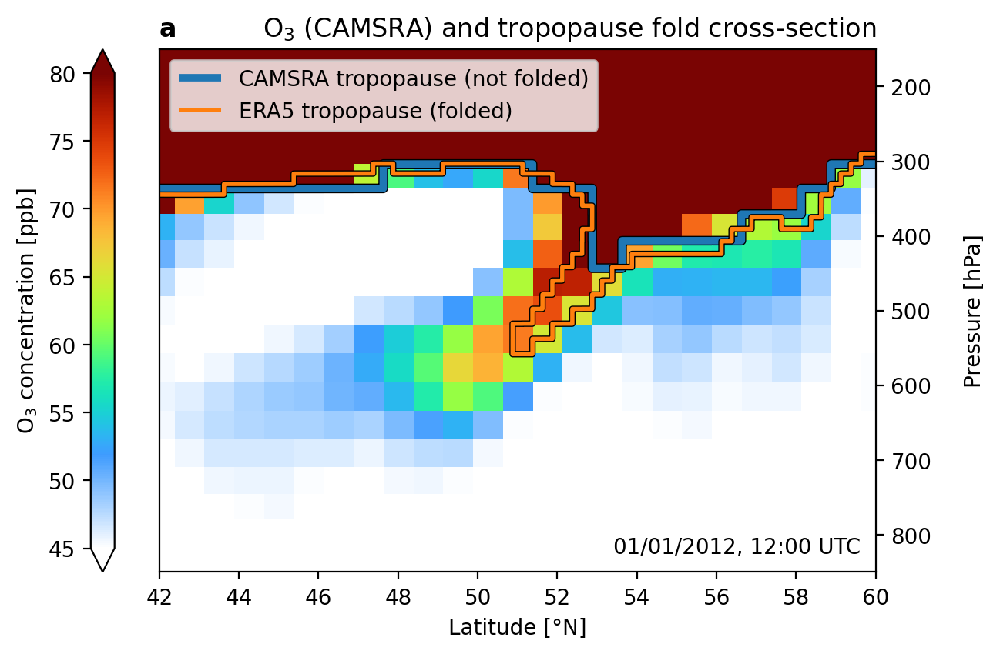

In [9]:
unitfac = 28.9644 / 47.9982 * 1e9 # kg/kg -> ppbv

# Data ranges
xrr = [42, 60]
yrr = [150, 850]
extent = [42,60,150,850]

# Data
camplot = camsrapv.sel(latitude=slice(xrr[1],xrr[0]),plev=slice(yrr[0],yrr[1]))
eraplot = era5pv.sel(latitude=slice(xrr[1],xrr[0]),plev=slice(yrr[0],yrr[1]))
ozplot = oz.sel(latitude=slice(xrr[1],xrr[0]),plev=slice(yrr[0],yrr[1])) * unitfac

# Plot

plt.figure(figsize=(7.5,4.5),dpi=200)
ax = plt.subplot(111)

vmin=45
vmax=80
axp = ozplot.plot(ax=ax,vmin=vmin,vmax=vmax,cmap='white_to_turbo',add_colorbar=False)
plt.title('')

ax.contour(camplot.interp(latitude=np.linspace(42,60,5000),plev=np.linspace(150,850,5000),method='nearest'), levels=[2], extent=extent, colors='0', linewidths=4.5)
camtrop = ax.contour(camplot.interp(latitude=np.linspace(42,60,5000),plev=np.linspace(150,850,5000),method='nearest'), levels=[2], extent=extent, colors='tab:blue', linewidths=3.5)
ax.contour(eraplot.interp(latitude=np.linspace(42,60,5000),plev=np.linspace(150,700,5000),method='nearest'), levels=[2], extent=[42,60,150,700], colors='0', linewidths=3)
eratrop = ax.contour(eraplot.interp(latitude=np.linspace(42,60,5000),plev=np.linspace(150,700,5000),method='nearest'), levels=[2], extent=[42,60,150,700], colors='tab:orange', linewidths=2)

camtrop.collections[0].set_label('CAMSRA tropopause (not folded)')
eratrop.collections[0].set_label('ERA5 tropopause (folded)')
ax.legend(loc='upper left',frameon=True)
ax.invert_yaxis()
plt.ylim(yrr[1],yrr[0])
plt.xlim(xrr[0],xrr[1])
plt.title('O$_{3}$ (CAMSRA) and tropopause fold cross-section',loc='right')
plt.title('a',fontweight='bold',loc='left')
plt.ylabel('Pressure [hPa]',labelpad=15)
plt.xlabel('Latitude [°N]')
ax.yaxis.set_ticks_position("right")
ax.yaxis.set_label_position("right")
plt.colorbar(axp,ax=[ax],location='left',shrink=1,label='O$_{3}$ concentration [ppb]',extend='both',pad=.05)
plt.annotate(ozplot.time.dt.strftime("%m/%d/%Y, %H:%M UTC").values,xy=(53.4,825),color='0')


In [1247]:
fig1extent = (250,290,30,65)
fig1time = 2
unitfac = 28.9644 / 47.9982 * 1e9 # kg/kg -> ppbv


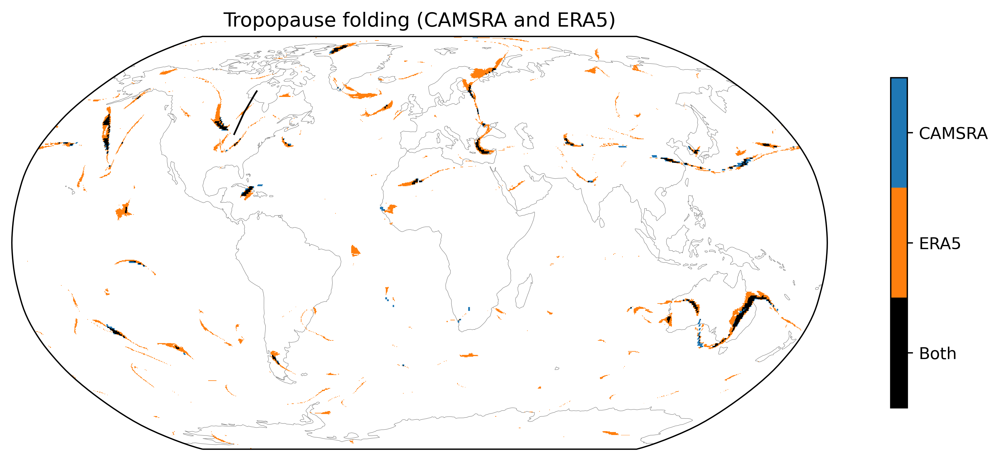

In [1245]:
eraplot = erafold.isel(time=fig1time)
camplot = camfold.isel(time=fig1time).interp(lat=erafold.lat,lon=erafold.lon,method='nearest')
plotfield = (eraplot - camplot).where(eraplot * camplot != 1, 3)
plotfield = plotfield.where(plotfield != 0)

cmap = colors.ListedColormap(['tab:blue', 'tab:orange','0'])
boundaries = [-2, 0, 2, 4]
norm = colors.BoundaryNorm(boundaries, cmap.N, clip=True)

projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=400)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2,zorder=0)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())     # comment out for global extent
pp = plotfield.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),cmap=cmap,norm=norm,add_colorbar=False)

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

cbar = plt.colorbar(pp,shrink=.8) # right one (and use tight_layout)    # shrink=.8 for global extent, .55 for half 
cbar.set_ticks([-1,1,3])
cbar.set_ticklabels(['CAMSRA','ERA5','Both'])
cbar.ax.invert_yaxis()

plt.title(f'Tropopause folding (CAMSRA and ERA5)')

plt.tight_layout()


## CAMSRA

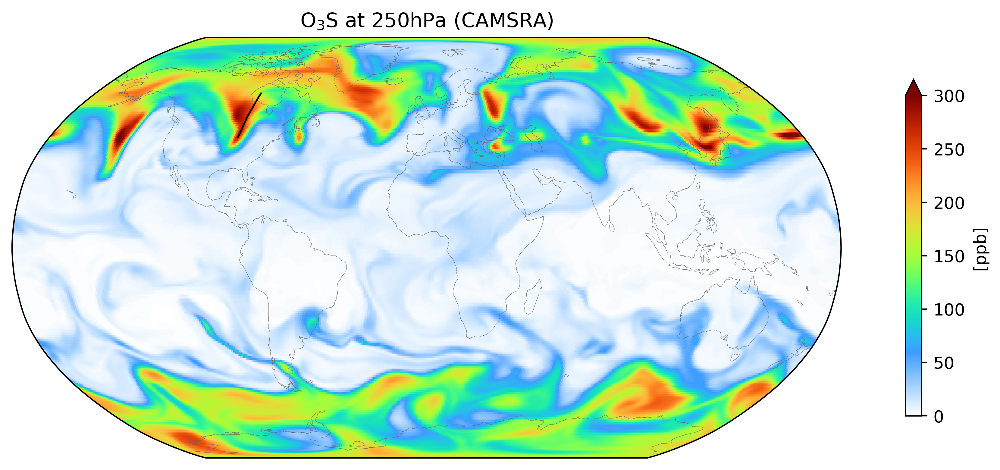

In [1254]:
ozplot = o3s_upper.isel(time=fig1time) * unitfac
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=400)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=6e-7,cmap=cmap,cbar_kwargs={'shrink':.7,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=300,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'[ppb]'})
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$S at 250hPa (CAMSRA)')#', {ozplot.time.dt.strftime("%H:%M UTC %d/%m/%Y").values}')
# plt.title('')

plt.tight_layout()


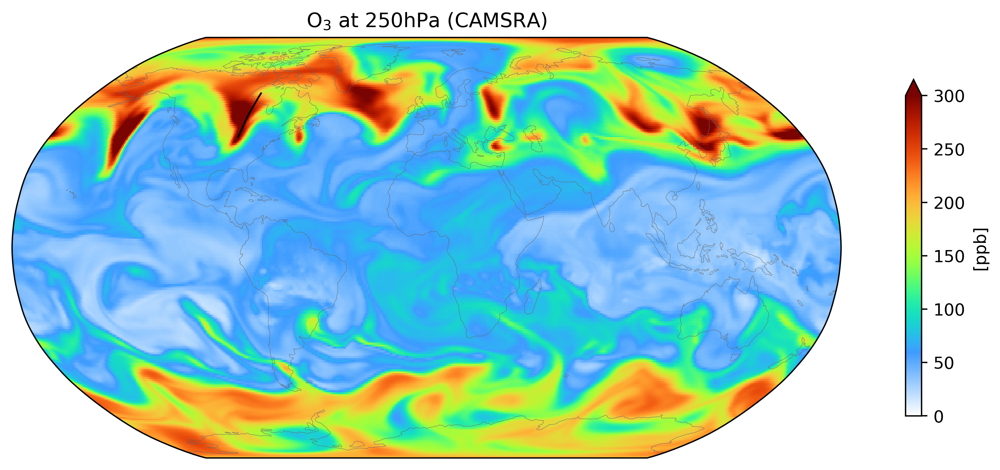

In [1255]:
ozplot = o3_upper.isel(time=fig1time) * unitfac
projection = ccrs.PlateCarree(central_longitude=0)
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=400)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=6e-7,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=300,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'[ppb]'})
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False
#.5e-7,vmax=1.6e-7

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$ at 250hPa (CAMSRA)')#, {ozplot.time.dt.strftime("%H:%M UTC %d/%m/%Y").values}')

plt.tight_layout()


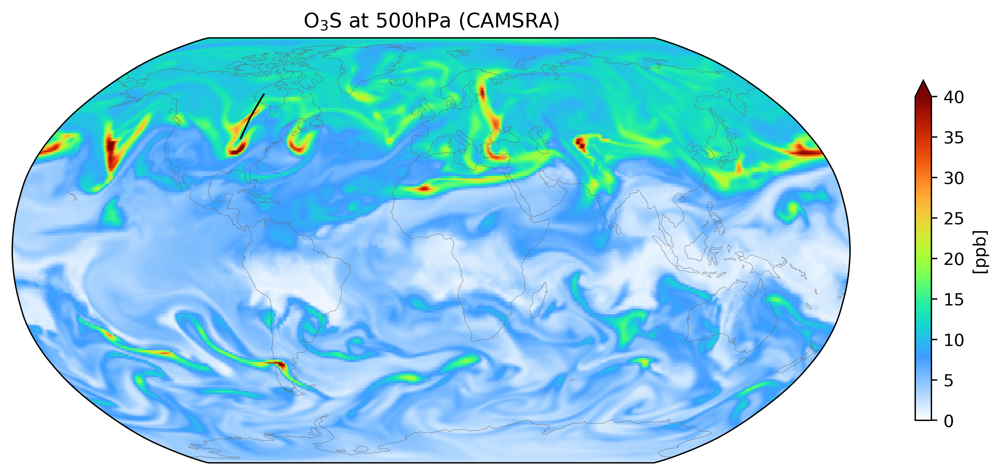

In [1266]:
ozplot = o3s_mid.isel(time=fig1time) * unitfac
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=400)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=7e-8,cmap=cmap,cbar_kwargs={'shrink':.7,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=40,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'[ppb]'})
# 1.75e-8
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$S at 500hPa (CAMSRA)')#', {ozplot.time.dt.strftime("%H:%M UTC %d/%m/%Y").values}')

plt.tight_layout()


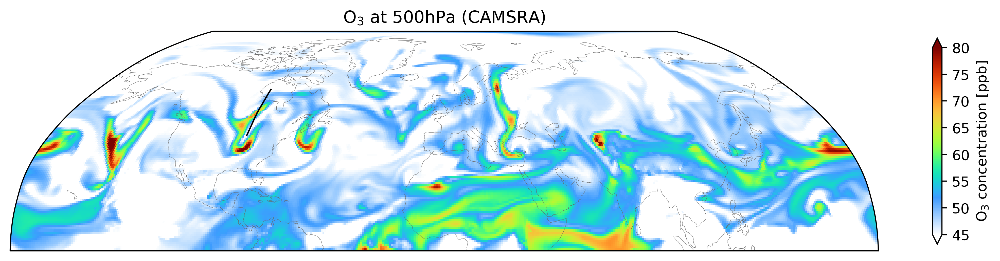

In [980]:
# for figure 1

ozplot = o3_mid.isel(time=fig1time) * unitfac
projection = ccrs.PlateCarree(central_longitude=0)
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=400)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=1.5e-7,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=45,vmax=80,cmap=cmap,cbar_kwargs={'shrink':.55,'label':'O$_{3}$ concentration [ppb]'})
# .75e-7
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False
#.5e-7,vmax=1.6e-7

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$ at 500hPa (CAMSRA)')#, {ozplot.time.dt.strftime("%H:%M UTC %d/%m/%Y").values}')

plt.tight_layout()


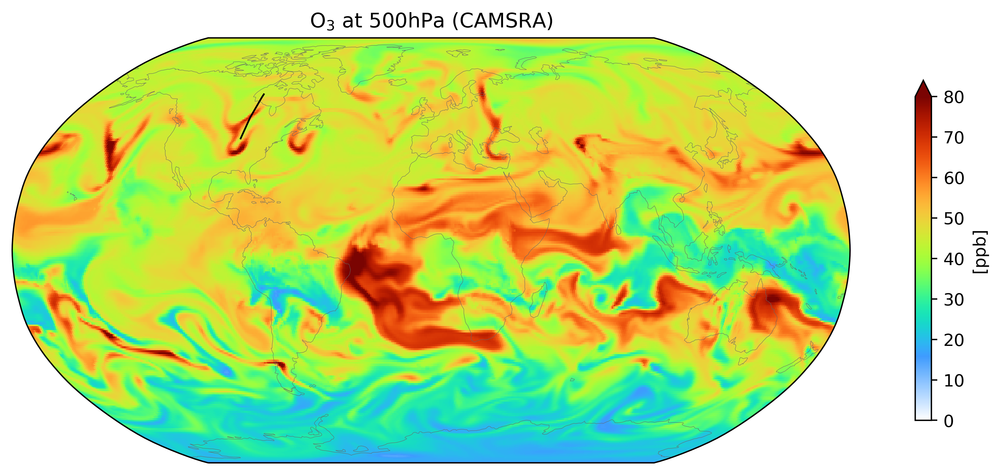

In [1265]:
# for figure S2

ozplot = o3_mid.isel(time=fig1time) * unitfac
projection = ccrs.PlateCarree(central_longitude=0)
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=400)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=1.5e-7,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=80,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'[ppb]'})
# .75e-7
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False
#.5e-7,vmax=1.6e-7

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$ at 500hPa (CAMSRA)')#, {ozplot.time.dt.strftime("%H:%M UTC %d/%m/%Y").values}')

plt.tight_layout()


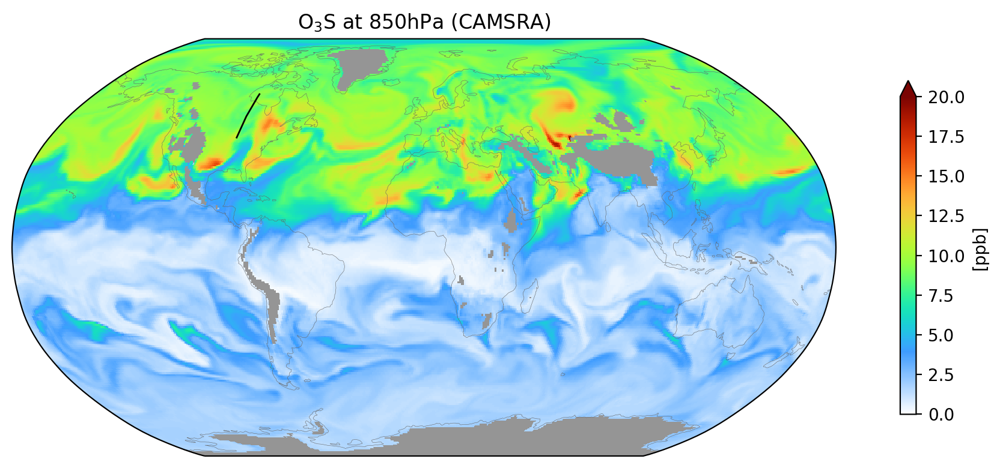

In [1267]:
ozplot = o3s_lower.isel(time=fig1time) * unitfac
cmap = 'white_to_turbo'

projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=200)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=3e-8,cmap=cmap,cbar_kwargs={'shrink':.7,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=20,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'[ppb]'})
ozplot.isnull().where(ozplot.isnull()).plot.imshow(ax=ax,transform=ccrs.PlateCarree(),cmap='Greys',add_colorbar=False)
# 1e-8
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$S at 850hPa (CAMSRA)')

plt.tight_layout()


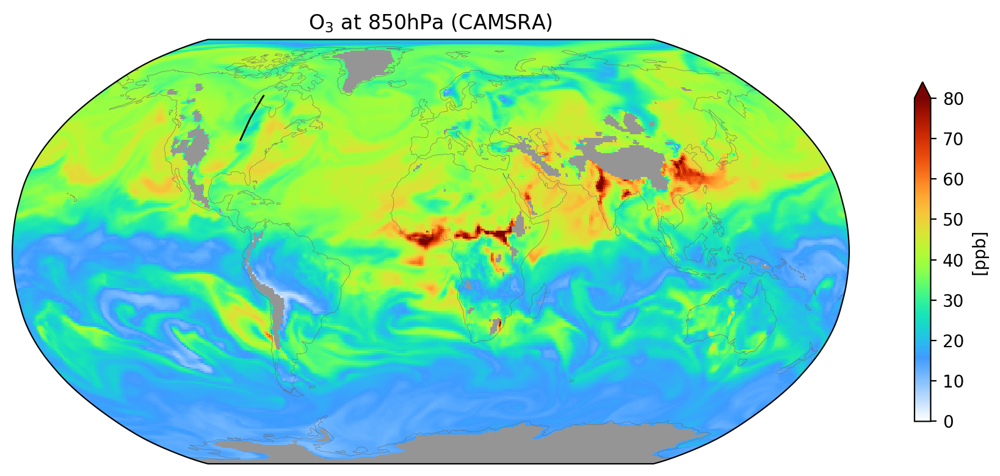

In [1268]:
ozplot = o3_lower.isel(time=fig1time) * unitfac
projection = ccrs.PlateCarree(central_longitude=0)
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=200)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=1.5e-7,cmap=cmap,cbar_kwargs={'shrink':.7,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=80,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'[ppb]'})
ozplot.isnull().where(ozplot.isnull()).plot.imshow(ax=ax,transform=ccrs.PlateCarree(),cmap='Greys',add_colorbar=False)
# .6e-7
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$ at 850hPa (CAMSRA)')

plt.tight_layout()


## ERA5

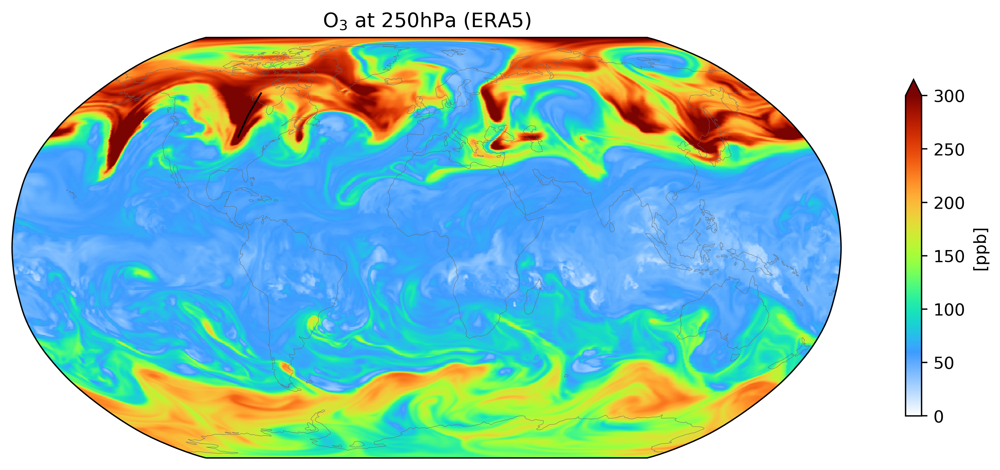

In [1269]:
ozplot = o3_upper_era5 * unitfac
projection = ccrs.PlateCarree(central_longitude=0)
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=400)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=6e-7,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=300,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'[ppb]'})
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False
#.5e-7,vmax=1.6e-7

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$ at 250hPa (ERA5)')#, {ozplot.time.dt.strftime("%H:%M UTC %d/%m/%Y").values}')

plt.tight_layout()


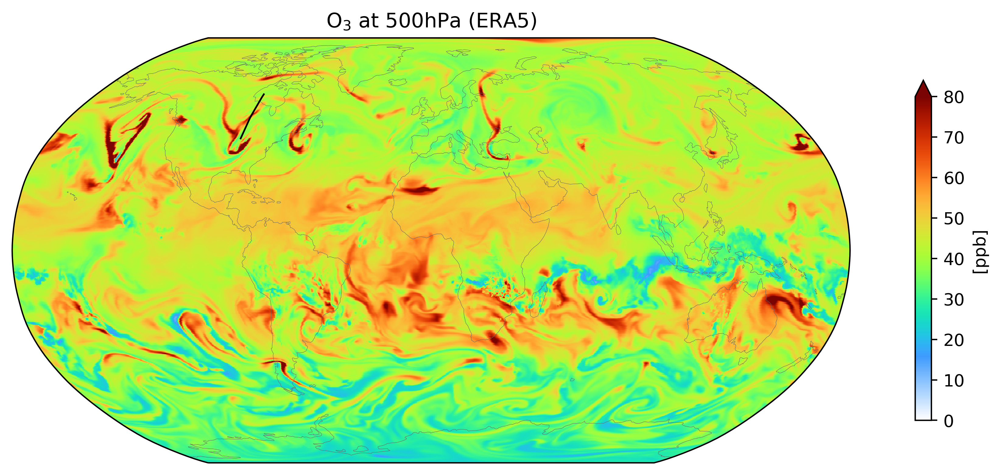

In [1270]:
ozplot = o3_mid_era5 * unitfac
projection = ccrs.PlateCarree(central_longitude=0)
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=400)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=1.5e-7,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=80,cmap=cmap,cbar_kwargs={'shrink':.8,'label':'[ppb]'})
# .75e-7
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False
#.5e-7,vmax=1.6e-7

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$ at 500hPa (ERA5)')#, {ozplot.time.dt.strftime("%H:%M UTC %d/%m/%Y").values}')

plt.tight_layout()


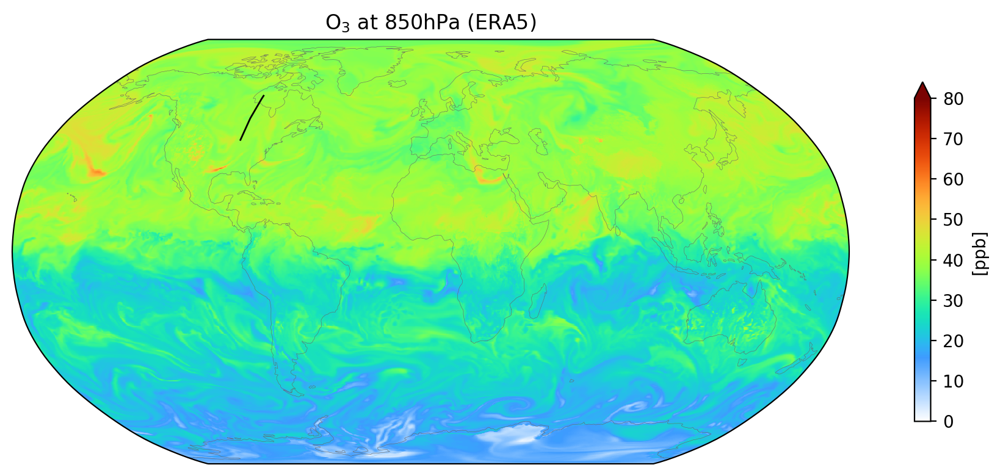

In [1273]:
ozplot = o3_lower_era5 * unitfac
projection = ccrs.PlateCarree(central_longitude=0)
cmap = 'white_to_turbo'


projection = ccrs.Robinson(central_longitude=0)
plt.figure(figsize=(11,4),dpi=200)
ax = plt.subplot(projection = projection)
ax.coastlines('110m',color='.4',linewidth=.2)
# ax.set_extent((-180,180,0,90), crs = ccrs.PlateCarree())
# pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=1.5e-7,cmap=cmap,cbar_kwargs={'shrink':.7,'label':'Mixing ratio [kg/kg]'})
pp = ozplot.plot.imshow(ax=ax,transform=ccrs.PlateCarree(),vmin=0,vmax=80,cmap=cmap,extend='max',cbar_kwargs={'shrink':.8,'label':'[ppb]'})
ozplot.isnull().where(ozplot.isnull()).plot.imshow(ax=ax,transform=ccrs.PlateCarree(),cmap='Greys',add_colorbar=False)
# .6e-7
# gl = ax.gridlines(draw_labels = True)
# gl.xlabels_top = False
# gl.ylabels_right = False
# gl.xlines = False
# gl.ylines = False

plt.plot([270, 270], [42.5, 60],
         color='0', linestyle='-',linewidth=1,
         transform=ccrs.PlateCarree(),
         )

plt.title(f'O$_{3}$ at 850hPa (ERA5)')

plt.tight_layout()


## Pattern corrs on CAMSRA grid

In [1274]:
weights = np.cos(np.deg2rad(camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest').lat))
_, weights = xr.broadcast(camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'), weights)
weights = weights.where(weights>0,0)


In [1275]:
descrips = ['CAMS_fold vs. CAMS_O3_250','CAMS_fold vs. CAMS_O3S_250','CAMS_fold vs. ERA5_O3_250','ERA5_fold vs. CAMS_O3_250','ERA5_fold vs. CAMS_O3S_250','ERA5_fold vs. ERA5_O3_250',
            'CAMS_fold vs. CAMS_O3_500','CAMS_fold vs. CAMS_O3S_500','CAMS_fold vs. ERA5_O3_500','ERA5_fold vs. CAMS_O3_500','ERA5_fold vs. CAMS_O3S_500','ERA5_fold vs. ERA5_O3_500',
            'CAMS_fold vs. CAMS_O3_850','CAMS_fold vs. CAMS_O3S_850','CAMS_fold vs. ERA5_O3_850','ERA5_fold vs. CAMS_O3_850','ERA5_fold vs. CAMS_O3S_850','ERA5_fold vs. ERA5_O3_850']
da1s = [camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),
        camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),
        camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),camplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),eraplot.interp(lat=camfold.lat,lon=camfold.lon,method='nearest')]
da2s = [o3_upper.isel(time=fig1time),o3s_upper.isel(time=fig1time),o3_upper_era5.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),o3_upper.isel(time=fig1time),o3s_upper.isel(time=fig1time),o3_upper_era5.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),
        o3_mid.isel(time=fig1time),o3s_mid.isel(time=fig1time),o3_mid_era5.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),o3_mid.isel(time=fig1time),o3s_mid.isel(time=fig1time),o3_mid_era5.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),
        o3_lower.isel(time=fig1time),o3s_lower.isel(time=fig1time),o3_lower_era5.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),o3_lower.isel(time=fig1time),o3s_lower.isel(time=fig1time),o3_lower_era5.interp(lat=camfold.lat,lon=camfold.lon,method='nearest'),]
rs = []
ps = []

for descrip,da1,da2 in zip(descrips[:],da1s[:],da2s[:]):
    print(descrip)
    r = xskillscore.pearson_r(da1, da2, dim=["lon", "lat"], skipna=True, weights=weights)
    p = xskillscore.pearson_r_p_value(da1, da2, dim=["lon", "lat"], skipna=True, weights=weights)
    rs.append(r.values)
    ps.append(p.values)
    print(f'r={np.round(r.values,3)}, p={np.round(p.values,3)}')


CAMS_fold vs. CAMS_O3_250
r=0.018, p=0.0
CAMS_fold vs. CAMS_O3S_250
r=0.012, p=0.0
CAMS_fold vs. ERA5_O3_250
r=0.015, p=0.0
ERA5_fold vs. CAMS_O3_250
r=0.058, p=0.0
ERA5_fold vs. CAMS_O3S_250
r=0.048, p=0.0
ERA5_fold vs. ERA5_O3_250
r=0.056, p=0.0
CAMS_fold vs. CAMS_O3_500
r=0.084, p=0.0
CAMS_fold vs. CAMS_O3S_500
r=0.121, p=0.0
CAMS_fold vs. ERA5_O3_500
r=0.084, p=0.0
ERA5_fold vs. CAMS_O3_500
r=0.112, p=0.0
ERA5_fold vs. CAMS_O3S_500
r=0.189, p=0.0
ERA5_fold vs. ERA5_O3_500
r=0.118, p=0.0
CAMS_fold vs. CAMS_O3_850
r=0.028, p=0.0
CAMS_fold vs. CAMS_O3S_850
r=0.026, p=0.0
CAMS_fold vs. ERA5_O3_850
r=0.032, p=0.0
ERA5_fold vs. CAMS_O3_850
r=0.031, p=0.0
ERA5_fold vs. CAMS_O3S_850
r=0.053, p=0.0
ERA5_fold vs. ERA5_O3_850
r=0.047, p=0.0


In [1278]:
# camr_250 = rs[:3]
# erar_250 = rs[3:6]
# camr_500 = rs[6:9]
# erar_500 = rs[9:12]
# camr_850 = rs[12:15]
# erar_850 = rs[15:18]
camr_250 = [rs[0],rs[2],rs[1]]
erar_250 = [rs[3],rs[5],rs[4]]
camr_500 = [rs[6],rs[8],rs[7]]
erar_500 = [rs[9],rs[11],rs[10]]
camr_850 = [rs[12],rs[14],rs[13]]
erar_850 = [rs[15],rs[17],rs[16]]
allcamrs = [camr_250,camr_500,camr_850]
allerars = [erar_250,erar_500,erar_850]


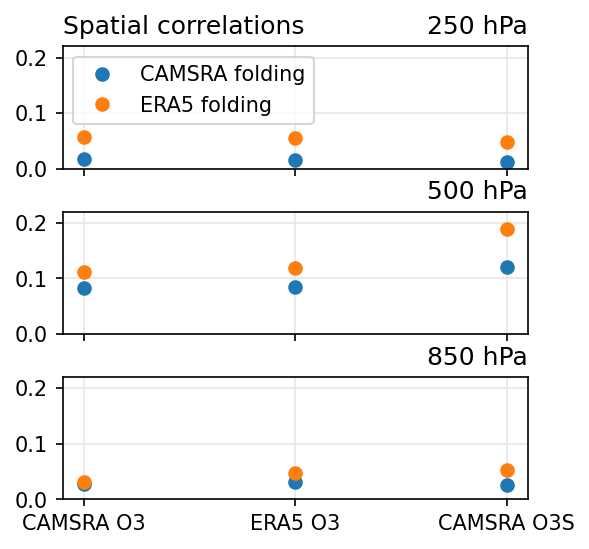

In [1279]:
titles = ['250 hPa','500 hPa','850 hPa']
# labels = ['CAMSRA O3','CAMSRA O3S','ERA5 O3']
labels = ['CAMSRA O3','ERA5 O3','CAMSRA O3S']

fig,axs = plt.subplots(3,1,figsize=(4,4),sharey=True,sharex=True,dpi=150,gridspec_kw={'hspace':0.35})
for ax,allcamr,allerar,title,label in zip(axs.flat,allcamrs,allerars,titles,labels):
    ax.grid(c='.9')
    ax.plot(np.arange(3),allcamr,'o',label='CAMSRA folding')
    ax.plot(np.arange(3),allerar,'o',label='ERA5 folding')
    ax.set_title(''); ax.set_title(title,loc='right')
axs[0].legend(loc='upper left')
axs[0].set_title('Spatial correlations',loc='left')
ax.set_ylim(0,.22)
ax.set_xticks(np.arange(3))
ax.set_xticklabels(labels)
ax.set_yticks([0,.1,.2])


# Vertical resolution comparison (Fig. 1b)

In [939]:
cammid = plev_CAMSRA_high
camres = np.diff(phalf_CAMSRA_high)
eramid = plev_ERA5_high
erares = np.diff(phalf_ERA5_high)

camres = xr.DataArray(coords={'plev':cammid},data=camres).astype('float32')
erares = xr.DataArray(coords={'plev':eramid},data=erares).astype('float32')


[Text(0, 100.0, ''),
 Text(0, 200.0, ''),
 Text(0, 300.0, ''),
 Text(0, 400.0, ''),
 Text(0, 500.0, ''),
 Text(0, 600.0, ''),
 Text(0, 700.0, ''),
 Text(0, 800.0, ''),
 Text(0, 900.0, '')]

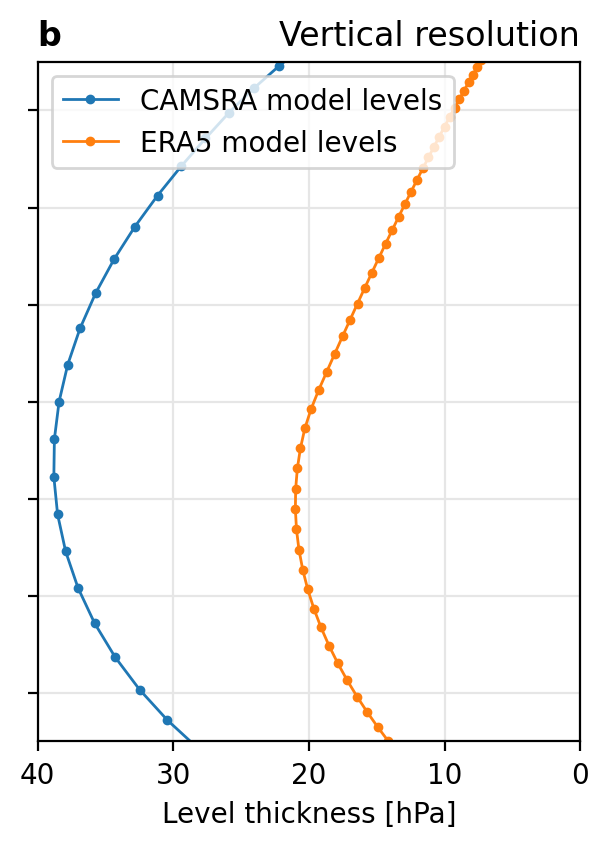

In [951]:
fig,ax = plt.subplots(figsize=(3.5,4.5),dpi=200)
ax.plot(camres,cammid,'.-',markersize=5,label='CAMSRA model levels',linewidth=1)
ax.plot(erares,eramid,'.-',markersize=5,label='ERA5 model levels',linewidth=1)
ax.invert_yaxis()
ax.invert_xaxis()
ax.grid(c='.9')
ax.legend(loc='upper left')
plt.title('Vertical resolution',loc='right')
plt.title('b',loc='left',fontweight='bold')
# plt.xlabel('Model level pressure difference [hPa]')
plt.xlabel('Level thickness [hPa]')
plt.ylabel('')
# plt.yscale('log')
plt.ylim(850,150)
plt.xlim(40,0)
ax.set_yticklabels([])

# plt.tight_layout()


# Fold frequency comparison (Fig. 2, S1, S4, S5, S7)

## Computations:

In [374]:
# camfold_global = camfold#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erafold_global = (erafold + camfold - camfold)#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erarelevelfold_global = erarelevelfold + camfold - camfold #.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# eraregridfold_global = eraregridfold
erarelevelregridfold_global = erarelevelregridfold

# camfoldtime = camfold_global.mean('time')
# erafoldtime = erafold_global.mean('time')
# erarelevelfoldtime = erarelevelfold_global.mean('time')
# eraregridfoldtime = eraregridfold_global.mean('time')
erarelevelregridfoldtime = erarelevelregridfold_global.mean('time')

with pbar:
    # camfoldtime = camfoldtime.compute()
    # erafoldtime = erafoldtime.compute()
    # erarelevelfoldtime = erarelevelfoldtime.compute()
    # eraregridfoldtime = eraregridfoldtime.compute()
    erarelevelregridfoldtime = erarelevelregridfoldtime.compute()
    


[########################################] | 100% Completed |  5.5s


In [375]:
# camfoldmd_global = (camfoldm + camfoldd)#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erafoldmd_global = (erafoldm + erafoldd + camfoldm + camfoldd - (camfoldm + camfoldd))#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erarelevelfoldmd_global = (erarelevelfoldm + erarelevelfoldd) + camfold - camfold#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# eraregridfoldmd_global = eraregridfoldm + eraregridfoldd
erarelevelregridfoldmd_global = erarelevelregridfoldm + erarelevelregridfoldd

# camfoldmdtime = camfoldmd_global.mean('time')
# erafoldmdtime = erafoldmd_global.mean('time')
# erarelevelfoldmdtime = erarelevelfoldmd_global.mean('time')
# eraregridfoldmdtime = eraregridfoldmd_global.mean('time')
erarelevelregridfoldmdtime = erarelevelregridfoldmd_global.mean('time')

with pbar:
    # camfoldmdtime = camfoldmdtime.compute()
    # erafoldmdtime = erafoldmdtime.compute()
    # erarelevelfoldmdtime = erarelevelfoldmdtime.compute()
    # eraregridfoldmdtime = eraregridfoldmdtime.compute()
    erarelevelregridfoldmdtime = erarelevelregridfoldmdtime.compute()
    

[########################################] | 100% Completed |  3.2s


In [376]:
# camfolds_global = (camfolds)#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erafolds_global = (erafolds + camfolds - camfolds)#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erarelevelfolds_global = (erarelevelfolds) + camfold - camfold#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# eraregridfolds_global = eraregridfolds
erarelevelregridfolds_global = erarelevelregridfolds

# camfoldstime = camfolds_global.mean('time')
# erafoldstime = erafolds_global.mean('time')
# erarelevelfoldstime = erarelevelfolds_global.mean('time')
# eraregridfoldstime = eraregridfolds_global.mean('time')
erarelevelregridfoldstime = erarelevelregridfolds_global.mean('time')

with pbar:
    # camfoldstime = camfoldstime.compute()
    # erafoldstime = erafoldstime.compute()
    # erarelevelfoldstime = erarelevelfoldstime.compute()
    # eraregridfoldstime = eraregridfoldstime.compute()
    erarelevelregridfoldstime = erarelevelregridfoldstime.compute()
    

[########################################] | 100% Completed |  2.2s


In [377]:
# camfoldm_global = (camfoldm)#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erafoldm_global = (erafoldm + camfoldm - camfoldm)#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erarelevelfoldm_global = (erarelevelfoldm) + camfold - camfold#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# eraregridfoldm_global = (eraregridfoldm)
erarelevelregridfoldm_global = (erarelevelregridfoldm)

# camfoldmtime = camfoldm_global.mean('time')
# erafoldmtime = erafoldm_global.mean('time')
# erarelevelfoldmtime = erarelevelfoldm_global.mean('time')
# eraregridfoldmtime = eraregridfoldm_global.mean('time')
erarelevelregridfoldmtime = erarelevelregridfoldm_global.mean('time')

with pbar:
    # camfoldmtime = camfoldmtime.compute()
    # erafoldmtime = erafoldmtime.compute()
    # erarelevelfoldmtime = erarelevelfoldmtime.compute()
    # eraregridfoldmtime = eraregridfoldmtime.compute()
    erarelevelregridfoldmtime = erarelevelregridfoldmtime.compute()
    

[########################################] | 100% Completed |  2.2s


In [378]:
# camfoldd_global = (camfoldd)#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erafoldd_global = (erafoldd + camfoldd - camfoldd)#.where((camfold.lat < 25) | (camfold.lat > 40) | (camfold.lon < 60) | (camfold.lon > 110))
# erarelevelfoldd_global = (erarelevelfoldd) + camfold - camfold
# eraregridfoldd_global = eraregridfoldd
erarelevelregridfoldd_global = erarelevelregridfoldd

# camfolddtime = camfoldd_global.mean('time')
# erafolddtime = erafoldd_global.mean('time')
# erarelevelfolddtime = erarelevelfoldd_global.mean('time')
# eraregridfolddtime = eraregridfoldd_global.mean('time')
erarelevelregridfolddtime = erarelevelregridfoldd_global.mean('time')

with pbar:
    # camfolddtime = camfolddtime.compute()
    # erafolddtime = erafolddtime.compute()
    # erarelevelfolddtime = erarelevelfolddtime.compute()
    # eraregridfolddtime = eraregridfolddtime.compute()
    erarelevelregridfolddtime = erarelevelregridfolddtime.compute()
    

[########################################] | 100% Completed |  2.2s


In [379]:
# Save above computations to file:   #CHECK PATHS

# camfoldtime.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/camfoldtime_presfix.nc')
# camfoldstime.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/camfoldstime_presfix.nc')
# camfoldmtime.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/camfoldmtime_presfix.nc')
# camfolddtime.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/camfolddtime_presfix.nc')

# erafoldtime.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/erafoldtime_presfix.nc')
# erafoldstime.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/erafoldstime_presfix.nc')
# erafoldmtime.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/erafoldmtime_presfix.nc')
# erafolddtime.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/erafolddtime_presfix.nc')

# erarelevelfoldtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/relevel/erarelevelfoldtime_presfix.nc')
# erarelevelfoldstime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/relevel/erarelevelfoldstime_presfix.nc')
# erarelevelfoldmtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/relevel/erarelevelfoldmtime_presfix.nc')
# erarelevelfolddtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/relevel/erarelevelfolddtime_presfix.nc')

# eraregridfoldtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/regrid/eraregridfoldtime_presfix.nc')
# eraregridfoldstime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/regrid/eraregridfoldstime_presfix.nc')
# eraregridfoldmtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/regrid/eraregridfoldmtime_presfix.nc')
# eraregridfolddtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/regrid/eraregridfolddtime_presfix.nc')

erarelevelregridfoldtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/erarelevelregridfoldtime_presfix.nc')
erarelevelregridfoldstime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/erarelevelregridfoldstime_presfix.nc')
erarelevelregridfoldmtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/erarelevelregridfoldmtime_presfix.nc')
erarelevelregridfolddtime.to_netcdf('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/erarelevelregridfolddtime_presfix.nc')


## Load from file:

In [380]:
# Load from file:  #CHECK PATHS

camfoldtime = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/camfoldtime_presfix.nc')*100
camfoldstime = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/camfoldstime_presfix.nc')*100
camfoldmtime = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/camfoldmtime_presfix.nc')*100
camfolddtime = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/camfolddtime_presfix.nc')*100

erafoldtime = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/erafoldtime_presfix.nc')*100
erafoldstime = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/erafoldstime_presfix.nc')*100
erafoldmtime = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/erafoldmtime_presfix.nc')*100
erafolddtime = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/erafolddtime_presfix.nc')*100

erarelevelfoldtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/relevel/erarelevelfoldtime_presfix.nc')*100
erarelevelfoldstime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/relevel/erarelevelfoldstime_presfix.nc')*100
erarelevelfoldmtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/relevel/erarelevelfoldmtime_presfix.nc')*100
erarelevelfolddtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/relevel/erarelevelfolddtime_presfix.nc')*100

eraregridfoldtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/regrid/eraregridfoldtime_presfix.nc')*100
eraregridfoldstime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/regrid/eraregridfoldstime_presfix.nc')*100
eraregridfoldmtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/regrid/eraregridfoldmtime_presfix.nc')*100
eraregridfolddtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/regrid/eraregridfolddtime_presfix.nc')*100

erarelevelregridfoldtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/erarelevelregridfoldtime_presfix.nc')*100
erarelevelregridfoldstime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/erarelevelregridfoldstime_presfix.nc')*100
erarelevelregridfoldmtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/erarelevelregridfoldmtime_presfix.nc')*100
erarelevelregridfolddtime = xr.open_dataarray('/dx15/samuelb/trop_folds/comboedit2/relevel_regrid/erarelevelregridfolddtime_presfix.nc')*100


In [1238]:
eraifolds_2012 = xr.open_dataset('/home/samuelb/mean_fold_shallow_from_January_2012_to_December_2012.nc')['fold-shallow.MEAN'].rename({'dimx_fold-shallow.ME':'lon','dimy_fold-shallow.ME':'lat'}).squeeze()
eraifolds_2012 = eraifolds_2012.assign_coords({'lat': eraifolds_2012.lat - 90})

eraifoldm_2012 = xr.open_dataset('/home/samuelb/mean_fold_medium_from_January_2012_to_December_2012.nc')['fold-medium.MEAN'].rename({'dimx_fold-medium.MEA':'lon','dimy_fold-medium.MEA':'lat'}).squeeze()
eraifoldm_2012 = eraifoldm_2012.assign_coords({'lat': eraifoldm_2012.lat - 90})

eraifoldd_2012 = xr.open_dataset('/home/samuelb/mean_fold_deep_from_January_2012_to_December_2012.nc')['fold-deep.MEAN'].rename({'dimx_fold-deep.MEAN':'lon','dimy_fold-deep.MEAN':'lat'}).squeeze()
eraifoldd_2012 = eraifoldd_2012.assign_coords({'lat': eraifoldd_2012.lat - 90})

eraifold_2012 = eraifolds_2012 + eraifoldm_2012 + eraifoldd_2012


In [1240]:
eraifolds = xr.open_dataset('/home/samuelb/mean_fold_shallow_from_January_1979_to_December_2014.nc')['fold-shallow.MEAN'].rename({'dimx_fold-shallow.ME':'lon','dimy_fold-shallow.ME':'lat'}).squeeze()
eraifolds = eraifolds.assign_coords({'lat': eraifolds.lat - 90})

eraifoldm = xr.open_dataset('/home/samuelb/mean_fold_medium_from_January_1979_to_December_2014.nc')['fold-medium.MEAN'].rename({'dimx_fold-medium.MEA':'lon','dimy_fold-medium.MEA':'lat'}).squeeze()
eraifoldm = eraifoldm.assign_coords({'lat': eraifoldm.lat - 90})

eraifoldd = xr.open_dataset('/home/samuelb/mean_fold_deep_from_January_1979_to_December_2014.nc')['fold-deep.MEAN'].rename({'dimx_fold-deep.MEAN':'lon','dimy_fold-deep.MEAN':'lat'}).squeeze()
eraifoldd = eraifoldd.assign_coords({'lat': eraifoldd.lat - 90})

eraifold = eraifolds + eraifoldm + eraifoldd


## Plotting:

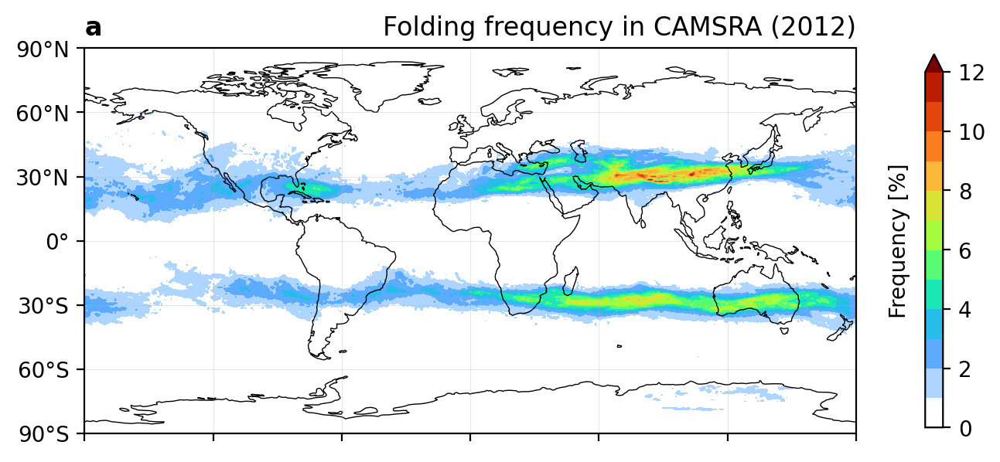

In [1311]:
# CAMSRA folding, timemean

dps = [camfoldtime]
pnum = len(dps)
titles = [f"Folding frequency in CAMSRA (2012)"]
vmaxes = [12]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
xticklabels = []#'180°', '120°W', '60°W', '0°', '60°E', '120°E', '180°']


plt.figure(figsize=(8.25*pnum,4),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(1,pnum,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    # cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(0,vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('white_to_turbo'), extend='both', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Frequency [%]'})    
    cc = cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(0,vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('white_to_turbo'), extend='max', add_colorbar=False)
    cb = plt.colorbar(cc,ax=ax,pad=.07,shrink=.8); cb.set_label('Frequency [%]',labelpad=-45)
    ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='right')
    ax.set_title('a',loc='left',fontweight='bold')    
    
# plt.tight_layout()
    

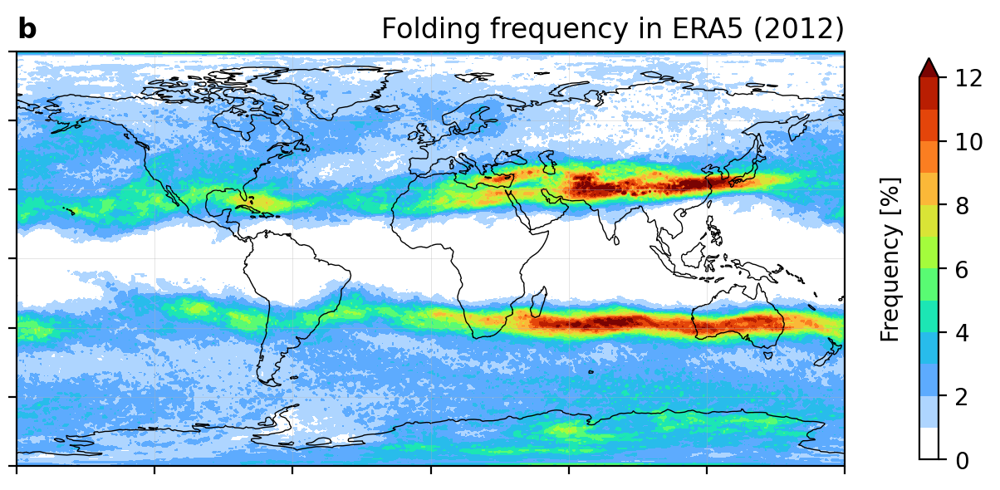

In [1310]:
# ERA5 folding, timemean

dps = [erafoldtime]
pnum = len(dps)
titles = [f"Folding frequency in ERA5 (2012)"]
vmaxes = [12]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
xticklabels = []#'180°', '120°W', '60°W', '0°', '60°E', '120°E', '180°']
yticklabels = []

plt.figure(figsize=(8.25*pnum,4),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(1,pnum,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    # cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(0,vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('white_to_turbo'), extend='both', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Frequency [%]'})
    cc = cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(0,vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('white_to_turbo'), extend='max', add_colorbar=False)
    cb = plt.colorbar(cc,ax=ax,pad=.07,shrink=.8); cb.set_label('Frequency [%]',labelpad=-45)
    ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_yticklabels(yticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='right')
    ax.set_title('b',loc='left',fontweight='bold')   
    
# plt.tight_layout()


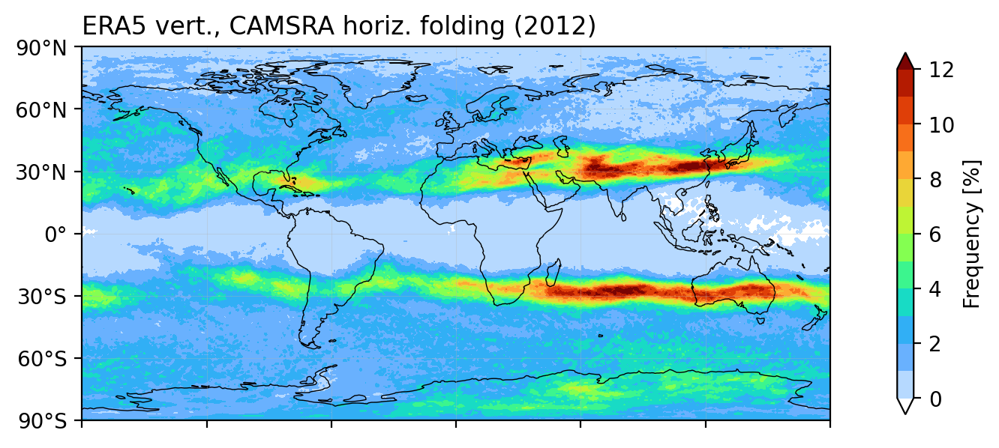

In [1285]:
# ERA5 regrid folding, timemean

dps = [eraregridfoldtime]
pnum = len(dps)
titles = [f"ERA5 vert., CAMSRA horiz. folding (2012)"]
vmaxes = [12]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
xticklabels = []#'180°', '120°W', '60°W', '0°', '60°E', '120°E', '180°']
yticklabels = []

plt.figure(figsize=(8.25*pnum,4),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(1,pnum,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(0,vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('white_to_turbo'), extend='both', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Frequency [%]'})
    ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    # ax.set_yticklabels(yticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='left')
    
# plt.tight_layout()


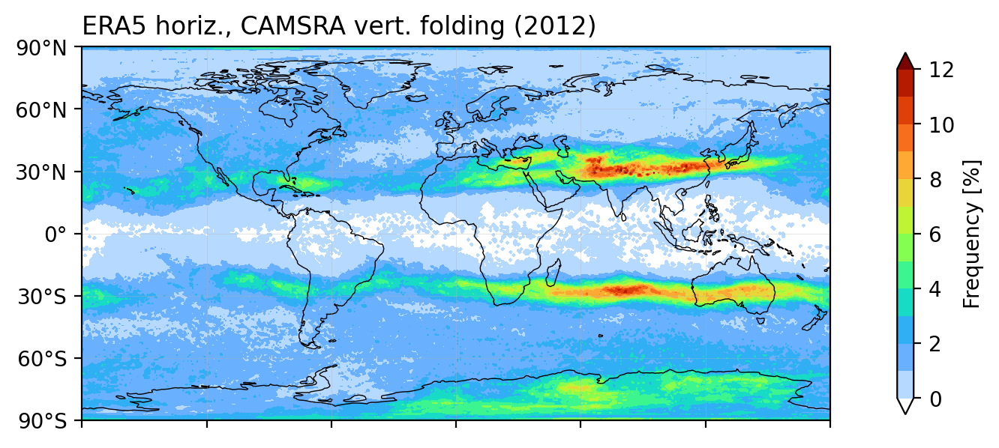

In [1286]:
# ERA5 relevel folding, timemean

dps = [erarelevelfoldtime]
pnum = len(dps)
titles = [f"ERA5 horiz., CAMSRA vert. folding (2012)"]
vmaxes = [12]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
xticklabels = []#'180°', '120°W', '60°W', '0°', '60°E', '120°E', '180°']
yticklabels = []

plt.figure(figsize=(8.25*pnum,4),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(1,pnum,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(0,vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('white_to_turbo'), extend='both', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Frequency [%]'})
    ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    # ax.set_yticklabels(yticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='left')
    
# plt.tight_layout()


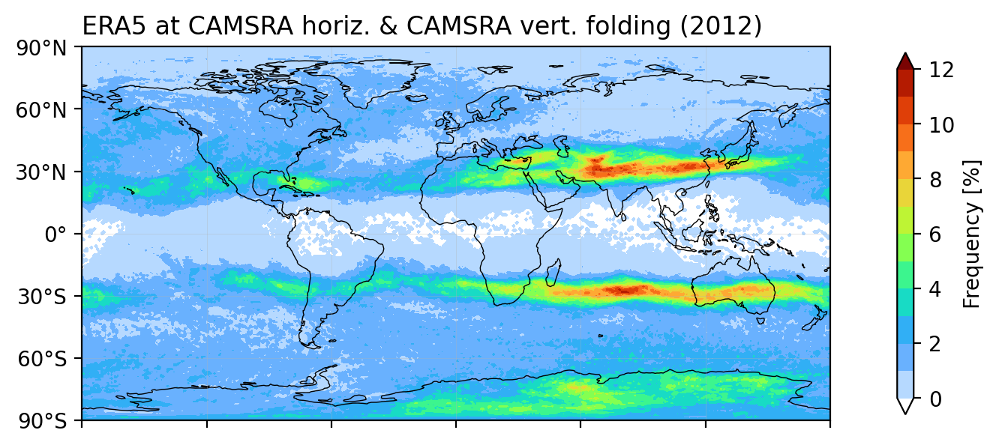

In [1287]:
# ERA5 relevel folding, timemean

dps = [erarelevelregridfoldtime]
pnum = len(dps)
titles = [f"ERA5 at CAMSRA horiz. & CAMSRA vert. folding (2012)"]
vmaxes = [12]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
xticklabels = []#'180°', '120°W', '60°W', '0°', '60°E', '120°E', '180°']
yticklabels = []

plt.figure(figsize=(8.25*pnum,4),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(1,pnum,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(0,vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('white_to_turbo'), extend='both', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Frequency [%]'})
    ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    # ax.set_yticklabels(yticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='left')
    
# plt.tight_layout()


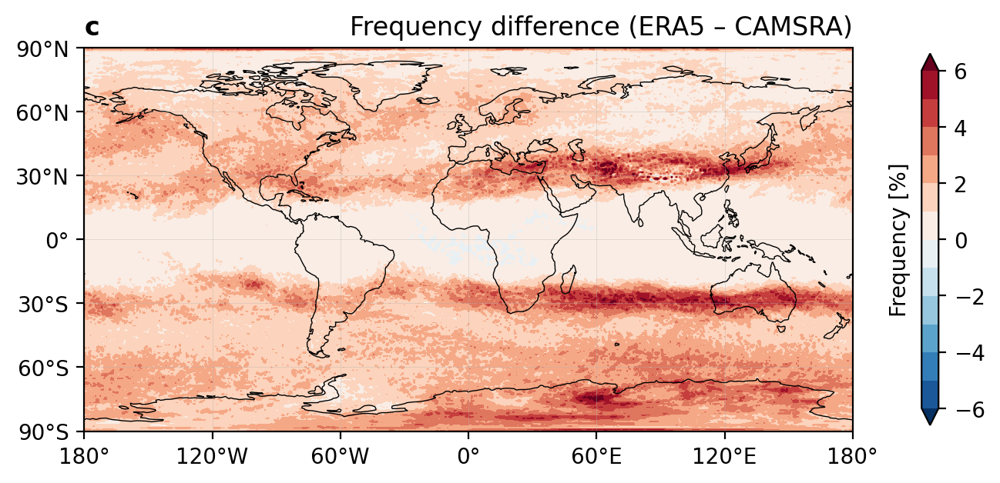

In [1013]:
# CAMSRA vs ERA5 folding, timemean

dps = [erafoldtime - camfoldtime]
pnum = len(dps)
titles = [f"Frequency difference (ERA5 – CAMSRA)"]
# vmaxes = [.06]
vmaxes = [6]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
xticklabels = ['180°', '120°W', '60°W', '0°', '60°E', '120°E', '180°']


plt.figure(figsize=(8.25*pnum,4),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(1,pnum,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    # cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(-vmaxes[pp],vmaxes[pp]+.01,.01), extend='both', ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('RdBu_r'), cbar_kwargs={'pad':.07,'shrink':.8,'label':'ERA5 – CAMSRA'})
    # cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(-vmaxes[pp],vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('RdBu_r'), extend='both', cbar_kwargs={'pad':.07,'shrink':.8,'label':'ERA5 – CAMSRA [%]'})
    cc = cyclic_dataarray(dp,'lon').plot.contourf(levels = np.arange(-vmaxes[pp],vmaxes[pp]+1,1), ax=ax, transform=ccrs.PlateCarree(), cmap = cm.get_cmap('RdBu_r'), extend='both', add_colorbar=False)
    cb = plt.colorbar(cc,ax=ax,pad=.07,shrink=.8); cb.set_label('Frequency [%]',labelpad=-45)
    ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='right')
    ax.set_title('c',loc='left',fontweight='bold')
    
# plt.tight_layout()
    

/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/cartopy/mpl/geoaxes.py:1714: UserWarning: Log scale: values of z <= 0 have been masked
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)


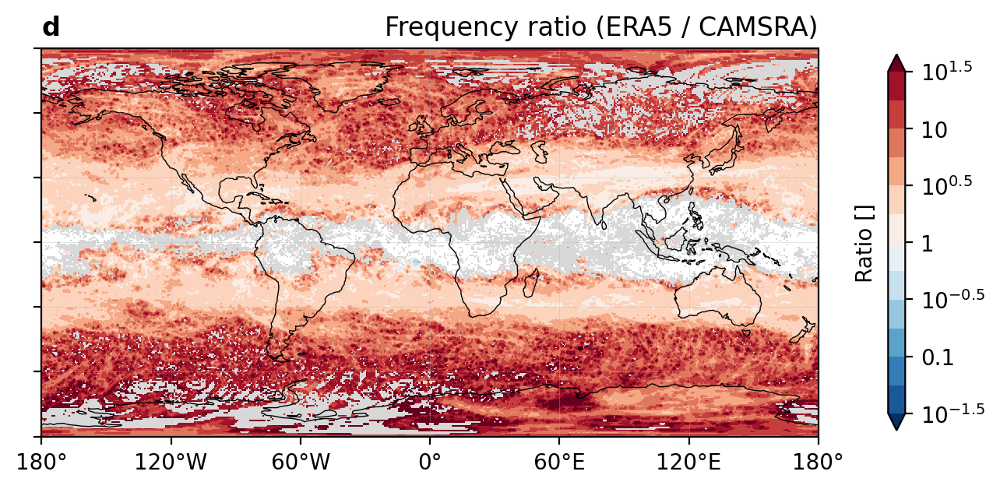

In [1015]:
# CAMSRA vs ERA5 folding, timemean

dps = [erafoldtime / camfoldtime]
pnum = len(dps)
titles = [f"Frequency ratio (ERA5 / CAMSRA)"]
vmaxes = [10**(1.5)]
vmins = [10**(-1.5)]
cmap1 = copy.copy(plt.cm.RdBu_r)
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
xticklabels = ['180°', '120°W', '60°W', '0°', '60°E', '120°E', '180°']
yticklabels = []

plt.figure(figsize=(8.25*pnum,4),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(1,pnum,pp+1,projection = ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    p0 = dp.plot.imshow(ax=ax,transform=ccrs.PlateCarree(), vmax=vmaxes[pp], vmin=vmins[pp], cmap = 'RdBu_r', norm=colors.LogNorm(), add_colorbar=False)
    p1 = cyclic_dataarray(dp,'lon').plot.contourf(levels=np.power(10, np.arange(-1.5,1.6,.25)), ax=ax,transform=ccrs.PlateCarree(), vmax=vmaxes[pp], vmin=vmins[pp], cmap = 'RdBu_r', norm=colors.LogNorm(), add_colorbar=False)#cbar_kwargs={'pad':.07,'shrink':.7,'label':'ERA5 / ERA-I','ticks':[10**-1.5,10**-1,10**-.5,10**0,10**.5,10**1,10**1.5],'minor':False})#[10**-1.5,10**-1,10**-.5,10**0,10**.5,10**1,10**1.5]})
    p2 = dp.where(dp != np.inf, 1000).where(dp.where(dp != np.inf, 1000)==1000).plot.imshow(ax=ax,transform=ccrs.PlateCarree(), vmax=vmaxes[pp], vmin=vmins[pp], cmap = cmap1, norm=colors.LogNorm(), add_colorbar=False)
    ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_yticklabels(yticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='right')
    ax.set_title('d',loc='left',fontweight='bold')
    
# cb = plt.colorbar(p1, pad=.07, shrink=.8, label='ERA5 / CAMSRA []')
cb = plt.colorbar(p1, pad=.07, shrink=.8); cb.set_label('Ratio []',labelpad=-60)
cb.set_ticks([10**-1.5,10**-1,10**-.5,10**0,10**.5,10**1,10**1.5])
cb.set_ticklabels(['10$^{-1.5}$','0.1','10$^{-0.5}$','1','10$^{0.5}$','10','10$^{1.5}$'])
# cb.set_ticklabels(['1/32','1/10','1/3.2','1','3.2','10','32'])
# cb.set_ticklabels(['10$^{-1.5}$','10$^{-1}$','10$^{-.5}$','1','10$^{.5}$','10$^{1}$','10$^{1.5}$'])
cb.ax.minorticks_off()
p2.cmap.set_over('.85')

# plt.tight_layout()
    

/tmp/ipykernel_2900/141309179.py:30: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


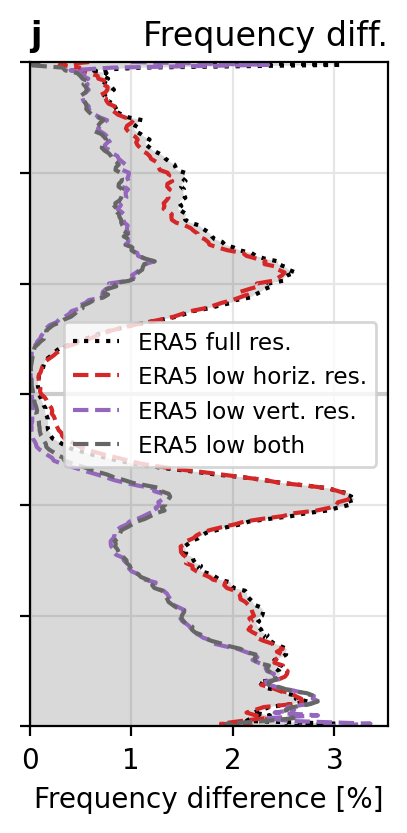

In [1328]:
nrows = 1
ncols = 1

foldsets = [[erafoldtime - camfoldtime, eraregridfoldtime - camfoldtime, erarelevelfoldtime - camfoldtime, erarelevelregridfoldtime - camfoldtime]]
titles = ['Frequency diff.']

fig,ax = plt.subplots(nrows,ncols,figsize=(2.1*1.1*ncols,4*1.1*nrows),sharey='all',dpi=200, gridspec_kw={'wspace':.15})

for cc in range(ncols):

    ax.axhline(0,color='.8')
    ax.grid(c='.9')
    ax.axvline(0,c='.8')
    foldsets[cc][0].mean('lon').plot(ax=ax,y='lat',c='0',ls=':',label='ERA5 full res.')
    foldsets[cc][1].mean('lon').plot(ax=ax,y='lat',label='ERA5 low horiz. res.',ls='--',color='tab:red')
    foldsets[cc][2].mean('lon').plot(ax=ax,y='lat',label='ERA5 low vert. res.',ls='--',color='tab:purple')
    foldsets[cc][3].mean('lon').plot(ax=ax,y='lat',label='ERA5 low both',ls='--',color='0.4')    
    ax.fill_betweenx(foldsets[cc][0].mean('lon').lat, foldsets[cc][0].mean('lon'), facecolor='0',alpha=.15,edgecolor='none', zorder=2)
    
    ax.set_ylim(-90,90)
    ax.set_ylabel('')
    ax.set_xlabel('Frequency difference [%]')
    ax.set_title(titles[cc],loc='right')
    ax.set_title('j',loc='left',fontweight='bold')
    ax.set_xlim(0)

plt.yticks([-90,-60,-30,0,30,60,90],labels=[])
ax.legend(loc='center right',fontsize='small',frameon=True) 

plt.tight_layout()


In [1280]:
missedmap = ((erafoldstime - camfoldstime)/erafoldstime*100).where((erafoldstime - camfoldstime) > 0, other=0)
missedmap2 = ((erafoldstime - camfoldstime)/camfoldstime*100).where((erafoldstime - camfoldstime) < 0, other=0)
mergedmap = missedmap + missedmap2
mergedmaps = mergedmap.where(mergedmap != 0)

missedmap = ((erafoldmtime - camfoldmtime)/erafoldmtime*100).where((erafoldmtime - camfoldmtime) > 0, other=0)
missedmap2 = ((erafoldmtime - camfoldmtime)/camfoldmtime*100).where((erafoldmtime - camfoldmtime) < 0, other=0)
mergedmap = missedmap + missedmap2
mergedmapm = mergedmap.where(mergedmap != 0)

missedmap = ((erafolddtime - camfolddtime)/erafolddtime*100).where((erafolddtime - camfolddtime) > 0, other=0)
missedmap2 = ((erafolddtime - camfolddtime)/camfolddtime*100).where((erafolddtime - camfolddtime) < 0, other=0)
mergedmap = missedmap + missedmap2
mergedmapd = mergedmap.where(mergedmap != 0)

missedmap = ((erafoldtime - camfoldtime)/erafoldtime*100).where((erafoldtime - camfoldtime) > 0, other=0)
missedmap2 = ((erafoldtime - camfoldtime)/camfoldtime*100).where((erafoldtime - camfoldtime) < 0, other=0)
mergedmap = missedmap + missedmap2
mergedmap = mergedmap.where(mergedmap != 0)


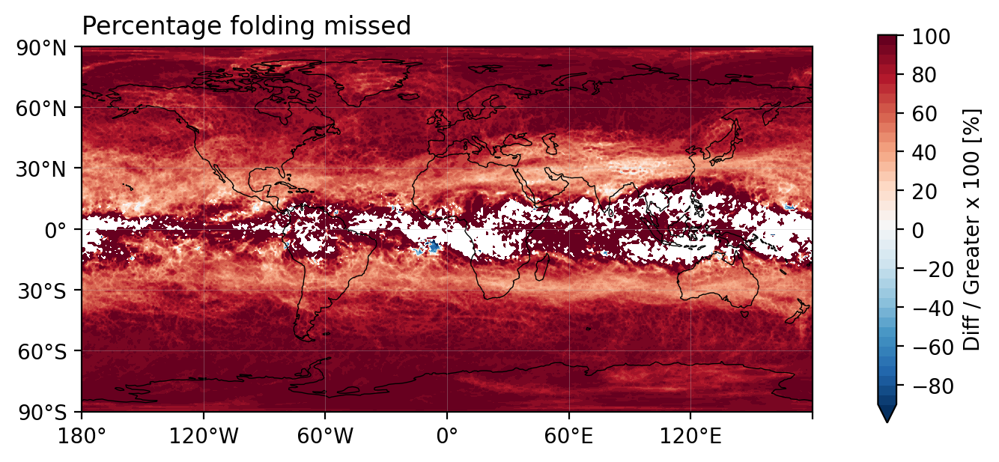

In [1281]:
# CAMSRA vs ERA5 folding, timemean

# dps = [(erafoldtime - camfoldtime)/erafoldtime*100]
dps = [mergedmap]
pnum = len(dps)
titles = [f"Percentage folding missed"]
vmaxes = [100]
vmins = [-90]
interval = [5]

plt.figure(figsize=(7*pnum,4),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(1,pnum,pp+1,projection = ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    cyclic_dataarray(dp,'lon').plot.contourf(levels=np.arange(vmins[pp],vmaxes[pp]+interval[pp],interval[pp]), ax=ax,transform=ccrs.PlateCarree(), vmax=vmaxes[pp], vmin=vmins[pp], cmap = 'RdBu_r', cbar_kwargs={'pad':.07,'shrink':.7,'label':'Diff / Greater x 100 [%]'})    
    ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='left')
    
plt.tight_layout()


Text(0.0, 1.0, 'Histogram (S+M+D) and pointwise statistics')

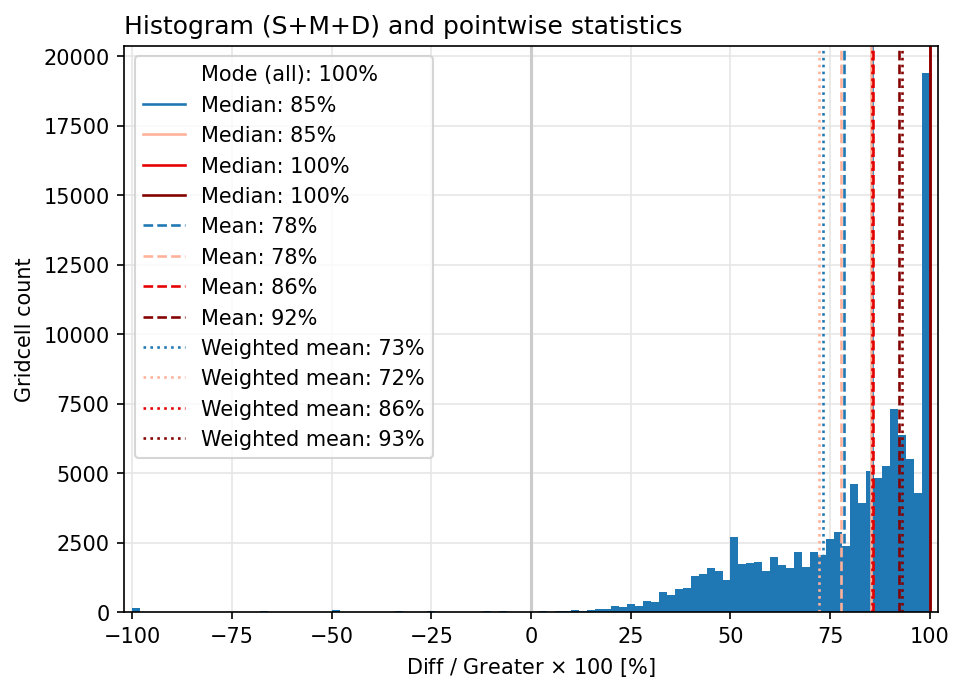

In [1282]:
weights = np.cos(np.deg2rad(camfoldtime.lat))
weights.name = "weights"

fig = plt.figure(dpi=150,figsize=(7,5))
plt.grid(c='.9',zorder=1)
plt.axvline(0,c='.8')
mergedmap.plot.hist(bins=np.arange(-100,102,2),zorder=2,density=False)
# mergedmaps.plot.hist(bins=np.arange(-100,102,2),zorder=2,density=False,color='xkcd:pale salmon',histtype='step')
# mergedmapm.plot.hist(bins=np.arange(-100,102,2),zorder=2,density=False,color='xkcd:red',histtype='step')
# mergedmapd.plot.hist(bins=np.arange(-100,102,2),zorder=2,density=False,color='xkcd:dark red',histtype='step')

plt.plot([],[],ls='none',label='Mode (all): 100%')

plt.axvline(mergedmap.median(),lw=1.25,label=f'Median: {int(np.round(mergedmap.median().values))}%')
plt.axvline(mergedmaps.median(),lw=1.25,label=f'Median: {int(np.round(mergedmaps.median().values))}%',color='xkcd:pale salmon')
plt.axvline(mergedmapm.median(),lw=1.25,label=f'Median: {int(np.round(mergedmapm.median().values))}%',color='xkcd:red')
plt.axvline(mergedmapd.median(),lw=1.25,label=f'Median: {int(np.round(mergedmapd.median().values))}%',color='xkcd:dark red')

plt.axvline(mergedmap.mean(),ls='--',lw=1.25,label=f'Mean: {int(np.round(mergedmap.mean().values))}%')
plt.axvline(mergedmaps.mean(),ls='--',lw=1.25,label=f'Mean: {int(np.round(mergedmaps.mean().values))}%',color='xkcd:pale salmon')
plt.axvline(mergedmapm.mean(),ls='--',lw=1.25,label=f'Mean: {int(np.round(mergedmapm.mean().values))}%',color='xkcd:red')
plt.axvline(mergedmapd.mean(),ls='--',lw=1.25,label=f'Mean: {int(np.round(mergedmapd.mean().values))}%',color='xkcd:dark red')

plt.axvline(mergedmap.weighted(weights).mean(),ls=':',lw=1.25,label=f'Weighted mean: {int(np.round(mergedmap.weighted(weights).mean().values))}%')
plt.axvline(mergedmaps.weighted(weights).mean(),ls=':',lw=1.25,label=f'Weighted mean: {int(np.round(mergedmaps.weighted(weights).mean().values))}%',color='xkcd:pale salmon')
plt.axvline(mergedmapm.weighted(weights).mean(),ls=':',lw=1.25,label=f'Weighted mean: {int(np.round(mergedmapm.weighted(weights).mean().values))}%',color='xkcd:red')
plt.axvline(mergedmapd.weighted(weights).mean(),ls=':',lw=1.25,label=f'Weighted mean: {int(np.round(mergedmapd.weighted(weights).mean().values))}%',color='xkcd:dark red')

plt.legend(loc='upper left')
plt.xlim(-102,102)
plt.ylabel('Gridcell count')
plt.xlabel(r'Diff / Greater $\times$ 100 [%]')
plt.title('')
plt.title('Histogram (S+M+D) and pointwise statistics',loc='left')


In [1283]:
# Aggregated stats:

weights = np.cos(np.deg2rad(camfoldtime.lat))
weights.name = "weights"

camtotal = (camfoldtime*len(erafold.time)).weighted(weights).sum()
eratotal = (erafoldtime*len(erafold.time)).weighted(weights).sum()

camstotal = (camfoldstime*len(erafold.time)).weighted(weights).sum()
erastotal = (erafoldstime*len(erafold.time)).weighted(weights).sum()
cammtotal = (camfoldmtime*len(erafold.time)).weighted(weights).sum()
eramtotal = (erafoldmtime*len(erafold.time)).weighted(weights).sum()
camdtotal = (camfolddtime*len(erafold.time)).weighted(weights).sum()
eradtotal = (erafolddtime*len(erafold.time)).weighted(weights).sum()


In [1284]:
# Missed stats:

print('Missed:')
print(f'S+M+D: {np.round(((eratotal - camtotal)/eratotal*100).values,1)}%')
print(f'Shallow: {np.round(((erastotal - camstotal)/erastotal*100).values,1)}%')
print(f'Medium: {np.round(((eramtotal - cammtotal)/eramtotal*100).values,1)}%')
print(f'Deep: {np.round(((eradtotal - camdtotal)/eradtotal*100).values,1)}%')


Missed:
S+M+D: 63.4%
Shallow: 61.1%
Medium: 82.5%
Deep: 91.5%


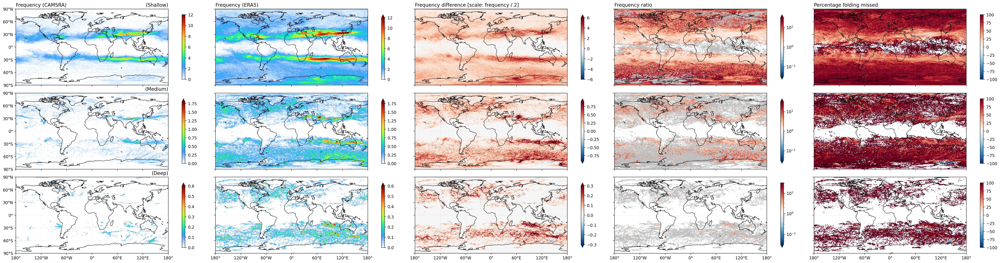

In [1290]:
# 12 plots for shallow/medium/deep CAMSRA/ERA5/Diff/Rel-Diff

dps = [camfoldstime, erafoldstime, erafoldstime-camfoldstime, erafoldstime/camfoldstime, mergedmaps,
       camfoldmtime, erafoldmtime, erafoldmtime-camfoldmtime, erafoldmtime/camfoldmtime, mergedmapm,
       camfolddtime, erafolddtime, erafolddtime-camfolddtime, erafolddtime/camfolddtime, mergedmapd]
nrows = 3
ncols = 5
cmaps = ['white_to_turbo', 'white_to_turbo', 'RdBu_r', 'RdBu_r', 'RdBu_r',
         'white_to_turbo', 'white_to_turbo', 'RdBu_r', 'RdBu_r', 'RdBu_r',
         'white_to_turbo', 'white_to_turbo', 'RdBu_r', 'RdBu_r', 'RdBu_r']
cmap1 = copy.copy(plt.cm.RdBu_r)
freqmaxes = [n*100 for n in [.08*1.5, .012*1.5, .004*1.5]]
vmaxes = [freqmaxes[0], freqmaxes[0], freqmaxes[0]/2, 10**(1.5), 100,
          freqmaxes[1], freqmaxes[1], freqmaxes[1]/2, 10**(1.5), 100,
          freqmaxes[2], freqmaxes[2], freqmaxes[2]/2, 10**(1.5), 100]
vmins = [0, 0, -freqmaxes[0]/2, 10**(-1.5), -100,
         0, 0, -freqmaxes[1]/2, 10**(-1.5), -100,
         0, 0, -freqmaxes[2]/2, 10**(-1.5), -100]
norms = [colors.Normalize(), colors.Normalize(), colors.Normalize(), colors.LogNorm(), colors.Normalize(),
         colors.Normalize(), colors.Normalize(), colors.Normalize(), colors.LogNorm(), colors.Normalize(),
         colors.Normalize(), colors.Normalize(), colors.Normalize(), colors.LogNorm(), colors.Normalize()]
titles = ['Frequency (CAMSRA)', 'Frequency (ERA5)', 'Frequency difference [scale: frequency / 2]', 'Frequency ratio', 'Percentage folding missed']
titles2 = ['(Shallow)','','','','',
           '(Medium)','','','','',
           '(Deep)','','','','',]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
xticklabels = ['180°', '120°W', '60°W', '0°', '60°E', '120°E', '180°']

plt.figure(figsize=(7*ncols,3*nrows),dpi=200)

for index,dp in enumerate(dps):
    
    ax = plt.subplot(nrows,ncols,index+1,projection = ccrs.PlateCarree(central_longitude=0))
    dp.plot.imshow(ax = ax, transform=ccrs.PlateCarree(), 
                   cmap = cmaps[index],
                   vmax = vmaxes[index],
                   vmin = vmins[index],
                   norm = norms[index],
                   cbar_kwargs={'pad':.07,'shrink':.85,'label':''})
    if index in [3,8,13]:
        p2 = dp.where(dp != np.inf, 1000).where(dp.where(dp != np.inf, 1000)==1000).plot.imshow(ax=ax,transform=ccrs.PlateCarree(), vmax=vmaxes[index], vmin=vmins[index], cmap = cmap1, norm=colors.LogNorm(), add_colorbar=False)
        p2.cmap.set_over('.75')
    ax.coastlines('110m',color='0',linewidth=.75)
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    if index in [0,5,10]:
        ax.set_title(titles2[index],loc='right')
    else:
        ax.set_yticklabels([])
    if index < 5:
        ax.set_title(titles[index],loc='left')
    if index < 10:
        ax.set_xticklabels([])

plt.tight_layout()


/tmp/ipykernel_2900/3245953682.py:37: UserWarning: The handle <matplotlib.lines.Line2D object at 0x7f6d1520b280> has a label of '_line0' which cannot be automatically added to the legend.
  legend1 = axs[0].legend(lines[:5],[line.get_label() for line in lines[:5]],loc='upper right',fontsize='small')#,frameon=False)
/tmp/ipykernel_2900/3245953682.py:37: UserWarning: The handle <matplotlib.lines.Line2D object at 0x7f6d14f8ac10> has a label of '_line1' which cannot be automatically added to the legend.
  legend1 = axs[0].legend(lines[:5],[line.get_label() for line in lines[:5]],loc='upper right',fontsize='small')#,frameon=False)
/tmp/ipykernel_2900/3245953682.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


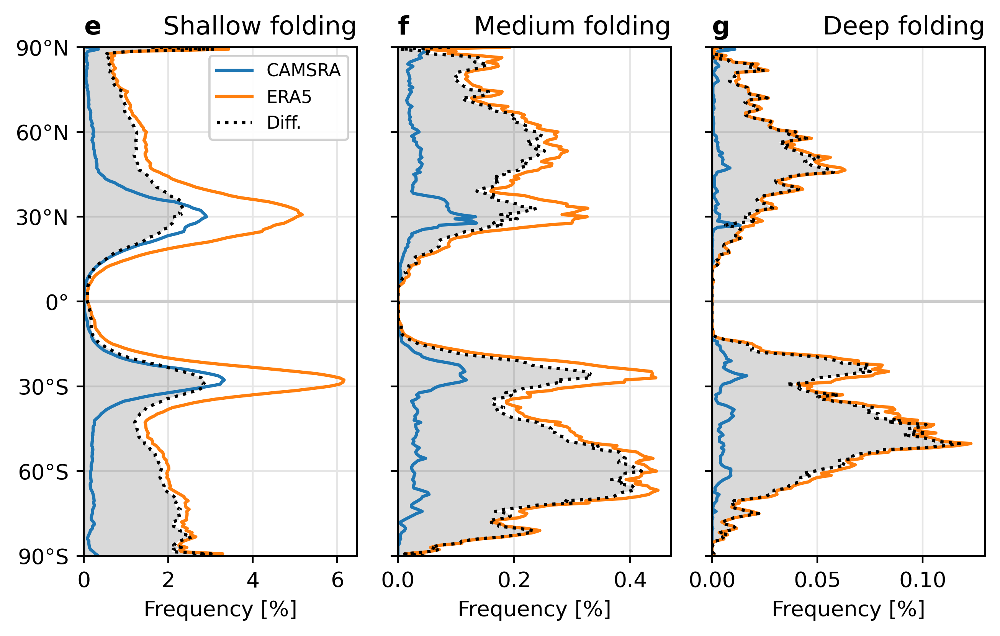

In [1064]:
nrows = 1
ncols = 3

foldsets = [[camfoldstime, erafoldstime],
            [camfoldmtime, erafoldmtime],
            [camfolddtime, erafolddtime]]
# foldsets = [[camfoldstime, erafoldstime, eraregridfoldstime, erarelevelfoldstime],
#             [camfoldmtime, erafoldmtime, eraregridfoldmtime, erarelevelfoldmtime],
#             [camfolddtime, erafolddtime, eraregridfolddtime, erarelevelfolddtime]]
titles = ['Shallow folding', 'Medium folding', 'Deep folding']

fig,axs = plt.subplots(nrows,ncols,figsize=(2.3*1.1*ncols,4*1.1*nrows),sharey='all',dpi=400, gridspec_kw={'wspace':.15})

for cc in range(ncols):

    ax = axs[cc]
    ax.axhline(0,color='.8')
    ax.grid(c='.9')
    ax.axvline(0,c='.8')
    foldsets[cc][0].mean('lon').plot(ax=ax,y='lat',label='CAMSRA')
    foldsets[cc][1].mean('lon').plot(ax=ax,y='lat',label='ERA5')
    (foldsets[cc][1] - foldsets[cc][0]).mean('lon').plot(ax=axs[cc],y='lat',c='0',ls=':',label='Diff.')
    # foldsets[cc][2].mean('lon').plot(ax=ax,y='lat',label='ERA5 vert.,\nCAMSRA horiz.',ls='--',color='tab:red')
    # foldsets[cc][3].mean('lon').plot(ax=ax,y='lat',label='ERA5 horiz.,\nCAMSRA vert.',ls='--',color='0.4')    
    ax.fill_betweenx((foldsets[cc][1] - foldsets[cc][0]).mean('lon').lat, (foldsets[cc][1] - foldsets[cc][0]).mean('lon'), facecolor='0',alpha=.15,edgecolor='none', zorder=2)
    
    ax.set_ylim(-90,90)
    ax.set_ylabel('')
    ax.set_xlabel('Frequency [%]')
    ax.set_title(titles[cc],loc='right')
    ax.set_title(['e','f','g'][cc],loc='left',fontweight='bold')
    ax.set_xlim(0)
    ax.set_yticks([-90,-60,-30,0,30,60,90])

axs[0].yaxis.set_major_formatter(LATITUDE_FORMATTER)
lines = axs[0].get_lines()
legend1 = axs[0].legend(lines[:5],[line.get_label() for line in lines[:5]],loc='upper right',fontsize='small')#,frameon=False) 
# legend2 = axs[0].legend(lines[-2:],[line.get_label() for line in lines[-2:]],loc='center right',fontsize='small')#,frameon=False) 
axs[0].add_artist(legend1)
# axs[0].add_artist(legend2)
# axs[0].legend([p1,p2,p3],loc='upper right',fontsize='small',frameon=False) 
# axs[0].legend(['CAMSRA'],loc='upper right',fontsize='small',frameon=False) 
# axs[0].legend([p4,p5],loc='lower right',fontsize='small',frameon=False) 
# axs[0].set_ylabel('Latitude [°N]')

plt.tight_layout()


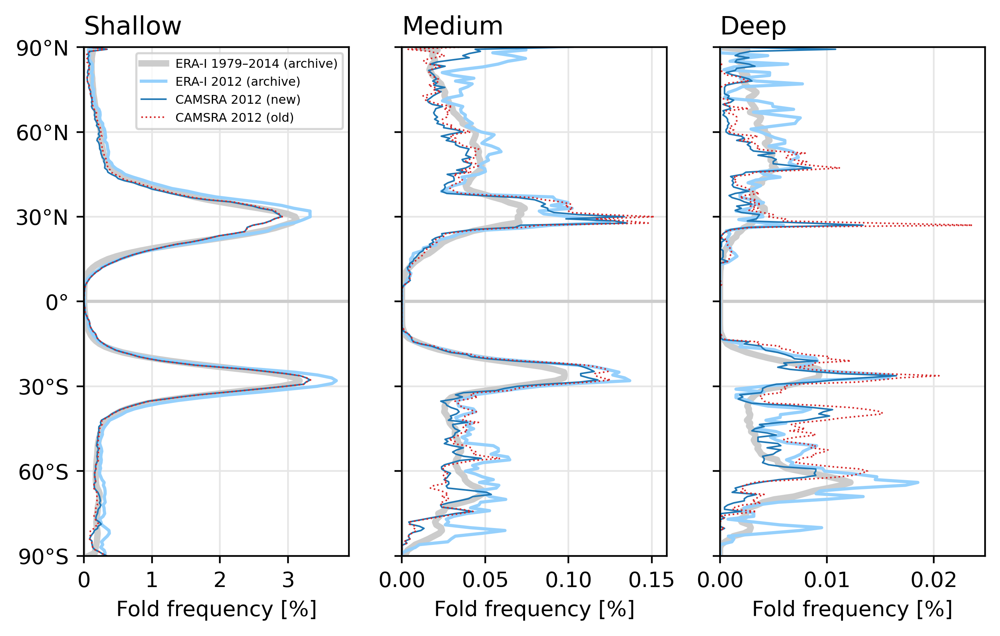

In [1306]:
nrows = 1
ncols = 3

foldsets = [[camfoldstime, camfoldstime_old*100, erafoldstime*100, eraifolds_2012*100, eraifolds*100],
            [camfoldmtime, camfoldmtime_old*100, erafoldmtime*100, eraifoldm_2012*100, eraifoldm*100],
            [camfolddtime, camfolddtime_old*100, erafolddtime*100, eraifoldd_2012*100, eraifoldd*100]]
titles = ['Shallow', 'Medium', 'Deep']

fig,axs = plt.subplots(nrows,ncols,figsize=(2.3*1.1*ncols,4*1.1*nrows),sharey='all',dpi=400)

for cc in range(ncols):

    ax = axs[cc]
    ax.axhline(0,color='.8')
    ax.axvline(0,c='.8')
    ax.grid(c='.9')
    foldsets[cc][4].mean('lon').plot(ax=ax,y='lat',label='ERA-I 1979–2014 (archive)',color='.8',lw=3)
    foldsets[cc][3].mean('lon').plot(ax=ax,y='lat',label='ERA-I 2012 (archive)',color='xkcd:light blue',ls='-',lw=1.5)
    foldsets[cc][0].mean('lon').plot(ax=ax,y='lat',label='CAMSRA 2012 (new)',lw=.75)
    foldsets[cc][1].mean('lon').plot(ax=ax,y='lat',label='CAMSRA 2012 (old)',color='tab:red',ls=':',lw=.75)
#     foldsets[cc][2].mean('lon').plot(ax=ax,y='lat',label='ERA5 2012 (new)',color='tab:orange',ls='-',lw=.75)
    
    ax.set_ylim(-90,90)
    ax.set_ylabel('')
    ax.set_xlabel('Fold frequency [%]')
    ax.set_title(titles[cc],loc='left')
    ax.set_xlim(0)
    ax.set_yticks([-90,-60,-30,0,30,60,90])

axs[0].yaxis.set_major_formatter(LATITUDE_FORMATTER)
axs[0].legend(fontsize=5.75,loc='upper right') 
# axs[0].set_ylabel('Latitude [°N]')

# plt.tight_layout()


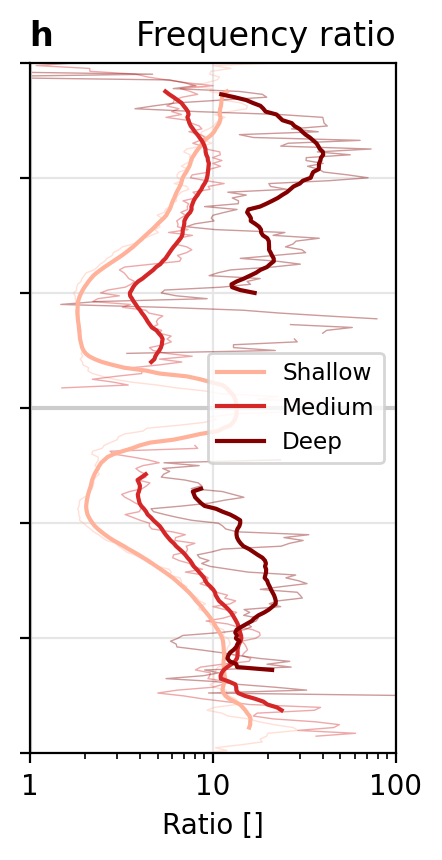

In [1067]:
# plt.figure(figsize=(3.25*1.1,4*1.1),dpi=200)
plt.figure(figsize=(2.1*1.1,4*1.1),dpi=200)
plt.axhline(0,color='.8')
plt.axvline(0,c='.8')
plt.grid(c='.9')

(erafoldstime.mean('lon') / camfoldstime.mean('lon')).plot(y='lat',color='xkcd:pale salmon',alpha=.4,lw=.5)
(erafoldmtime.mean('lon') / camfoldmtime.mean('lon')).plot(y='lat',color='tab:red',alpha=.4,lw=.5)
(erafolddtime.mean('lon') / camfolddtime.mean('lon')).plot(y='lat',color='xkcd:dark red',alpha=.4,lw=.5)

(erafoldstime.mean('lon') / camfoldstime.mean('lon')).where(erafoldstime.mean('lon') / camfoldstime.mean('lon') != np.inf, np.nan).rolling(lat=20, center=True).mean().plot(y='lat',color='xkcd:pale salmon',label='Shallow')
(erafoldmtime.mean('lon') / camfoldmtime.mean('lon')).where(erafoldmtime.mean('lon') / camfoldmtime.mean('lon') != np.inf, np.nan).rolling(lat=20, center=True).mean().plot(y='lat',color='tab:red',label='Medium')
(erafolddtime.mean('lon') / camfolddtime.mean('lon')).where(erafolddtime.mean('lon') / camfolddtime.mean('lon') != np.inf, np.nan).rolling(lat=20, center=True).mean().plot(y='lat',color='xkcd:dark red',label='Deep')

plt.ylim(-90,90)
# plt.xlim(10**(-.2),10**(2.5))
plt.xlim(1,10**(2))
plt.xscale('log')
plt.title('Frequency ratio',loc='right')
plt.title('h',loc='left',fontweight='bold')
# plt.xlabel('ERA5 / CAMSRA []')
plt.xlabel('Ratio []')
plt.ylabel('')
plt.yticks([-90,-60,-30,0,30,60,90],labels=[])
plt.xticks(ticks=[1, 10, 100],labels=['1', '10', '100'])
plt.axvline(1,c='.8')
plt.legend(loc='center right',fontsize='small')
plt.gca().yaxis.set_ticklabels([])

plt.tight_layout()


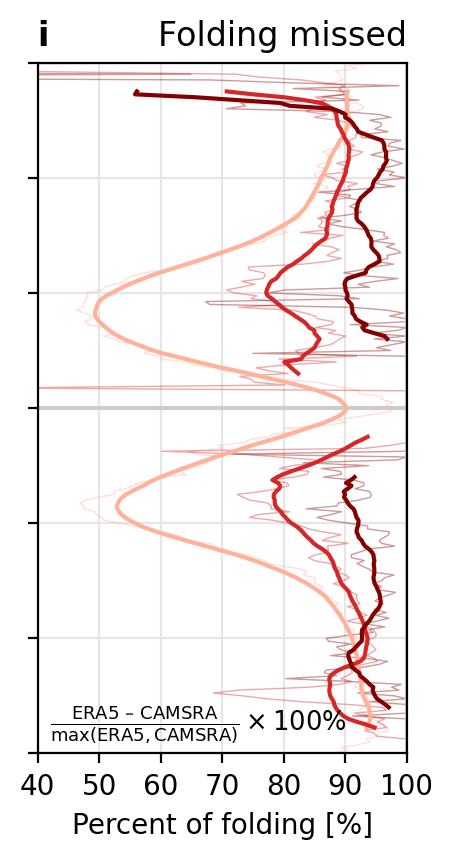

In [1068]:
# aratio = ((erafoldtime - camfoldtime)/erafoldtime).where((erafoldtime - camfoldtime)/erafoldtime != -np.inf).mean('lon')*100
# sratio = ((erafoldstime - camfoldstime)/erafoldstime).where((erafoldstime - camfoldstime)/erafoldstime != -np.inf).mean('lon')*100
# mratio = ((erafoldmtime - camfoldmtime)/erafoldmtime).where((erafoldmtime - camfoldmtime)/erafoldmtime != -np.inf).mean('lon')*100
# dratio = ((erafolddtime - camfolddtime)/erafolddtime).where((erafolddtime - camfolddtime)/erafolddtime != -np.inf).mean('lon')*100

sratio = mergedmaps.mean('lon')
mratio = mergedmapm.mean('lon')
dratio = mergedmapd.mean('lon')

# plt.figure(figsize=(3.25*1.1,4*1.1),dpi=200)
plt.figure(figsize=(2.15*1.1,4*1.1),dpi=200)
plt.axhline(0,color='.8')
plt.axvline(0,c='.8')
plt.grid(c='.9')

# aratio.plot(y='lat',color='0',alpha=.4,lw=.5)
sratio.plot(y='lat',color='xkcd:pale salmon',alpha=.4,lw=.5)
mratio.plot(y='lat',color='tab:red',alpha=.4,lw=.5)
dratio.plot(y='lat',color='xkcd:dark red',alpha=.4,lw=.5)

# aratio.rolling(lat=8, center=True).mean().plot(y='lat',color='0',label='S+M+D')
sratio.rolling(lat=20, center=True).mean().plot(y='lat',color='xkcd:pale salmon',label='Shallow')
mratio.rolling(lat=20, center=True).mean().plot(y='lat',color='tab:red',label='Medium')
dratio.rolling(lat=20, center=True).mean().plot(y='lat',color='xkcd:dark red',label='Deep')

plt.ylim(-90,90)
# plt.xlim(0,100)
plt.xlim(40,100)
# plt.xlabel('(ERA5 – CAMSRA) / ERA5 x 100%')
# plt.xlabel(r'Diff / Greater $\times$ 100 [%]')
plt.xlabel('Percent of folding [%]')
# plt.title('ERA5 folding missed by CAMSRA',loc='left')
plt.title('i',loc='left',fontweight='bold')
# plt.title('Percent folding missed',loc='right')
plt.title('Folding missed',loc='right')
plt.ylabel('')
plt.yticks([-90,-60,-30,0,30,60,90],labels=[])
plt.xticks([40,50,60,70,80,90,100])
plt.axvline(100,c='.8')
# plt.legend()
plt.gca().yaxis.set_ticklabels([])

plt.annotate(r'$\frac{\mathrm{ERA5\ } – \mathrm{\ CAMSRA}}{\mathrm{max(ERA5, CAMSRA)}} \times 100\%$',xy=(42,-84),color='0',fontsize=9.3)

plt.tight_layout()


# Fold/ozone correlation comparison (Fig. 3, S8)

## Computations:

In [1180]:
### CALCULATE POINTWISE CORRELATIONS BETWEEN FOLDING AND 2 TYPES OF OZONE AT 3 LEVELS ###

# CHOOSE CORRELATION METHOD:
rfunc, pfunc = spearr, spearp
# rfunc, pfunc = r_val, p_val

# INPUTS:
levels = ['upper', 'mid', 'lower']
otypes = ['o3s', 'o3']
coarsenings = [6, 6, 12]
timefactor = 1  # 2 for 3-hourly, 1 for 6-hourly!
rolls = [tt*timefactor for tt in [1, 4, 12]]

camdatas = [camfold, camfold, camfoldm + camfoldd]  # NORMAL
# camdatas = [camfold.sel(time='2012-01'), camfold.sel(time='2012-01'), camfoldm.sel(time='2012-01') + camfoldd.sel(time='2012-01')]
# camdatas = [xr.concat([camfold.sel(time='2012-01'),camfoldoff],dim='time').sortby('time'),
#             xr.concat([camfold.sel(time='2012-01'),camfoldoff],dim='time').sortby('time'),
#             xr.concat([camfoldm.sel(time='2012-01'),camfoldmoff],dim='time').sortby('time') + xr.concat([camfoldd.sel(time='2012-01'),camfolddoff],dim='time').sortby('time')]

# eradatas = [erafold + (camfold - camfold), erafold + (camfold - camfold), erafoldm + erafoldd + (camfold - camfold)]  # NORMAL
# eradatas = [erafold.sel(time='2012-01') + (camfold - camfold), erafold.sel(time='2012-01') + (camfold - camfold), erafoldm.sel(time='2012-01') + erafoldd.sel(time='2012-01') + (camfold - camfold)]  # NORMAL
# eradatas = [q_upper, q_mid, q_lower]
# eradatas = [w_upper, w_mid, w_lower]
# eradatas = [xr.concat([erafold.sel(time='2012-01'),erafoldoff],dim='time').sortby('time') + (camfold - camfold),
#             xr.concat([erafold.sel(time='2012-01'),erafoldoff],dim='time').sortby('time') + (camfold - camfold),
#             xr.concat([erafoldm.sel(time='2012-01'),erafoldmoff],dim='time').sortby('time') + xr.concat([erafoldd.sel(time='2012-01'),erafolddoff],dim='time').sortby('time') + (camfold - camfold)]
# # comment out if not comparing era5 regrid and era5 normal in same fig.:
# eradatas = [eraregridfold, eraregridfold, eraregridfoldm + eraregridfoldd]

o3sdatas = [o3s_upper, o3s_mid, o3s_lower]  # NORMAL
# o3sdatas = [o3s_upper.sel(time='2012-01'), o3s_mid.sel(time='2012-01'), o3s_lower.sel(time='2012-01')]
# o3sdatas = [xr.concat([o3s_upper.sel(time='2012-01'),o3soff_upper],dim='time').sortby('time'),
#             xr.concat([o3s_mid.sel(time='2012-01'),o3soff_mid],dim='time').sortby('time'),
#             xr.concat([o3s_lower.sel(time='2012-01'),o3soff_lower],dim='time').sortby('time')]

o3datas = [o3_upper, o3_mid, o3_lower]  # NORMAL
# o3datas = [o3_upper.sel(time='2012-01'), o3_mid.sel(time='2012-01'), o3_lower.sel(time='2012-01')]
# o3datas = [xr.concat([o3_upper.sel(time='2012-01'),o3off_upper],dim='time').sortby('time'),
#            xr.concat([o3_mid.sel(time='2012-01'),o3off_mid],dim='time').sortby('time'),
#            xr.concat([o3_lower.sel(time='2012-01'),o3off_lower],dim='time').sortby('time')]


# LOOP THROUGH LEVELS FOR THE CHOSEN CORRELATION METHOD:
for ii,level in enumerate(levels):
    
    if ii == ii:#1:

        # ASSIGN INPUTS:
        coarsening = coarsenings[ii]
        roll = rolls[ii]

        # CREATE DATASET:
        camdata, eradata = camdatas[ii].rename('camdata'), eradatas[ii].rename('eradata')
        o3sdata = o3sdatas[ii].rename('o3sdata').drop('plev')#.assign_coords(lon=('longitude',camfold_global.lon),lat=('latitude',camfold_global.lat)).swap_dims({'longitude':'lon','latitude':'lat'}).drop(('latitude','longitude'))
        o3data = o3datas[ii].rename('o3data').drop('plev')#.assign_coords(lon=('longitude',camfold_global.lon),lat=('latitude',camfold_global.lat)).swap_dims({'longitude':'lon','latitude':'lat'}).drop(('latitude','longitude'))
        ds_foldozone = xr.merge([camdata, eradata, o3sdata, o3data])

        # SELECT SEASON:
        # all-year
        ds_foldozone_seasonal = ds_foldozone
        # ondjfm
        # ds_foldozone_seasonal = ds_foldozone[(ds_foldozone.time.dt.month<=3) | (ds_foldozone.time.dt.month>=10)]
        # amjjas
        # ds_foldozone_seasonal = ds_foldozone[(ds_foldozone.time.dt.month>=4) & (ds_foldozone.time.dt.month<=9)]

        # COARSEN:
        ds_foldozone_coarse = ds_foldozone_seasonal.coarsen(lat=coarsening,lon=coarsening,boundary="trim").mean()

        # DESEASONALIZE:
        print('computing step:')
        with pbar:
            if len(np.unique(ds_foldozone_coarse.time.dt.month)) > 1:
                ds_foldozone_coarse_anom = (ds_foldozone_coarse - ds_foldozone_coarse.resample(time='MS', loffset=pd.Timedelta(14, 'd')).mean('time').interp(time=ds_foldozone_coarse.time,method='linear',kwargs={"fill_value": "extrapolate"})).compute()
            else:
                ds_foldozone_coarse_anom = (ds_foldozone_coarse - ds_foldozone_coarse.resample(time='MS', loffset=pd.Timedelta(14, 'd')).mean('time').isel(time=0)).compute()
        # REMOVE TIME-MEAN, TAKE 1.5- AND 3-DAY RUNNING-MEAN FOR MID AND LOWER, TIME-RANK:
        ds_foldozone_forcorr = (ds_foldozone_coarse_anom - ds_foldozone_coarse_anom.mean('time')).rolling(time=roll,min_periods=1).mean().rank('time')

        # CALCULATE CORRELATIONS AT EACH GRIDCELL FOR EACH O-TYPE:
        for iii,otype in enumerate(otypes):
            omask = np.isnan([ds_foldozone_forcorr.o3sdata, ds_foldozone_forcorr.o3data][iii]).sum('time')==0
            # omask.plot()
            ds_foldozone_forcorr = ds_foldozone_forcorr.where(omask,0)
            cforcorr, eforcorr, oforcorr = ds_foldozone_forcorr.camdata, ds_foldozone_forcorr.eradata, [ds_foldozone_forcorr.o3sdata, ds_foldozone_forcorr.o3data][iii]
            (camr, camp, erar, erap) = (xr.apply_ufunc(rfunc, cforcorr, oforcorr, vectorize=True, input_core_dims=[['time'], ['time']]).where(omask),
                                        xr.apply_ufunc(pfunc, cforcorr, oforcorr, vectorize=True, input_core_dims=[['time'], ['time']]).where(omask),
                                        xr.apply_ufunc(rfunc, eforcorr, oforcorr, vectorize=True, input_core_dims=[['time'], ['time']]).where(omask),
                                        xr.apply_ufunc(pfunc, eforcorr, oforcorr, vectorize=True, input_core_dims=[['time'], ['time']]).where(omask))
            camz, eraz = np.arctanh(camr), np.arctanh(erar)
            diffz = (eraz - camz) / np.sqrt( 1/(len(cforcorr.time)-3) + 1/(len(eforcorr.time)-3))

            # ASSIGN VARIABLE NAMES AS USED IN REST OF NOTEBOOK:
            if level == 'upper':
                if otype == 'o3s':
                    cam_o3s_upper_spear_unstack, p_cam_o3s_upper_unstack, era_o3s_upper_spear_unstack, p_era_o3s_upper_unstack, z_diff_o3s_upper = camr, camp, erar, erap, diffz
                if otype == 'o3':
                    cam_o3_upper_spear_unstack, p_cam_o3_upper_unstack, era_o3_upper_spear_unstack, p_era_o3_upper_unstack, z_diff_o3_upper = camr, camp, erar, erap, diffz
            if level == 'mid':
                if otype == 'o3s':
                    cam_o3s_mid_spear_unstack, p_cam_o3s_mid_unstack, era_o3s_mid_spear_unstack, p_era_o3s_mid_unstack, z_diff_o3s_mid = camr, camp, erar, erap, diffz
                if otype == 'o3':
                    cam_o3_mid_spear_unstack, p_cam_o3_mid_unstack, era_o3_mid_spear_unstack, p_era_o3_mid_unstack, z_diff_o3_mid = camr, camp, erar, erap, diffz
            if level == 'lower':
                if otype == 'o3s':
                    cam_o3s_lower_spear_unstack, p_cam_o3s_lower_unstack, era_o3s_lower_spear_unstack, p_era_o3s_lower_unstack, z_diff_o3s_lower = camr, camp, erar, erap, diffz
                if otype == 'o3':
                    cam_o3_lower_spear_unstack, p_cam_o3_lower_unstack, era_o3_lower_spear_unstack, p_era_o3_lower_unstack, z_diff_o3_lower = camr, camp, erar, erap, diffz

            print(otype)
        print(level)
                       

computing step:
[########################################] | 100% Completed |  1min  9.3s


/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4529: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


o3s


/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4529: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


o3
upper
computing step:
[########################################] | 100% Completed | 23.7s


/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4529: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


o3s


/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4529: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


o3
mid
computing step:
[########################################] | 100% Completed | 17.8s


/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4529: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


o3s


/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4529: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


o3
lower


In [1181]:
# saving the above calculations to file

regrid = ['', 'regrid/'][0]   # pick
method = ['spearr', 'r_val'][0]   # pick
specialfolder = ['', 'camvsq/', 'camvsw/', '6hrvs3hr/6hr/', '6hrvs3hr/3hr/'][0]   # pick
path = f'/dx15/samuelb/trop_folds/comboedit2/{specialfolder}{regrid}{method}'   # check drive! for regular (presfix), specifiy dx13 and add /comboedit2/ (for others, dx15, no comboedit2 unless regrid)

# upper

cam_o3s_upper_spear_unstack.to_netcdf(f'{path}/cam_o3s_upper_spear_unstack_plev_presfix.nc')
p_cam_o3s_upper_unstack.to_netcdf(f'{path}/p_cam_o3s_upper_unstack_plev_presfix.nc')
era_o3s_upper_spear_unstack.to_netcdf(f'{path}/era_o3s_upper_spear_unstack_plev_presfix.nc')
p_era_o3s_upper_unstack.to_netcdf(f'{path}/p_era_o3s_upper_unstack_plev_presfix.nc')
z_diff_o3s_upper.to_netcdf(f'{path}/z_diff_o3s_upper_plev_presfix.nc')

cam_o3_upper_spear_unstack.to_netcdf(f'{path}/cam_o3_upper_spear_unstack_plev_presfix.nc')
p_cam_o3_upper_unstack.to_netcdf(f'{path}/p_cam_o3_upper_unstack_plev_presfix.nc')
era_o3_upper_spear_unstack.to_netcdf(f'{path}/era_o3_upper_spear_unstack_plev_presfix.nc')
p_era_o3_upper_unstack.to_netcdf(f'{path}/p_era_o3_upper_unstack_plev_presfix.nc')
z_diff_o3_upper.to_netcdf(f'{path}/z_diff_o3_upper_plev_presfix.nc')

# mid

cam_o3s_mid_spear_unstack.to_netcdf(f'{path}/cam_o3s_mid_spear_unstack_plev_presfix.nc')
p_cam_o3s_mid_unstack.to_netcdf(f'{path}/p_cam_o3s_mid_unstack_plev_presfix.nc')
era_o3s_mid_spear_unstack.to_netcdf(f'{path}/era_o3s_mid_spear_unstack_plev_presfix.nc')
p_era_o3s_mid_unstack.to_netcdf(f'{path}/p_era_o3s_mid_unstack_plev_presfix.nc')
z_diff_o3s_mid.to_netcdf(f'{path}/z_diff_o3s_mid_plev_presfix.nc')

cam_o3_mid_spear_unstack.to_netcdf(f'{path}/cam_o3_mid_spear_unstack_plev_presfix.nc')
p_cam_o3_mid_unstack.to_netcdf(f'{path}/p_cam_o3_mid_unstack_plev_presfix.nc')
era_o3_mid_spear_unstack.to_netcdf(f'{path}/era_o3_mid_spear_unstack_plev_presfix.nc')
p_era_o3_mid_unstack.to_netcdf(f'{path}/p_era_o3_mid_unstack_plev_presfix.nc')
z_diff_o3_mid.to_netcdf(f'{path}/z_diff_o3_mid_plev_presfix.nc')

# lower (M+d)

cam_o3s_lower_spear_unstack.to_netcdf(f'{path}/cam_o3s_lower_spear_unstack_plev_presfix.nc')
p_cam_o3s_lower_unstack.to_netcdf(f'{path}/p_cam_o3s_lower_unstack_plev_presfix.nc')
era_o3s_lower_spear_unstack.to_netcdf(f'{path}/era_o3s_lower_spear_unstack_plev_presfix.nc')
p_era_o3s_lower_unstack.to_netcdf(f'{path}/p_era_o3s_lower_unstack_plev_presfix.nc')
z_diff_o3s_lower.to_netcdf(f'{path}/z_diff_o3s_lower_plev_presfix.nc')

cam_o3_lower_spear_unstack.to_netcdf(f'{path}/cam_o3_lower_spear_unstack_plev_presfix.nc')
p_cam_o3_lower_unstack.to_netcdf(f'{path}/p_cam_o3_lower_unstack_plev_presfix.nc')
era_o3_lower_spear_unstack.to_netcdf(f'{path}/era_o3_lower_spear_unstack_plev_presfix.nc')
p_era_o3_lower_unstack.to_netcdf(f'{path}/p_era_o3_lower_unstack_plev_presfix.nc')
z_diff_o3_lower.to_netcdf(f'{path}/z_diff_o3_lower_plev_presfix.nc')

# # lower, deep only

# cam_o3s_lower_spear_unstack.to_netcdf('/dx13/samuelb/trop_folds/cam_o3s_lower_spear_unstack_plev_deeponly_presfix.nc')
# p_cam_o3s_lower_unstack.to_netcdf('/dx13/samuelb/trop_folds/p_cam_o3s_lower_unstack_plev_deeponly_presfix.nc')
# era_o3s_lower_spear_unstack.to_netcdf('/dx13/samuelb/trop_folds/era_o3s_lower_spear_unstack_plev_deeponly_presfix.nc')
# p_era_o3s_lower_unstack.to_netcdf('/dx13/samuelb/trop_folds/p_era_o3s_lower_unstack_plev_deeponly_presfix.nc')
# z_diff_o3s_lower.to_netcdf('/dx13/samuelb/trop_folds/z_diff_o3s_lower_plev_deeponly_presfix.nc')

# cam_o3_lower_spear_unstack.to_netcdf('/dx13/samuelb/trop_folds/cam_o3_lower_spear_unstack_plev_deeponly_presfix.nc')
# p_cam_o3_lower_unstack.to_netcdf('/dx13/samuelb/trop_folds/p_cam_o3_lower_unstack_plev_deeponly_presfix.nc')
# era_o3_lower_spear_unstack.to_netcdf('/dx13/samuelb/trop_folds/era_o3_lower_spear_unstack_plev_deeponly_presfix.nc')
# p_era_o3_lower_unstack.to_netcdf('/dx13/samuelb/trop_folds/p_era_o3_lower_unstack_plev_deeponly_presfix.nc')
# z_diff_o3_lower.to_netcdf('/dx13/samuelb/trop_folds/z_diff_o3_lower_plev_deeponly_presfix.nc')


## Load from file:

In [10]:
# loading the above calculations from file

regrid = ['', 'regrid/'][0]   # pick
method = ['spearr', 'r_val'][0]   # pick
specialfolder = ['', 'camvsq/', 'camvsw/', '6hrvs3hr/6hr/', '6hrvs3hr/3hr/'][0]   # pick
path = f'/dx13/samuelb/trop_folds/comboedit2/{specialfolder}{regrid}{method}'   # check drive! for regular (presfix), specifiy dx13 and add /comboedit2/ (for others, dx15, no comboedit2 unless regrid)

# upper

cam_o3s_upper_spear_unstack = xr.open_dataarray(f'{path}/cam_o3s_upper_spear_unstack_plev_presfix.nc')
p_cam_o3s_upper_unstack = xr.open_dataarray(f'{path}/p_cam_o3s_upper_unstack_plev_presfix.nc')
era_o3s_upper_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_upper_spear_unstack_plev_presfix.nc')
p_era_o3s_upper_unstack = xr.open_dataarray(f'{path}/p_era_o3s_upper_unstack_plev_presfix.nc')
z_diff_o3s_upper = xr.open_dataarray(f'{path}/z_diff_o3s_upper_plev_presfix.nc')

cam_o3_upper_spear_unstack = xr.open_dataarray(f'{path}/cam_o3_upper_spear_unstack_plev_presfix.nc')
p_cam_o3_upper_unstack = xr.open_dataarray(f'{path}/p_cam_o3_upper_unstack_plev_presfix.nc')
era_o3_upper_spear_unstack = xr.open_dataarray(f'{path}/era_o3_upper_spear_unstack_plev_presfix.nc')
p_era_o3_upper_unstack = xr.open_dataarray(f'{path}/p_era_o3_upper_unstack_plev_presfix.nc')
z_diff_o3_upper = xr.open_dataarray(f'{path}/z_diff_o3_upper_plev_presfix.nc')

# mid

cam_o3s_mid_spear_unstack = xr.open_dataarray(f'{path}/cam_o3s_mid_spear_unstack_plev_presfix.nc')
p_cam_o3s_mid_unstack = xr.open_dataarray(f'{path}/p_cam_o3s_mid_unstack_plev_presfix.nc')
era_o3s_mid_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_mid_spear_unstack_plev_presfix.nc')
p_era_o3s_mid_unstack = xr.open_dataarray(f'{path}/p_era_o3s_mid_unstack_plev_presfix.nc')
z_diff_o3s_mid = xr.open_dataarray(f'{path}/z_diff_o3s_mid_plev_presfix.nc')

cam_o3_mid_spear_unstack = xr.open_dataarray(f'{path}/cam_o3_mid_spear_unstack_plev_presfix.nc')
p_cam_o3_mid_unstack = xr.open_dataarray(f'{path}/p_cam_o3_mid_unstack_plev_presfix.nc')
era_o3_mid_spear_unstack = xr.open_dataarray(f'{path}/era_o3_mid_spear_unstack_plev_presfix.nc')
p_era_o3_mid_unstack = xr.open_dataarray(f'{path}/p_era_o3_mid_unstack_plev_presfix.nc')
z_diff_o3_mid = xr.open_dataarray(f'{path}/z_diff_o3_mid_plev_presfix.nc')

# lower

cam_o3s_lower_spear_unstack = xr.open_dataarray(f'{path}/cam_o3s_lower_spear_unstack_plev_presfix.nc')
p_cam_o3s_lower_unstack = xr.open_dataarray(f'{path}/p_cam_o3s_lower_unstack_plev_presfix.nc')
era_o3s_lower_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_lower_spear_unstack_plev_presfix.nc')
p_era_o3s_lower_unstack = xr.open_dataarray(f'{path}/p_era_o3s_lower_unstack_plev_presfix.nc')
z_diff_o3s_lower = xr.open_dataarray(f'{path}/z_diff_o3s_lower_plev_presfix.nc')

cam_o3_lower_spear_unstack = xr.open_dataarray(f'{path}/cam_o3_lower_spear_unstack_plev_presfix.nc')
p_cam_o3_lower_unstack = xr.open_dataarray(f'{path}/p_cam_o3_lower_unstack_plev_presfix.nc')
era_o3_lower_spear_unstack = xr.open_dataarray(f'{path}/era_o3_lower_spear_unstack_plev_presfix.nc')
p_era_o3_lower_unstack = xr.open_dataarray(f'{path}/p_era_o3_lower_unstack_plev_presfix.nc')
z_diff_o3_lower = xr.open_dataarray(f'{path}/z_diff_o3_lower_plev_presfix.nc')

# # lower, deep only

# cam_o3s_lower_spear_unstack = xr.open_dataarray('/dx13/samuelb/trop_folds/cam_o3s_lower_spear_unstack_plev_deeponly_presfix.nc')
# p_cam_o3s_lower_unstack = xr.open_dataarray('/dx13/samuelb/trop_folds/p_cam_o3s_lower_unstack_plev_deeponly_presfix.nc')
# era_o3s_lower_spear_unstack = xr.open_dataarray('/dx13/samuelb/trop_folds/era_o3s_lower_spear_unstack_plev_deeponly_presfix.nc')
# p_era_o3s_lower_unstack = xr.open_dataarray('/dx13/samuelb/trop_folds/p_era_o3s_lower_unstack_plev_deeponly_presfix.nc')
# z_diff_o3s_lower = xr.open_dataarray('/dx13/samuelb/trop_folds/z_diff_o3s_lower_plev_deeponly_presfix.nc')

# cam_o3_lower_spear_unstack = xr.open_dataarray('/dx13/samuelb/trop_folds/cam_o3_lower_spear_unstack_plev_deeponly_presfix.nc')
# p_cam_o3_lower_unstack = xr.open_dataarray('/dx13/samuelb/trop_folds/p_cam_o3_lower_unstack_plev_deeponly_presfix.nc')
# era_o3_lower_spear_unstack = xr.open_dataarray('/dx13/samuelb/trop_folds/era_o3_lower_spear_unstack_plev_deeponly_presfix.nc')
# p_era_o3_lower_unstack = xr.open_dataarray('/dx13/samuelb/trop_folds/p_era_o3_lower_unstack_plev_deeponly_presfix.nc')
# z_diff_o3_lower = xr.open_dataarray('/dx13/samuelb/trop_folds/z_diff_o3_lower_plev_deeponly_presfix.nc')

# # for plotting era regrid (zonal mean) on same fig. as era normal

# regrid = ['', 'regrid/'][1]   # pick
# method = ['spearr', 'r_val'][0]   # pick
# path = f'/dx15/samuelb/trop_folds/comboedit2/{regrid}{method}'

# eraregrid_o3s_upper_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_upper_spear_unstack_plev_presfix.nc')
# eraregrid_o3_upper_spear_unstack = xr.open_dataarray(f'{path}/era_o3_upper_spear_unstack_plev_presfix.nc')
# eraregrid_o3s_mid_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_mid_spear_unstack_plev_presfix.nc')
# eraregrid_o3_mid_spear_unstack = xr.open_dataarray(f'{path}/era_o3_mid_spear_unstack_plev_presfix.nc')
# eraregrid_o3s_lower_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_lower_spear_unstack_plev_presfix.nc')
# eraregrid_o3_lower_spear_unstack = xr.open_dataarray(f'{path}/era_o3_lower_spear_unstack_plev_presfix.nc')


## Plotting:

In [14]:
## INPUTS FOR PLOTTING ##

otypes = ['o3s', 'o3']
vmaxes = [.45, .45, .45]
steps = [.05, .05, .05]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
titlelabel1, titlelabel2 = '$\mathbf{CAMSRA\ folding}$', '$\mathbf{ERA5\ folding}$'
label1, label2 = 'CAMSRA', 'ERA5'
factor = 1


/tmp/ipykernel_14013/1044183598.py:49: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')
/tmp/ipykernel_14013/1044183598.py:49: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')


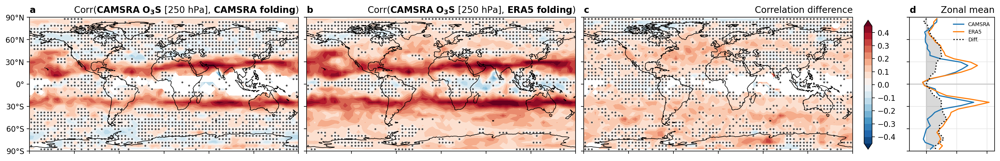

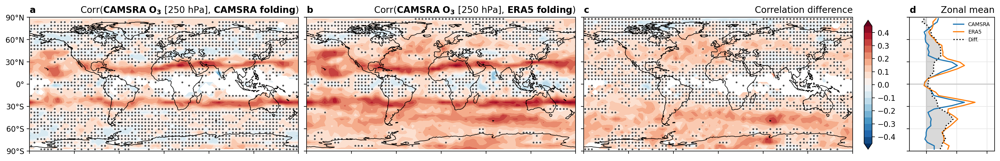

In [15]:
# Upper

dpss = [[[cam_o3s_upper_spear_unstack, cam_o3s_upper_spear_unstack.where(p_cam_o3s_upper_unstack>.05)], 
         [era_o3s_upper_spear_unstack, era_o3s_upper_spear_unstack.where(p_era_o3s_upper_unstack>.05)],
         [era_o3s_upper_spear_unstack - cam_o3s_upper_spear_unstack,(factor*era_o3s_upper_spear_unstack - cam_o3s_upper_spear_unstack).where(abs(z_diff_o3s_upper)<=1.96)]],
        [[cam_o3_upper_spear_unstack, cam_o3_upper_spear_unstack.where(p_cam_o3_upper_unstack>.05)], 
         [era_o3_upper_spear_unstack, era_o3_upper_spear_unstack.where(p_era_o3_upper_unstack>.05)],
         [era_o3_upper_spear_unstack - cam_o3_upper_spear_unstack,(factor*era_o3_upper_spear_unstack - cam_o3_upper_spear_unstack).where(abs(z_diff_o3_upper)<=1.96)]]]
titless = [['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [250 hPa], ' + titlelabel1 + ')',
            'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [250 hPa], ' + titlelabel2 + ')',
            'Correlation difference'],
           ['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [250 hPa], ' + titlelabel1 + ')',
            'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [250 hPa], ' + titlelabel2 + ')',
            'Correlation difference']]
xticklabels = []
# # comment out if not comparing era5 regrid and era5 normal in same fig.:
# dpsregrids = [eraregrid_o3s_upper_spear_unstack, 
#               eraregrid_o3_upper_spear_unstack]
          
for ii,otype in enumerate(otypes):
    dps = dpss[ii]
    titles = titless[ii]
    pnum = len(dps)

    # Correlation maps
    fig,axs = plt.subplots(1,pnum,figsize=(7*pnum,4),dpi=200,sharey=True,subplot_kw={'projection':ccrs.PlateCarree(central_longitude=0)})
    for pp in range(pnum):
        ax = axs[pp]
        dp = dps[pp][0] ## input
        ax.coastlines('110m',color='0',linewidth=.75)
        im = cyclic_dataarray(dp,'lon').plot.contourf(levels=np.arange(-vmaxes[pp],vmaxes[pp]+steps[pp],steps[pp]),extend='both',ax=ax,transform=ccrs.PlateCarree(),add_colorbar=False)
        # im = dp.plot.imshow(ax=ax,levels=np.arange(-vmaxes[pp],vmaxes[pp]+steps[pp],steps[pp]),cmap='RdBu_r',transform=ccrs.PlateCarree(),extend='both',add_colorbar=False)
        # im = dp.plot.pcolormesh(ax=ax,vmax=vmaxes[pp],vmin=-vmaxes[pp],cmap='RdBu_r',transform=ccrs.PlateCarree(),extend='both',add_colorbar=False)
        stacked = dps[pp][1].stack(x=['lon','lat'])
        ax.scatter(stacked[stacked.notnull()].lon,stacked[stacked.notnull()].lat,s=2,c='.3')
        ax.set_ylim(-90,90) 
        ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.4', alpha=0, linewidth=.8, linestyle='--')
        ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
        ax.set_yticks(yticks, crs=ccrs.PlateCarree())
        ax.set_xticks(xticks, crs=ccrs.PlateCarree())
        ax.set_xticklabels(xticklabels)
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_title('')        
        ax.set_title(['a','b','c'][pp],fontweight='bold',loc='left')
        ax.set_title(titles[pp],loc='right')
    fig.subplots_adjust(right=0.85)
    cbar_ax = fig.add_axes([0.86, 0.2, 0.007, 0.6])
    fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')
    fig.subplots_adjust(wspace=0.03)

    # Zonal mean
    ax = fig.add_axes([0.9, 0.1913, .075, 0.6225])
    ax.axhline(0,color='.8')
    ax.axvline(0,color='.8')
    ax.grid(c='.9')
    dps[0][0].mean('lon').plot(ax=ax, y='lat',label=label1)
    dps[1][0].mean('lon').plot(ax=ax, y='lat',label=label2)
    dps[2][0].mean('lon').plot(ax=ax, y='lat',c='0',ls=':',label='Diff.')
    ax.fill_betweenx(dps[2][0].mean('lon').lat, dps[2][0].mean('lon'),facecolor='0',alpha=.15,edgecolor='none',zorder=2)
    # # comment out if not comparing era5 regrid and era5 normal in same fig.:
    # dpsregrids[ii].mean('lon').plot(ax=ax, y='lat',c='tab:red',ls='--',lw=.75,label='ERA5 vert.,\nCAMSRA horiz.')
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_yticks(np.arange(-90,120,30))
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    ax.set_ylim([-90,90])
    ax.set_xlim([-vmaxes[pp]/4,vmaxes[pp]])
    ax.set_title('')
    ax.set_title('d',fontweight='bold',loc='left') 
    ax.set_title('Zonal mean',loc='right')
    ax.legend(loc='upper right',fontsize='x-small',frameon=False)


/tmp/ipykernel_14013/1879594342.py:49: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')
/tmp/ipykernel_14013/1879594342.py:49: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')


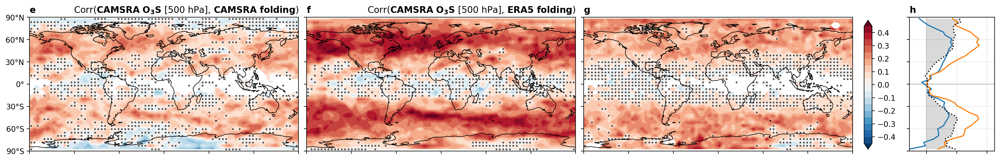

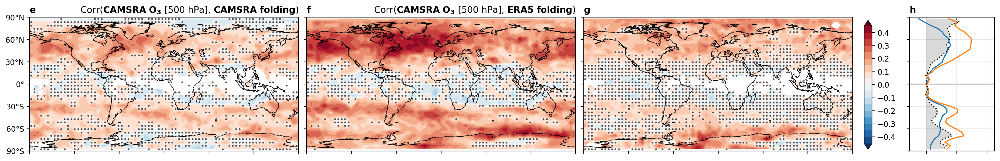

In [16]:
# Mid

dpss = [[[cam_o3s_mid_spear_unstack, cam_o3s_mid_spear_unstack.where(p_cam_o3s_mid_unstack>.05)], 
         [factor*era_o3s_mid_spear_unstack, factor*era_o3s_mid_spear_unstack.where(p_era_o3s_mid_unstack>.05)],
         [factor*era_o3s_mid_spear_unstack - cam_o3s_mid_spear_unstack,(factor*era_o3s_mid_spear_unstack - cam_o3s_mid_spear_unstack).where(abs(z_diff_o3s_mid)<=1.96)]],
        [[cam_o3_mid_spear_unstack, cam_o3_mid_spear_unstack.where(p_cam_o3_mid_unstack>.05)], 
         [factor*era_o3_mid_spear_unstack, factor*era_o3_mid_spear_unstack.where(p_era_o3_mid_unstack>.05)],
         [factor*era_o3_mid_spear_unstack - cam_o3_mid_spear_unstack,(factor*era_o3_mid_spear_unstack - cam_o3_mid_spear_unstack).where(abs(z_diff_o3_mid)<=1.96)]]]
titless = [['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [500 hPa], ' + titlelabel1 + ')',
            'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [500 hPa], ' + titlelabel2 + ')',
            ''],
           ['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [500 hPa], ' + titlelabel1 + ')',
            'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [500 hPa], ' + titlelabel2 + ')',
            '']]
xticklabels = []
# # comment out if not comparing era5 regrid and era5 normal in same fig.:
# dpsregrids = [eraregrid_o3s_mid_spear_unstack, 
#               eraregrid_o3_mid_spear_unstack]

for ii,otype in enumerate(otypes):
    dps = dpss[ii]
    titles = titless[ii]
    pnum = len(dps)

    # Correlation maps
    fig,axs = plt.subplots(1,pnum,figsize=(7*pnum,4),dpi=200,sharey=True,subplot_kw={'projection':ccrs.PlateCarree(central_longitude=0)})
    for pp in range(pnum):
        ax = axs[pp]
        dp = dps[pp][0] ## input
        ax.coastlines('110m',color='0',linewidth=.75)
        im = cyclic_dataarray(dp,'lon').plot.contourf(levels=np.arange(-vmaxes[pp],vmaxes[pp]+steps[pp],steps[pp]),extend='both',ax=ax,transform=ccrs.PlateCarree(),add_colorbar=False)
        # im = dp.plot.imshow(ax=ax,vmax=vmaxes[pp],vmin=-vmaxes[pp],cmap='RdBu_r',transform=ccrs.PlateCarree(),extend='both',add_colorbar=False)
        # im = dp.plot.pcolormesh(ax=ax,vmax=vmaxes[pp],vmin=-vmaxes[pp],cmap='RdBu_r',transform=ccrs.PlateCarree(),extend='both',add_colorbar=False)        
        stacked = dps[pp][1].stack(x=['lon','lat'])
        ax.scatter(stacked[stacked.notnull()].lon,stacked[stacked.notnull()].lat,s=2,c='.3')
        ax.set_ylim(-90,90) 
        ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.4', alpha=0, linewidth=.8, linestyle='--')
        ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
        ax.set_yticks(yticks, crs=ccrs.PlateCarree())
        ax.set_xticks(xticks, crs=ccrs.PlateCarree())
        ax.set_xticklabels(xticklabels)
        ax.set_title('')        
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_title(['e','f','g'][pp],fontweight='bold',loc='left')
        ax.set_title(titles[pp],loc='right')
    fig.subplots_adjust(right=0.85)
    cbar_ax = fig.add_axes([0.86, 0.2, 0.007, 0.6])
    fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')
    fig.subplots_adjust(wspace=0.03)

    # Zonal mean
    ax = fig.add_axes([0.9, 0.1913, .075, 0.6225])
    ax.axhline(0,color='.8')
    ax.axvline(0,color='.8')
    ax.grid(c='.9')
    dps[0][0].mean('lon').plot(ax=ax, y='lat',label='CAMSRA')
    dps[1][0].mean('lon').plot(ax=ax, y='lat',label='ERA5')
    dps[2][0].mean('lon').plot(ax=ax, y='lat',c='0',ls=':',label='Diff.')
    ax.fill_betweenx(dps[2][0].mean('lon').lat, dps[2][0].mean('lon'),facecolor='0',alpha=.15,edgecolor='none',zorder=2)
    # # comment out if not comparing era5 regrid and era5 normal in same fig.:
    # dpsregrids[ii].mean('lon').plot(ax=ax, y='lat',c='tab:red',ls='--',lw=.75,label='ERA5 vert.,\nCAMSRA horiz.')
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_yticks(np.arange(-90,120,30))
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    ax.set_ylim([-90,90])
    ax.set_xlim([-vmaxes[pp]/4,vmaxes[pp]])
    ax.set_title('')    
    ax.set_title('h',fontweight='bold',loc='left') 


/tmp/ipykernel_14013/4196497315.py:49: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')
/tmp/ipykernel_14013/4196497315.py:49: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')


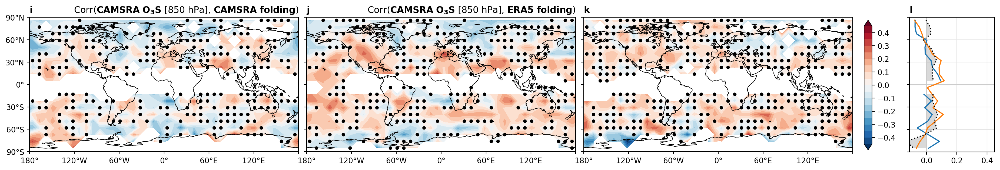

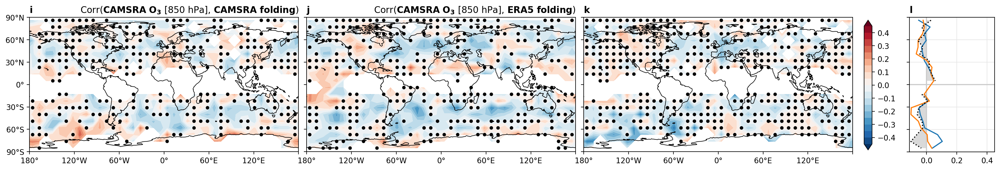

In [17]:
# Lower

dpss = [[[cam_o3s_lower_spear_unstack, cam_o3s_lower_spear_unstack.where(p_cam_o3s_lower_unstack>.05)], 
         [factor*era_o3s_lower_spear_unstack, factor*era_o3s_lower_spear_unstack.where(p_era_o3s_lower_unstack>.05)],
         [factor*era_o3s_lower_spear_unstack - cam_o3s_lower_spear_unstack,(factor*era_o3s_lower_spear_unstack - cam_o3s_lower_spear_unstack).where(abs(z_diff_o3s_lower)<=1.96)]],
        [[cam_o3_lower_spear_unstack, cam_o3_lower_spear_unstack.where(p_cam_o3_lower_unstack>.05)], 
         [factor*era_o3_lower_spear_unstack, factor*era_o3_lower_spear_unstack.where(p_era_o3_lower_unstack>.05)],
         [factor*era_o3_lower_spear_unstack - cam_o3_lower_spear_unstack,(factor*era_o3_lower_spear_unstack - cam_o3_lower_spear_unstack).where(abs(z_diff_o3_lower)<=1.96)]]]
titless = [['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [850 hPa], ' + titlelabel1 + ')',
            'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [850 hPa], ' + titlelabel2 + ')',
            ''],
           ['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [850 hPa], ' + titlelabel1 + ')',
            'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [850 hPa], ' + titlelabel2 + ')',
            '']]
xticklabels = ['180°', '120°W', '60°W', '0°', '60°E', '120°E', '']
# # comment out if not comparing era5 regrid and era5 normal in same fig.:
# dpsregrids = [eraregrid_o3s_lower_spear_unstack, 
#               eraregrid_o3_lower_spear_unstack]

for ii,otype in enumerate(otypes):
    dps = dpss[ii]
    titles = titless[ii]
    pnum = len(dps)

    # Correlation maps
    fig,axs = plt.subplots(1,pnum,figsize=(7*pnum,4),dpi=200,sharey=True,subplot_kw={'projection':ccrs.PlateCarree(central_longitude=0)})
    for pp in range(pnum):
        ax = axs[pp]
        dp = dps[pp][0] ## input
        ax.coastlines('110m',color='0',linewidth=.75)
        im = cyclic_dataarray(dp,'lon').plot.contourf(levels=np.arange(-vmaxes[pp],vmaxes[pp]+steps[pp],steps[pp]),extend='both',ax=ax,transform=ccrs.PlateCarree(),add_colorbar=False)
        # im = dp.plot.imshow(ax=ax,vmax=vmaxes[pp],vmin=-vmaxes[pp],cmap='RdBu_r',transform=ccrs.PlateCarree(),extend='both',add_colorbar=False)
        # im = dp.plot.pcolormesh(ax=ax,vmax=vmaxes[pp],vmin=-vmaxes[pp],cmap='RdBu_r',transform=ccrs.PlateCarree(),extend='both',add_colorbar=False)    
        stacked = dps[pp][1].stack(x=['lon','lat'])
        ax.scatter(stacked[stacked.notnull()].lon,stacked[stacked.notnull()].lat,s=85,c='0',marker='.',alpha=1,edgecolor='none')
        ax.set_ylim(-90,90) 
        ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.4', alpha=0, linewidth=.8, linestyle='--')
        ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
        ax.set_yticks(yticks, crs=ccrs.PlateCarree())
        ax.set_xticks(xticks, crs=ccrs.PlateCarree())
        ax.set_xticklabels(xticklabels)
        ax.set_title('')        
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_title(['i','j','k'][pp],fontweight='bold',loc='left')
        ax.set_title(titles[pp],loc='right')
    fig.subplots_adjust(right=0.85)
    cbar_ax = fig.add_axes([0.86, 0.2, 0.007, 0.6])
    fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')
    fig.subplots_adjust(wspace=0.03)

    # Zonal mean
    ax = fig.add_axes([0.9, 0.1913, .075, 0.6225])
    ax.axhline(0,color='.8')
    ax.axvline(0,color='.8')
    ax.grid(c='.9')
    dps[0][0].mean('lon').plot(ax=ax, y='lat',label='CAMSRA')
    dps[1][0].mean('lon').plot(ax=ax, y='lat',label='ERA5')
    dps[2][0].mean('lon').plot(ax=ax, y='lat',c='0',ls=':',label='Diff.')
    ax.fill_betweenx(dps[2][0].mean('lon').lat, dps[2][0].mean('lon'),facecolor='0',alpha=.15,edgecolor='none',zorder=2)
    # # comment out if not comparing era5 regrid and era5 normal in same fig.:
    # dpsregrids[ii].mean('lon').plot(ax=ax, y='lat',c='tab:red',ls='--',lw=.75,label='ERA5 vert.,\nCAMSRA horiz.')
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_yticks(np.arange(-90,120,30))
    ax.set_yticklabels([])
    ax.set_ylim([-90,90])
    ax.set_xlim([-vmaxes[pp]/4,vmaxes[pp]])
    ax.set_title('')    
    ax.set_title('l',fontweight='bold',loc='left') 


In [794]:
# Comparing O3 vs. q and w

# loading the above calculations from file

regrid = ['', 'regrid/'][0]   # pick
method = ['spearr', 'r_val'][0]   # pick
specialfolder = ['', 'camvsq/', 'camvsw/', '6hrvs3hr/6hr/', '6hrvs3hr/3hr/'][1]   # pick
path = f'/dx15/samuelb/trop_folds/{specialfolder}{regrid}{method}'   # check drive! for regular (presfix), specifiy dx13 and add /comboedit2/ (for others, dx15, no comboedit2)
specialfolder = ['', 'camvsq/', 'camvsw/', '6hrvs3hr/6hr/', '6hrvs3hr/3hr/'][2]   # pick
path2 = f'/dx15/samuelb/trop_folds/{specialfolder}{regrid}{method}'   # check drive! for regular (presfix), specifiy dx13 and add /comboedit2/ (for others, dx15, no comboedit2)

# upper

cam_o3s_upper_spear_unstack = xr.open_dataarray(f'{path}/cam_o3s_upper_spear_unstack_plev_presfix.nc')
p_cam_o3s_upper_unstack = xr.open_dataarray(f'{path}/p_cam_o3s_upper_unstack_plev_presfix.nc')
era_o3s_upper_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_upper_spear_unstack_plev_presfix.nc')
p_era_o3s_upper_unstack = xr.open_dataarray(f'{path}/p_era_o3s_upper_unstack_plev_presfix.nc')
era2_o3s_upper_spear_unstack = xr.open_dataarray(f'{path2}/era_o3s_upper_spear_unstack_plev_presfix.nc')
p_era2_o3s_upper_unstack = xr.open_dataarray(f'{path2}/p_era_o3s_upper_unstack_plev_presfix.nc')

cam_o3_upper_spear_unstack = xr.open_dataarray(f'{path}/cam_o3_upper_spear_unstack_plev_presfix.nc')
p_cam_o3_upper_unstack = xr.open_dataarray(f'{path}/p_cam_o3_upper_unstack_plev_presfix.nc')
era_o3_upper_spear_unstack = xr.open_dataarray(f'{path}/era_o3_upper_spear_unstack_plev_presfix.nc')
p_era_o3_upper_unstack = xr.open_dataarray(f'{path}/p_era_o3_upper_unstack_plev_presfix.nc')
era2_o3_upper_spear_unstack = xr.open_dataarray(f'{path2}/era_o3_upper_spear_unstack_plev_presfix.nc')
p_era2_o3_upper_unstack = xr.open_dataarray(f'{path2}/p_era_o3_upper_unstack_plev_presfix.nc')

# mid

cam_o3s_mid_spear_unstack = xr.open_dataarray(f'{path}/cam_o3s_mid_spear_unstack_plev_presfix.nc')
p_cam_o3s_mid_unstack = xr.open_dataarray(f'{path}/p_cam_o3s_mid_unstack_plev_presfix.nc')
era_o3s_mid_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_mid_spear_unstack_plev_presfix.nc')
p_era_o3s_mid_unstack = xr.open_dataarray(f'{path}/p_era_o3s_mid_unstack_plev_presfix.nc')
era2_o3s_mid_spear_unstack = xr.open_dataarray(f'{path2}/era_o3s_mid_spear_unstack_plev_presfix.nc')
p_era2_o3s_mid_unstack = xr.open_dataarray(f'{path2}/p_era_o3s_mid_unstack_plev_presfix.nc')

cam_o3_mid_spear_unstack = xr.open_dataarray(f'{path}/cam_o3_mid_spear_unstack_plev_presfix.nc')
p_cam_o3_mid_unstack = xr.open_dataarray(f'{path}/p_cam_o3_mid_unstack_plev_presfix.nc')
era_o3_mid_spear_unstack = xr.open_dataarray(f'{path}/era_o3_mid_spear_unstack_plev_presfix.nc')
p_era_o3_mid_unstack = xr.open_dataarray(f'{path}/p_era_o3_mid_unstack_plev_presfix.nc')
era2_o3_mid_spear_unstack = xr.open_dataarray(f'{path2}/era_o3_mid_spear_unstack_plev_presfix.nc')
p_era2_o3_mid_unstack = xr.open_dataarray(f'{path2}/p_era_o3_mid_unstack_plev_presfix.nc')

# lower

cam_o3s_lower_spear_unstack = xr.open_dataarray(f'{path}/cam_o3s_lower_spear_unstack_plev_presfix.nc')
p_cam_o3s_lower_unstack = xr.open_dataarray(f'{path}/p_cam_o3s_lower_unstack_plev_presfix.nc')
era_o3s_lower_spear_unstack = xr.open_dataarray(f'{path}/era_o3s_lower_spear_unstack_plev_presfix.nc')
p_era_o3s_lower_unstack = xr.open_dataarray(f'{path}/p_era_o3s_lower_unstack_plev_presfix.nc')
era2_o3s_lower_spear_unstack = xr.open_dataarray(f'{path2}/era_o3s_lower_spear_unstack_plev_presfix.nc')
p_era2_o3s_lower_unstack = xr.open_dataarray(f'{path2}/p_era_o3s_lower_unstack_plev_presfix.nc')

cam_o3_lower_spear_unstack = xr.open_dataarray(f'{path}/cam_o3_lower_spear_unstack_plev_presfix.nc')
p_cam_o3_lower_unstack = xr.open_dataarray(f'{path}/p_cam_o3_lower_unstack_plev_presfix.nc')
era_o3_lower_spear_unstack = xr.open_dataarray(f'{path}/era_o3_lower_spear_unstack_plev_presfix.nc')
p_era_o3_lower_unstack = xr.open_dataarray(f'{path}/p_era_o3_lower_unstack_plev_presfix.nc')
era2_o3_lower_spear_unstack = xr.open_dataarray(f'{path2}/era_o3_lower_spear_unstack_plev_presfix.nc')
p_era2_o3_lower_unstack = xr.open_dataarray(f'{path2}/p_era_o3_lower_unstack_plev_presfix.nc')


/tmp/ipykernel_2900/3413268266.py:79: MatplotlibDeprecationWarning: The 'extend' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')


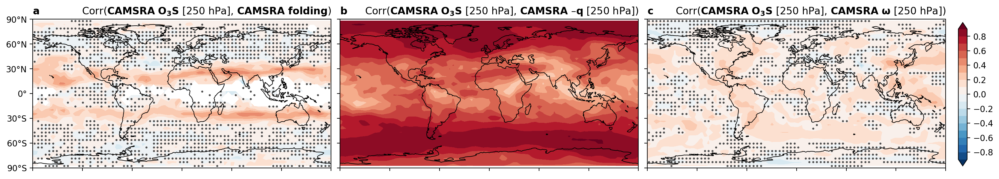

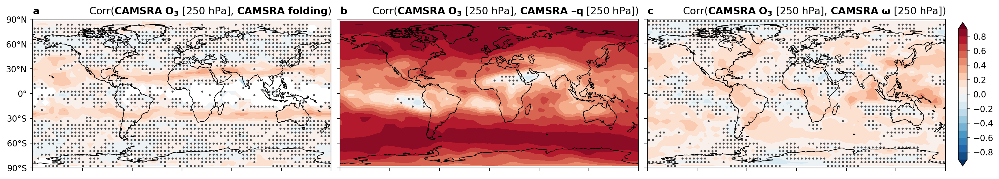

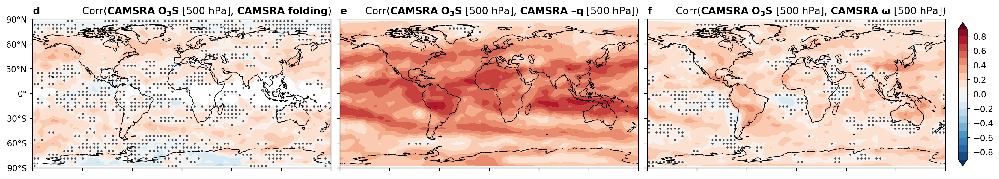

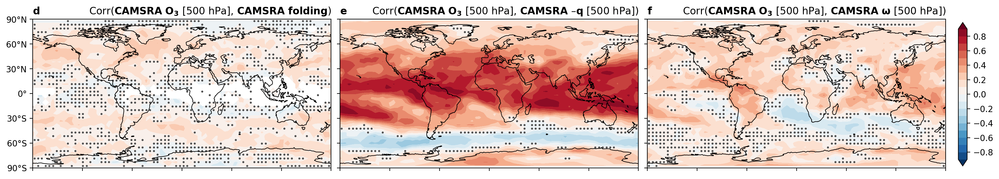

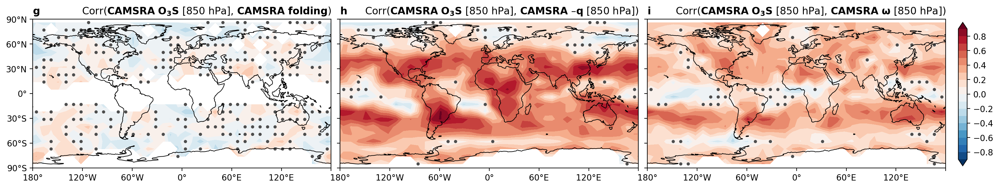

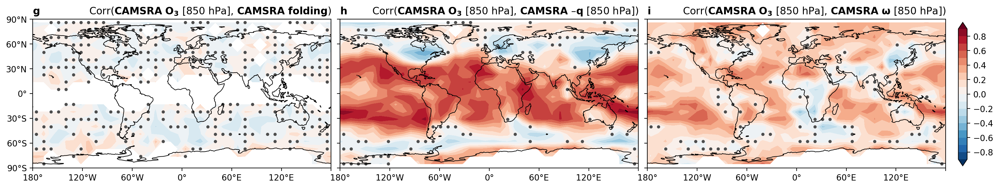

In [795]:
## INPUTS FOR PLOTTING ##

otypes = ['o3s', 'o3']
colorfactor = 2
vmaxes = [x*colorfactor for x in [.45, .45, .45]]
steps = [x*colorfactor for x in [.05, .05, .05]]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120, 180]
titlelabel1, titlelabel2, titlelabel3 = '$\mathbf{CAMSRA\ folding}$', '$\mathbf{CAMSRA\ –q}$', '$\mathbf{CAMSRA\ \omega}$'

dpss = [[[[cam_o3s_upper_spear_unstack, cam_o3s_upper_spear_unstack.where(p_cam_o3s_upper_unstack>.05)], 
          [-era_o3s_upper_spear_unstack, -era_o3s_upper_spear_unstack.where(p_era_o3s_upper_unstack>.05)],
          [era2_o3s_upper_spear_unstack, era2_o3s_upper_spear_unstack.where(p_era2_o3s_upper_unstack>.05)]],
         [[cam_o3_upper_spear_unstack, cam_o3_upper_spear_unstack.where(p_cam_o3_upper_unstack>.05)], 
          [-era_o3_upper_spear_unstack, -era_o3_upper_spear_unstack.where(p_era_o3_upper_unstack>.05)],
          [era2_o3_upper_spear_unstack, era2_o3_upper_spear_unstack.where(p_era2_o3_upper_unstack>.05)]]],
        [[[cam_o3s_mid_spear_unstack, cam_o3s_mid_spear_unstack.where(p_cam_o3s_mid_unstack>.05)], 
          [-era_o3s_mid_spear_unstack, -era_o3s_mid_spear_unstack.where(p_era_o3s_mid_unstack>.05)],
          [era2_o3s_mid_spear_unstack, era2_o3s_mid_spear_unstack.where(p_era2_o3s_mid_unstack>.05)]],
         [[cam_o3_mid_spear_unstack, cam_o3_mid_spear_unstack.where(p_cam_o3_mid_unstack>.05)], 
          [-era_o3_mid_spear_unstack, -era_o3_mid_spear_unstack.where(p_era_o3_mid_unstack>.05)],
          [era2_o3_mid_spear_unstack, era2_o3_mid_spear_unstack.where(p_era2_o3_mid_unstack>.05)]]],
        [[[cam_o3s_lower_spear_unstack, cam_o3s_lower_spear_unstack.where(p_cam_o3s_lower_unstack>.05)], 
          [-era_o3s_lower_spear_unstack, -era_o3s_lower_spear_unstack.where(p_era_o3s_lower_unstack>.05)],
          [era2_o3s_lower_spear_unstack, era2_o3s_lower_spear_unstack.where(p_era2_o3s_lower_unstack>.05)]],
         [[cam_o3_lower_spear_unstack, cam_o3_lower_spear_unstack.where(p_cam_o3_lower_unstack>.05)], 
          [-era_o3_lower_spear_unstack, -era_o3_lower_spear_unstack.where(p_era_o3_lower_unstack>.05)],
          [era2_o3_lower_spear_unstack, era2_o3_lower_spear_unstack.where(p_era2_o3_lower_unstack>.05)]]]]
titless = [[['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [250 hPa], ' + titlelabel1 + ')',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [250 hPa], ' + titlelabel2 + ' [250 hPa])',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [250 hPa], ' + titlelabel3 + ' [250 hPa])'],
            ['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [250 hPa], ' + titlelabel1 + ')',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [250 hPa], ' + titlelabel2 + ' [250 hPa])',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [250 hPa], ' + titlelabel3 + ' [250 hPa])']],
           [['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [500 hPa], ' + titlelabel1 + ')',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [500 hPa], ' + titlelabel2 + ' [500 hPa])',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [500 hPa], ' + titlelabel3 + ' [500 hPa])'],
            ['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [500 hPa], ' + titlelabel1 + ')',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [500 hPa], ' + titlelabel2 + ' [500 hPa])',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [500 hPa], ' + titlelabel3 + ' [500 hPa])']],
           [['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [850 hPa], ' + titlelabel1 + ')',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [850 hPa], ' + titlelabel2 + ' [850 hPa])',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}S}$ [850 hPa], ' + titlelabel3 + ' [850 hPa])'],
            ['Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [850 hPa], ' + titlelabel1 + ')',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [850 hPa], ' + titlelabel2 + ' [850 hPa])',
             'Corr($\mathbf{CAMSRA}$ $\mathbf{O_{3}}$ [850 hPa], ' + titlelabel3 + ' [850 hPa])']]]
xticklabels = [['', '', '', '', '', '', ''],
               ['', '', '', '', '', '', ''],
               ['180°', '120°W', '60°W', '0°', '60°E', '120°E', '']]

for level in range(3):
    for ii,otype in enumerate(otypes):
        dps = dpss[level][ii]
        titles = titless[level][ii]
        pnum = len(dps)

        # Correlation maps
        fig,axs = plt.subplots(1,pnum,figsize=(7*pnum,4),dpi=200,sharey=True,subplot_kw={'projection':ccrs.PlateCarree(central_longitude=0)})
        for pp in range(pnum):
            ax = axs[pp]
            dp = dps[pp][0] ## input
            ax.coastlines('110m',color='0',linewidth=.75)
            im = cyclic_dataarray(dp,'lon').plot.contourf(levels=np.arange(-vmaxes[pp],vmaxes[pp]+steps[pp],steps[pp]),extend='both',ax=ax,transform=ccrs.PlateCarree(),add_colorbar=False)
            stacked = dps[pp][1].stack(x=['lon','lat'])
            ax.scatter(stacked[stacked.notnull()].lon,stacked[stacked.notnull()].lat,s=[2,2,8][level],c='.3')
            ax.set_ylim(-90,90) 
            ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.4', alpha=0, linewidth=.8, linestyle='--')
            ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
            ax.set_yticks(yticks, crs=ccrs.PlateCarree())
            ax.set_xticks(xticks, crs=ccrs.PlateCarree())
            ax.set_xticklabels(xticklabels[level])
            ax.set_title('')        
            ax.set_xlabel('')
            ax.set_ylabel('')
            ax.set_title([['a','b','c'],['d','e','f'],['g','h','i']][level][pp],fontweight='bold',loc='left')
            ax.set_title(titles[pp],loc='right')
        fig.subplots_adjust(right=0.85)
        cbar_ax = fig.add_axes([0.86, 0.2, 0.007, 0.6])
        fig.colorbar(im, cax=cbar_ax,pad=.07,shrink=.7,extend='both')
        fig.subplots_adjust(wspace=0.03)


# Fold composites comparison (just plotting) (Fig. 4a–b, S10)

In [539]:
def fmt(x):
    s = f"{x:.1f}"
    if s.endswith("0"):
        s = f"{x:.0f}"
    return rf"{s} \%" if plt.rcParams["text.usetex"] else f"{s}%"


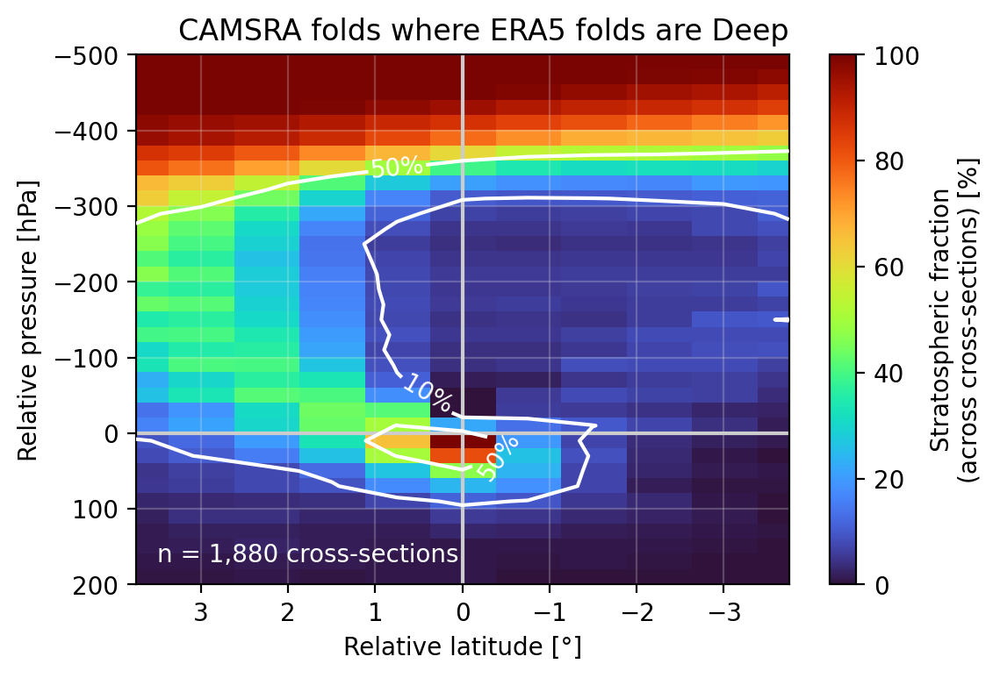

In [1292]:
datasettoggle = 0
depthtoggle = 3
pcentertoggle = 1
onlytoggle = 3
coltoggle = 1 # = datasettoggle

meanses = []
ns = []

datasets = ['CAMSRA','ERA5']
dataset = datasets[datasettoggle]
cols = ['0','1']
col = cols[coltoggle]
depths = ['shallow','medium','deep','any']
depth = depths[depthtoggle]
pcenters = ['','_tpcenter']
pcenter = pcenters[pcentertoggle]
onlys = ['','_onlyboth','_onlyERA5','_onlyERA5deep']
only = onlys[onlytoggle]

means = xr.open_dataarray(f'/dx13/samuelb/trop_folds/comboedit2/{dataset}_composites_{depth}{pcenter}_nonan{only}_mean.nc')
meanses.append((means-1)/(means-1).sel(p_bins=10,y=0))
ns.append(len(xr.open_dataarray(f'/dx13/samuelb/trop_folds/comboedit2/{dataset}_composites_{depth}{pcenter}_nonan{only}.nc').n))
    
# vmaxes = [1]
vmaxes = [100]
vmins = [0]
cmaps = ['turbo']

titles = ['CAMSRA folds where ERA5 folds are Deep']
          
for ii,means in enumerate([n*100 for n in meanses]):
    
    plt.figure(dpi=200)
    plt.grid(c='.9',ls='-',alpha=.25)
    plt.axhline(0,c='.8')
    plt.axvline(0,c='.8')
    means.plot.imshow(y='p_bins',yincrease=False,xincrease=False,cmap=cmaps[ii],vmin=vmins[ii],vmax=vmaxes[ii],cbar_kwargs={'label':'Stratospheric fraction\n(across cross-sections) [%]','extend':'neither'})
#     means.plot.contourf(levels=np.linspace(0,1,21),y='p_bins',yincrease=False,xincrease=False,cmap='turbo') # contourf
    cc = means.plot.contour(levels=[10,50],colors=[col],y='p_bins',yincrease=False,xincrease=False,zorder=5)    #[1.125]
    plt.clabel(cc, cc.levels, inline=True, fmt=fmt)
    plt.ylabel('Relative pressure [hPa]')
    plt.xlabel('Relative latitude [°]')
    extent = [-3.75,3.75]
    plt.xlim((extent[1],extent[0]))
    plt.ylim(200,-500)
    plt.title(titles[ii],loc='right')
    
    if ii <2:
        plt.annotate("n = {:,} cross-sections".format(ns[ii]),xy=(3.5,170),color='1')
        

In [1293]:
with pbar:
    camdeep = camfoldd.where(erafoldd).compute()
    cammed = camfoldm.where(erafoldd).compute()
    camshall = camfolds.where(erafoldd).compute()
    camnone = camdeep + cammed + camshall == 0
    
camdepth = camdeep*3 + cammed*2 + camshall


/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/xarray/core/indexing.py:1234: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  value = value[(slice(None),) * axis + (subkey,)]


[########################################] | 100% Completed | 45.9s
[                                        ] | 0% Completed |  0.0s

/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/xarray/core/indexing.py:1234: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  value = value[(slice(None),) * axis + (subkey,)]


[########################################] | 100% Completed |  8.1s
[                                        ] | 0% Completed |  0.0s

/home/samuelb/.conda/envs/r_py_env/lib/python3.9/site-packages/xarray/core/indexing.py:1234: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  value = value[(slice(None),) * axis + (subkey,)]


[########################################] | 100% Completed |  7.4s


(0.0, 57000.0)

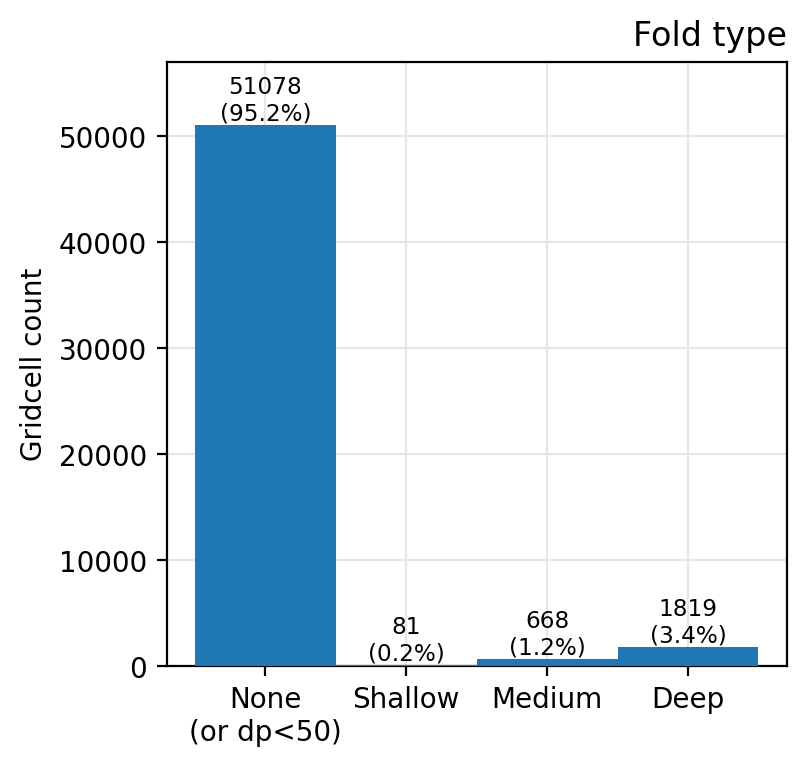

In [1295]:
print(counts.sum())

fig,ax = plt.subplots(1,1,dpi=200,figsize=(4,4))
ax.grid(c='.9')
counts,bins,rects = camdepth.plot.hist(ax=ax,bins=np.arange(-.5,4.5,1),zorder=5)
for rect,label in zip(rects,counts):
    ax.text(rect.get_x() + rect.get_width() / 2, rect.get_height()+0.01, f'{int(label)}\n({np.round(label/counts.sum()*100,1)}%)', ha='center', va='bottom', fontsize='small')
ax.set_xticks(np.arange(0,4))
ax.set_xticklabels(['None\n(or dp<50)','Shallow','Medium','Deep'])
ax.set_title('Fold type',loc='right')
ax.set_ylabel('Gridcell count')
ax.set_ylim(0,57000)
    

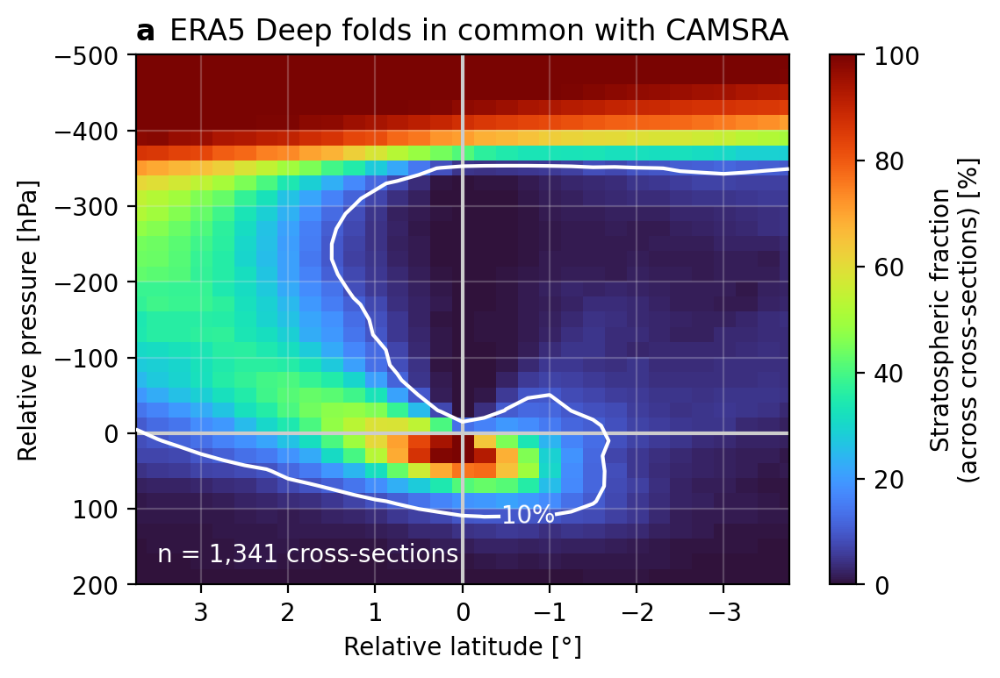

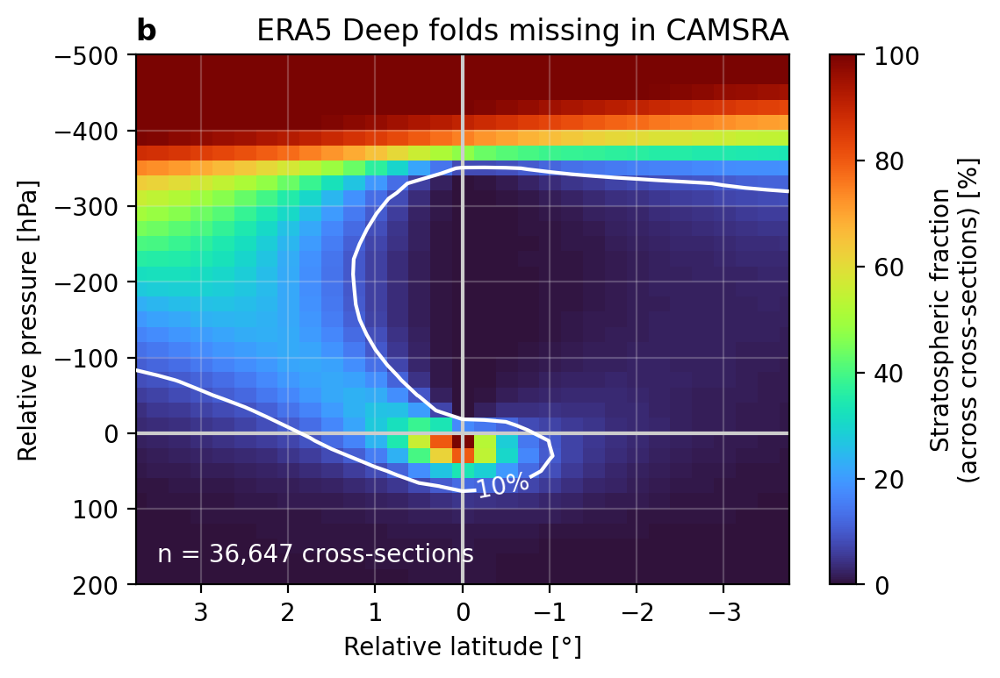

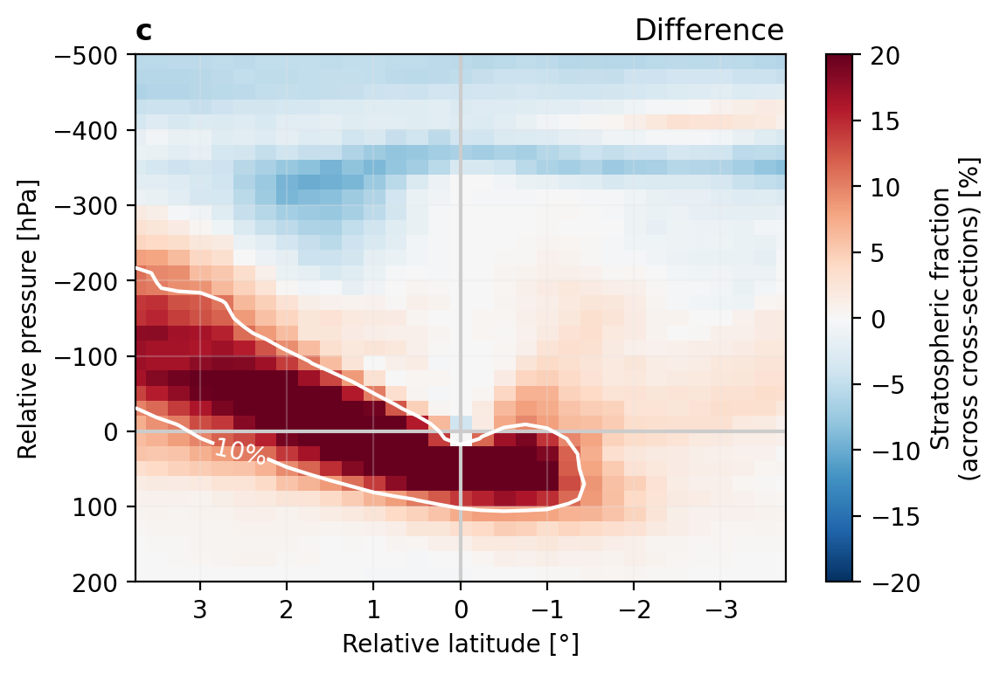

In [1326]:
datasettoggle = 1
depthtoggle = 2
pcentertoggle = 1
onlytoggle = 2
coltoggle = datasettoggle

meanses = []
ns = []

for onlytoggle in [1,2]:

    datasets = ['CAMSRA','ERA5']
    cols = ['0','1']
    dataset = datasets[datasettoggle]
    col = cols[datasettoggle]
    depths = ['shallow','medium','deep']
    depth = depths[depthtoggle]
    pcenters = ['','_tpcenter']
    pcenter = pcenters[pcentertoggle]
    onlys = ['','_onlyboth','_onlyERA5']
    only = onlys[onlytoggle]

    means = xr.open_dataarray(f'/dx13/samuelb/trop_folds/comboedit2/{dataset}_composites_{depth}{pcenter}_nonan{only}_mean.nc')
    meanses.append((means-1)/(means-1).sel(p_bins=10,y=0))
    ns.append(len(xr.open_dataarray(f'/dx13/samuelb/trop_folds/comboedit2/{dataset}_composites_{depth}{pcenter}_nonan{only}.nc').n))
    
meanses.append(meanses[0] - meanses[1])

# vmaxes = [1,1,.2]
# vmins = [0,0,-.2]
vmaxes = [100,100,20]
vmins = [0,0,-20]
cmaps = ['turbo','turbo','RdBu_r']

# titles = ['Composite deep folds\n(ERA5 in common with CAMSRA)', '\n(ERA5 only)','Difference']
titles = ['ERA5 Deep folds in common with CAMSRA', 'ERA5 Deep folds missing in CAMSRA','Difference']
panellabels = ['a', 'b', 'c']

for ii,means in enumerate([n*100 for n in meanses]):
    
    plt.figure(dpi=200)
    plt.grid(c='.9',ls='-',alpha=.25)
    plt.axhline(0,c='.8')
    plt.axvline(0,c='.8')
    means.plot.imshow(y='p_bins',yincrease=False,xincrease=False,cmap=cmaps[ii],vmin=vmins[ii],vmax=vmaxes[ii],cbar_kwargs={'label':'Stratospheric fraction\n(across cross-sections) [%]','extend':'neither'})
#     means.plot.contourf(levels=np.linspace(0,1,21),y='p_bins',yincrease=False,xincrease=False,cmap='turbo') # contourf
    # cc = means.plot.contour(levels=[-0.1,0.1,0.9],colors=[col],y='p_bins',yincrease=False,xincrease=False,zorder=5)    #[1.125]
    cc = means.plot.contour(levels=[-10,10],colors=[col],y='p_bins',yincrease=False,xincrease=False,zorder=5)    #[1.125]
    # plt.clabel(cc, cc.levels, inline=True, fmt='%1.1f')
    plt.clabel(cc, cc.levels, inline=True, fmt=fmt)
    plt.ylabel('Relative pressure [hPa]')
    plt.xlabel('Relative latitude [°]')
    extent = [-3.75,3.75]
    plt.xlim((extent[1],extent[0]))
    plt.ylim(200,-500)
    plt.title(titles[ii],loc='right')
    plt.title(panellabels[ii],loc='left',fontweight='bold')
    
    if ii <2:
        plt.annotate("n = {:,} cross-sections".format(ns[ii]),xy=(3.5,170),color='1')
    


# Fold pressure statistics comparison (Fig. 4c–d, S6, S9)

In [469]:
with pbar:
    cam_dp_s = dscam.dp.where(camfolds).compute()
    era_dp_s = dsera.dp.where(erafolds).compute()
    
    cam_dp_m = dscam.dp.where(camfoldm).compute()
    era_dp_m = dsera.dp.where(erafoldm).compute()

    cam_dp_d = dscam.dp.where(camfoldd).compute()
    era_dp_d = dsera.dp.where(erafoldd).compute()
    

[########################################] | 100% Completed | 57.2s
[########################################] | 100% Completed |  1min 47.7s
[########################################] | 100% Completed | 51.9s
[########################################] | 100% Completed |  1min 49.9s
[########################################] | 100% Completed |  3.0s
[########################################] | 100% Completed | 17.7s


In [1144]:
# Save:

# cam_dp_s.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dp_s.nc')
# era_dp_s.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dp_s.nc')

# cam_dp_m.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dp_m.nc')
# era_dp_m.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dp_m.nc')

# cam_dp_d.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dp_d.nc')
# era_dp_d.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dp_d.nc')


# Open:

cam_dp_s = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dp_s.nc')
era_dp_s = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dp_s.nc')

cam_dp_m = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dp_m.nc')
era_dp_m = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dp_m.nc')

cam_dp_d = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dp_d.nc')
era_dp_d = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dp_d.nc')



In [471]:
with pbar:
    cam_dp_s_time = cam_dp_s.mean('time').compute()
    era_dp_s_time = era_dp_s.mean('time').compute()
    
    cam_dp_m_time = cam_dp_m.mean('time').compute()
    era_dp_m_time = era_dp_m.mean('time').compute()

    cam_dp_d_time = cam_dp_d.mean('time').compute()
    era_dp_d_time = era_dp_d.mean('time').compute()
    

In [1075]:
# Save:

# cam_dp_s_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dp_s_time.nc')
# era_dp_s_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dp_s_time.nc')

# cam_dp_m_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dp_m_time.nc')
# era_dp_m_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dp_m_time.nc')

# cam_dp_d_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dp_d_time.nc')
# era_dp_d_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dp_d_time.nc')


# Open:

cam_dp_s_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dp_s_time.nc')
era_dp_s_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dp_s_time.nc')

cam_dp_m_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dp_m_time.nc')
era_dp_m_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dp_m_time.nc')

cam_dp_d_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dp_d_time.nc')
era_dp_d_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dp_d_time.nc')


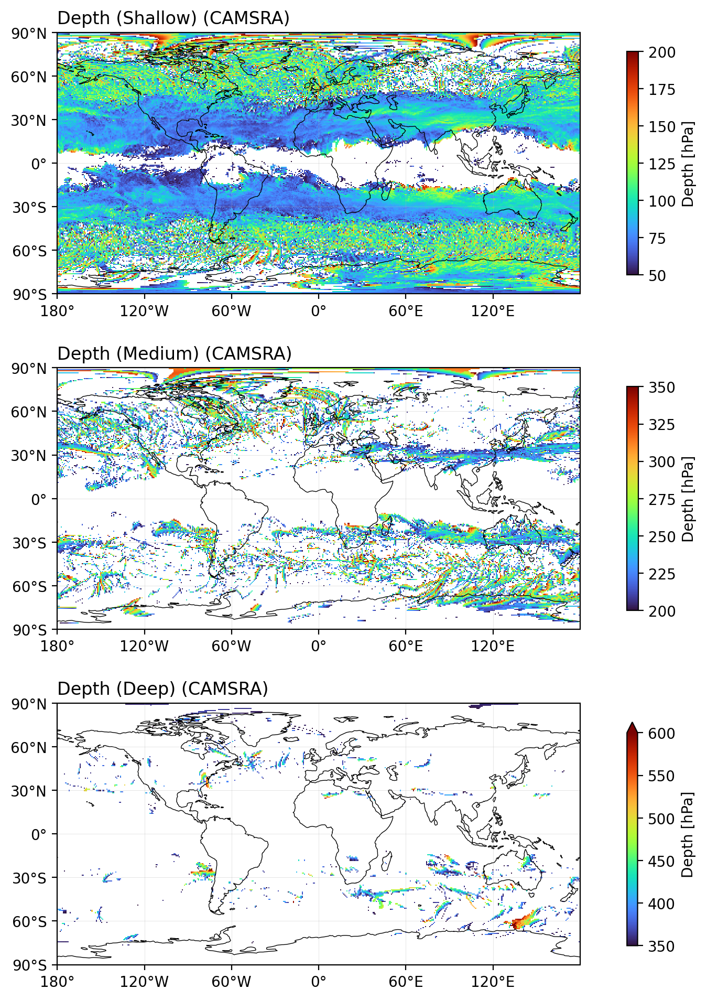

In [473]:
# CAMSRA vs ERA5 folding, timemean

dps = [cam_dp_s_time, cam_dp_m_time, cam_dp_d_time]
pnum = len(dps)
titles = ['Depth (Shallow) (CAMSRA)','Depth (Medium) (CAMSRA)','Depth (Deep) (CAMSRA)']
vmaxes = [200,350,600]
vmins = [50,200,350]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120]
xticklabels = ['180°', '120°W', '60°W', '0°', '60°E', '120°E']


plt.figure(figsize=(8.25,4*pnum),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(pnum,1,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    cyclic_dataarray(dp,'lon').plot.imshow(ax=ax, vmin=vmins[pp], vmax=vmaxes[pp], transform=ccrs.PlateCarree(), cmap = 'turbo', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Depth [hPa]'})
    #     ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='left')
    
# plt.tight_layout()


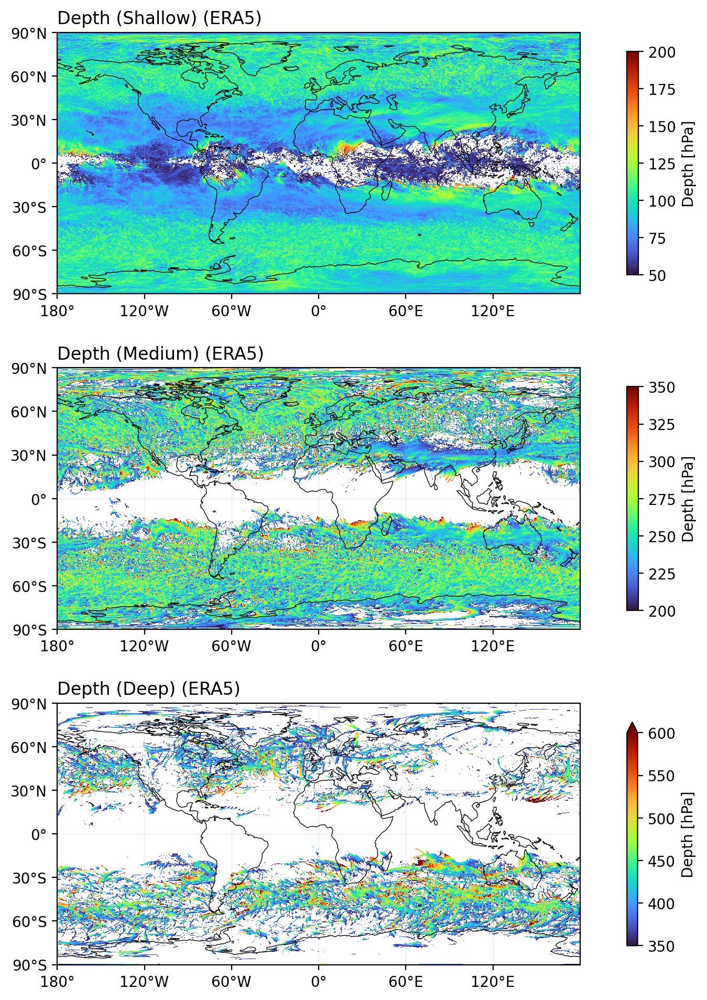

In [474]:
# CAMSRA vs ERA5 folding, timemean

dps = [era_dp_s_time, era_dp_m_time, era_dp_d_time]
pnum = len(dps)
titles = ['Depth (Shallow) (ERA5)','Depth (Medium) (ERA5)','Depth (Deep) (ERA5)']
vmaxes = [200,350,600]
vmins = [50,200,350]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120]
xticklabels = ['180°', '120°W', '60°W', '0°', '60°E', '120°E']


plt.figure(figsize=(8.25,4*pnum),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(pnum,1,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    cyclic_dataarray(dp,'lon').plot.imshow(ax=ax, vmin=vmins[pp], vmax=vmaxes[pp], transform=ccrs.PlateCarree(), cmap = 'turbo', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Depth [hPa]'})
#     ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='left')
    
# plt.tight_layout()


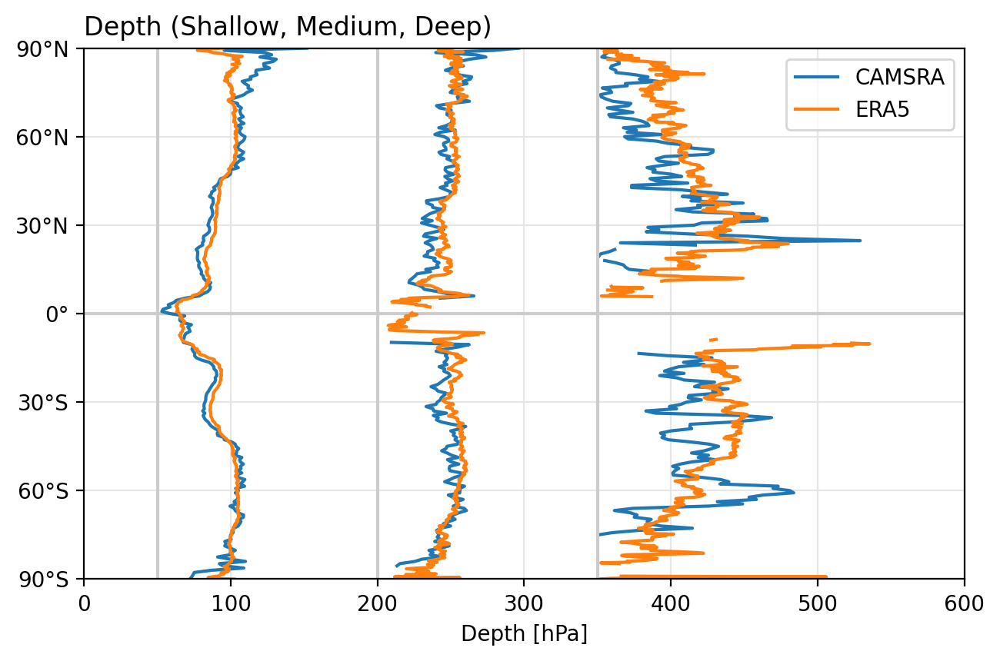

In [476]:
nrows = 1
ncols = 3

foldsets = [[cam_dp_s_time, era_dp_s_time],[cam_dp_m_time, era_dp_m_time],[cam_dp_d_time, era_dp_d_time]]

plt.figure(figsize=(6*1.1,4*1.1),dpi=200)

plt.axhline(0,color='.8')
plt.grid(c='.9')

for cc in range(ncols):
    foldsets[cc][0].mean('lon').plot(color='tab:blue',y='lat')
    foldsets[cc][1].mean('lon').plot(color='tab:orange',y='lat')
    
plt.axvline(50,color='.8')
plt.axvline(200,color='.8')
plt.axvline(350,color='.8')
plt.ylim(-90,90)
plt.xlim(0,600)
plt.ylabel('')
plt.xlabel('Depth [hPa]')
plt.title('Depth (Shallow, Medium, Deep)',loc='left')
plt.yticks([-90,-60,-30,0,30,60,90])
plt.gca().yaxis.set_major_formatter(LATITUDE_FORMATTER)
plt.plot([],[],ls='-',color='tab:blue',label='CAMSRA')
plt.plot([],[],ls='-',color='tab:orange',label='ERA5')
plt.legend() 

plt.tight_layout()


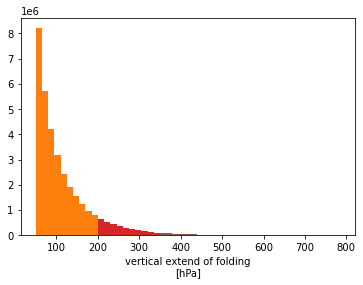

In [1145]:
listed = [cam_dp_s, era_dp_s,
          cam_dp_m, era_dp_m,
          cam_dp_d, era_dp_d]
binses = [np.arange(50,215,15), np.arange(50,215,15),
          np.arange(200,365,15), np.arange(200,365,15),
          np.arange(350,800,15), np.arange(350,800,15)]

histdatas = []
for nn,data in enumerate(listed):
    test = data.plot.hist(bins=binses[nn])
    counts = test[0]
    bins = test[1]
    medians = data.mean()
    histdatas.append([counts,bins,medians])
    
del era_dp_s
del era_dp_m 
del era_dp_d


89.22818
94.71589
246.25642
251.75146
414.18066
426.56274


[Text(400, 0, ''),
 Text(450, 0, '450'),
 Text(500, 0, ''),
 Text(550, 0, '550'),
 Text(600, 0, ''),
 Text(650, 0, '650')]

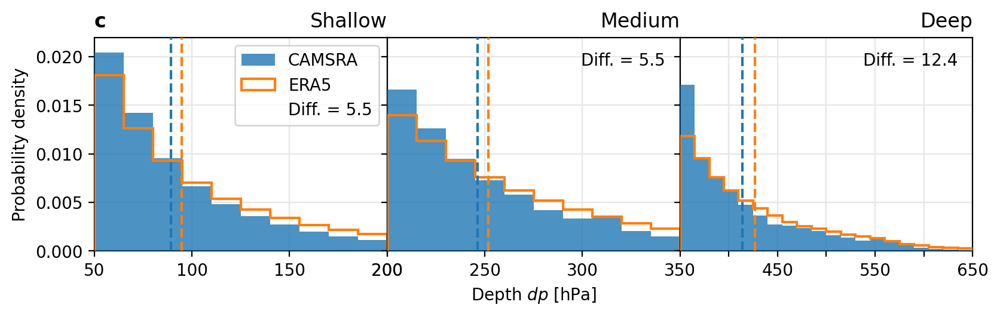

In [1146]:
titles = ['Shallow','Medium','Deep']
xlims = [(50,200),(200,350),(350,650)]

fac = .79
fig,axs = plt.subplots(1,3,figsize=(3*4*fac,3*fac),dpi=200,sharey=True,gridspec_kw={'wspace':0})

for ii,hh in enumerate(range(len(histdatas))[::2]):
    
    ax = axs.reshape(-1)[ii]
    ax.grid(c='.9')

    # CAM
    counts = histdatas[hh][0]
    bins = histdatas[hh][1]
    median = histdatas[hh][2]
    print(median.values)
    centroids = (bins[1:] + bins[:-1]) / 2
    ax.hist(centroids, bins=len(counts),weights=counts, range=(min(bins), max(bins)),density=True,orientation='vertical',label='CAMSRA',alpha=.8,zorder=4)
    ax.axvline(median ,color='tab:blue',ls='--',label='',zorder=5)

    # ERA5
    counts = histdatas[hh+1][0]
    bins = histdatas[hh+1][1]
    median2 = histdatas[hh+1][2]
    print(median2.values)
    centroids = (bins[1:] + bins[:-1]) / 2
    ax.hist(centroids, bins=len(counts),weights=counts, range=(min(bins), max(bins)),histtype='step',linewidth=1.5,density=True,orientation='vertical',label='ERA5',zorder=4)
    ax.axvline(median2 ,color='tab:orange',ls='--',label='',zorder=5)
    
    diff = "{:0.1f}".format((median2 - median).values)
    ax.plot([],[],ls='none',label=f'Diff. = {diff}')

    ax.set_ylim(0,.022)
#     ax.set_ylim(0,1000000)
    ax.set_xlim((xlims[ii]))
    ax.set_title(titles[ii],loc='right')

    if ii == 0:
#         current_handles, current_labels = ax.get_legend_handles_labels()
#         new_handles = [current_handles[2],current_handles[0],current_handles[3],current_handles[1]]
#         new_labels = [current_labels[2],current_labels[0],current_labels[3],current_labels[1]]
#         ax.legend(new_handles,new_labels)
        current_handles, current_labels = ax.get_legend_handles_labels()
        new_handles = [current_handles[1],current_handles[2],current_handles[0]]
        new_labels = [current_labels[1],current_labels[2],current_labels[0]]
        ax.legend(new_handles,new_labels)
        ax.set_ylabel('Probability density')
        ax.set_title('c',loc='left',fontweight='bold')
        
    if ii > 0:
        current_handles, current_labels = ax.get_legend_handles_labels()
        new_handles = [current_handles[0]]
        new_labels = [current_labels[0]]
        ax.legend(new_handles,new_labels,frameon=False)
        
    if ii == 1:
        ax.set_xlabel('Depth $\mathit{dp}$ [hPa]')
        
ax.set_xticks(np.arange(400,700,50))
ax.set_xticklabels(['','450','','550','','650'])#,''])#,'750'])


89.22818
94.71589
246.25642
251.75146
414.18066
426.56274


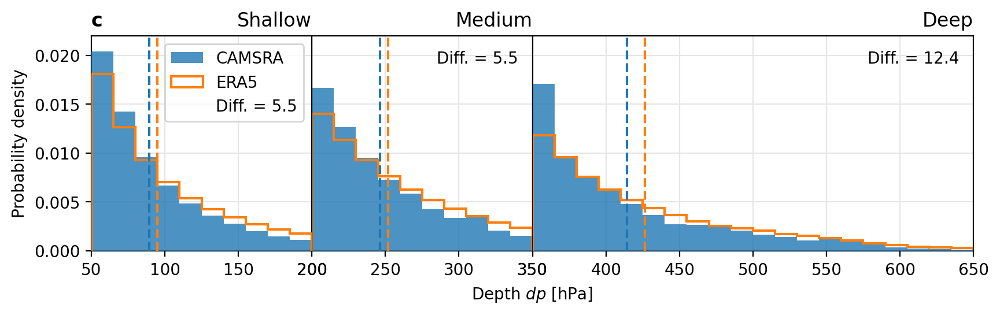

In [1148]:
titles = ['Shallow','Medium','Deep']
xlims = [(50,200),(200,350),(350,650)]

# fac = .79
fac = .82
fig = plt.figure(figsize=(3*4*fac,3*fac),dpi=200)
axs = fig.subplot_mosaic([['a', 'b', 'c' ,'c']],gridspec_kw={'wspace':0})

for ii,hh in enumerate(range(len(histdatas))[::2]):
    
    if ii == 0:
        ax = axs['a']
    if ii == 1:
        ax = axs['b']
    if ii == 2:
        ax = axs['c']
    ax.grid(c='.9')

    # CAM
    counts = histdatas[hh][0]
    bins = histdatas[hh][1]
    median = histdatas[hh][2]
    print(median.values)
    centroids = (bins[1:] + bins[:-1]) / 2
    ax.hist(centroids, bins=len(counts),weights=counts, range=(min(bins), max(bins)),density=True,orientation='vertical',label='CAMSRA',alpha=.8,zorder=4)
    ax.axvline(median ,color='tab:blue',ls='--',label='',zorder=5)

    # ERA5
    counts = histdatas[hh+1][0]
    bins = histdatas[hh+1][1]
    median2 = histdatas[hh+1][2]
    print(median2.values)
    centroids = (bins[1:] + bins[:-1]) / 2
    ax.hist(centroids, bins=len(counts),weights=counts, range=(min(bins), max(bins)),histtype='step',linewidth=1.5,density=True,orientation='vertical',label='ERA5',zorder=4)
    ax.axvline(median2 ,color='tab:orange',ls='--',label='',zorder=5)
    
    diff = "{:0.1f}".format((median2 - median).values)
    ax.plot([],[],ls='none',label=f'Diff. = {diff}')

    ax.set_ylim(0,.022)
#     ax.set_ylim(0,1000000)
    ax.set_xlim((xlims[ii]))
    ax.set_title(titles[ii],loc='right')

    if ii == 0:
#         current_handles, current_labels = ax.get_legend_handles_labels()
#         new_handles = [current_handles[2],current_handles[0],current_handles[3],current_handles[1]]
#         new_labels = [current_labels[2],current_labels[0],current_labels[3],current_labels[1]]
#         ax.legend(new_handles,new_labels)
        current_handles, current_labels = ax.get_legend_handles_labels()
        new_handles = [current_handles[1],current_handles[2],current_handles[0]]
        new_labels = [current_labels[1],current_labels[2],current_labels[0]]
        ax.legend(new_handles,new_labels)
        ax.set_ylabel('Probability density')
        ax.set_title('c',loc='left',fontweight='bold')
        
    if ii > 0:
        current_handles, current_labels = ax.get_legend_handles_labels()
        new_handles = [current_handles[0]]
        new_labels = [current_labels[0]]
        ax.legend(new_handles,new_labels,frameon=False)
        ax.set_yticklabels([])
        ax.tick_params(axis='y',length=0)
        
    if ii == 1:
        ax.set_xlabel('Depth $\mathit{dp}$ [hPa]')
        ax.xaxis.set_label_coords(1, -.16)
        
# ax.set_xticks(np.arange(400,700,50))
# ax.set_xticklabels(['','450','','550','','650'])#,''])#,'750'])


In [479]:
with pbar:
    cam_th_s = (dscam.pmax.where(camfolds) - (dscam.pmin.where(camfolds) + dscam.dp.where(camfolds))).compute()
    era_th_s = (dsera.pmax.where(erafolds) - (dsera.pmin.where(erafolds) + dsera.dp.where(erafolds))).compute()
    
    cam_th_m = (dscam.pmax.where(camfoldm) - (dscam.pmin.where(camfoldm) + dscam.dp.where(camfoldm))).compute()
    era_th_m = (dsera.pmax.where(erafoldm) - (dsera.pmin.where(erafoldm) + dsera.dp.where(erafoldm))).compute()

    cam_th_d = (dscam.pmax.where(camfoldd) - (dscam.pmin.where(camfoldd) + dscam.dp.where(camfoldd))).compute()
    era_th_d = (dsera.pmax.where(erafoldd) - (dsera.pmin.where(erafoldd) + dsera.dp.where(erafoldd))).compute()
    

[########################################] | 100% Completed |  1min 49.8s
[########################################] | 100% Completed |  2min 28.4s
[########################################] | 100% Completed |  2min 53.0s
[########################################] | 100% Completed |  3min  2.8s
[########################################] | 100% Completed | 37.8s
[########################################] | 100% Completed |  1min 19.5s


In [1138]:
# # Save:

# cam_th_s.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_th_s.nc')
# era_th_s.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_th_s.nc')

# cam_th_m.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_th_m.nc')
# era_th_m.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_th_m.nc')

# cam_th_d.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_th_d.nc')
# era_th_d.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_th_d.nc')


# Open:

cam_th_s = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_th_s.nc')
era_th_s = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_th_s.nc')

cam_th_m = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_th_m.nc')
era_th_m = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_th_m.nc')

cam_th_d = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_th_d.nc')
era_th_d = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_th_d.nc')


In [481]:
with pbar:
    cam_th_s_time = cam_th_s.mean('time').compute()
    era_th_s_time = era_th_s.mean('time').compute()
    
    cam_th_m_time = cam_th_m.mean('time').compute()
    era_th_m_time = era_th_m.mean('time').compute()

    cam_th_d_time = cam_th_d.mean('time').compute()
    era_th_d_time = era_th_d.mean('time').compute()
    

In [482]:
# Save:

# cam_th_s_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_th_s_time.nc')
# era_th_s_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_th_s_time.nc')

# cam_th_m_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_th_m_time.nc')
# era_th_m_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_th_m_time.nc')

# cam_th_d_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_th_d_time.nc')
# era_th_d_time.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_th_d_time.nc')


# Open:

cam_th_s_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_th_s_time.nc')
era_th_s_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_th_s_time.nc')

cam_th_m_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_th_m_time.nc')
era_th_m_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_th_m_time.nc')

cam_th_d_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_th_d_time.nc')
era_th_d_time = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_th_d_time.nc')


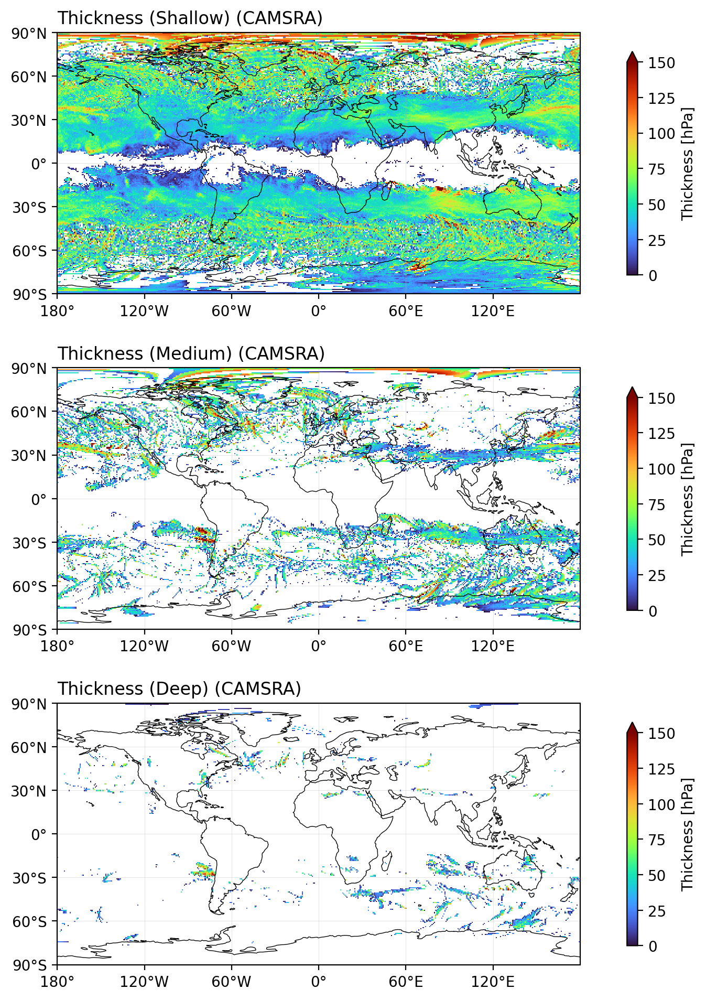

In [483]:
# CAMSRA vs ERA5 folding, timemean

dps = [cam_th_s_time, cam_th_m_time, cam_th_d_time]
pnum = len(dps)
titles = ['Thickness (Shallow) (CAMSRA)','Thickness (Medium) (CAMSRA)','Thickness (Deep) (CAMSRA)']
vmaxes = [150,150,150]
vmins = [0,0,0]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120]
xticklabels = ['180°', '120°W', '60°W', '0°', '60°E', '120°E']


plt.figure(figsize=(8.25,4*pnum),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(pnum,1,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    cyclic_dataarray(dp,'lon').plot.imshow(ax=ax, vmin=vmins[pp], vmax=vmaxes[pp], transform=ccrs.PlateCarree(), cmap = 'turbo', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Thickness [hPa]'})
    #     ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='left')
    
# plt.tight_layout()


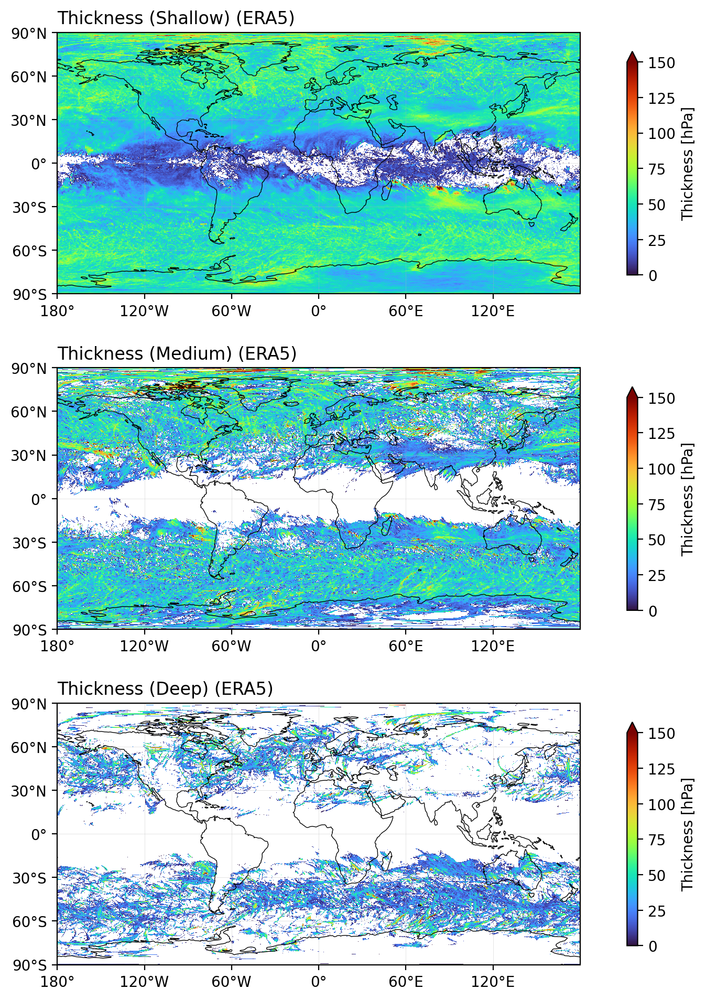

In [484]:
# CAMSRA vs ERA5 folding, timemean

dps = [era_th_s_time, era_th_m_time, era_th_d_time]
pnum = len(dps)
titles = ['Thickness (Shallow) (ERA5)','Thickness (Medium) (ERA5)','Thickness (Deep) (ERA5)']
vmaxes = [150,150,150]
vmins = [0,0,0]
yticks = [-90, -60, -30, 0, 30, 60, 90]
xticks = [-180, -120, -60, 0, 60, 120]
xticklabels = ['180°', '120°W', '60°W', '0°', '60°E', '120°E']


plt.figure(figsize=(8.25,4*pnum),dpi=200)
for pp in range(pnum):
    dp = dps[pp] ## input
    ax = plt.subplot(pnum,1,pp+1,projection=ccrs.PlateCarree(central_longitude=0))
    ax.coastlines('110m',color='0',linewidth=.5)
    cyclic_dataarray(dp,'lon').plot.imshow(ax=ax, vmin=vmins[pp], vmax=vmaxes[pp], transform=ccrs.PlateCarree(), cmap = 'turbo', cbar_kwargs={'pad':.07,'shrink':.8,'label':'Thickness [hPa]'})
    #     ax.set_ylim(-90,90) 
    ax.gridlines(draw_labels = False, xlocs=xticks, ylocs=yticks, color='.7', alpha=0.4, linewidth=.3)
    ax.yaxis.set_major_formatter(LATITUDE_FORMATTER)
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_xticklabels(xticklabels)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(titles[pp],loc='left')
    
# plt.tight_layout()


/tmp/ipykernel_2900/3506379165.py:28: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


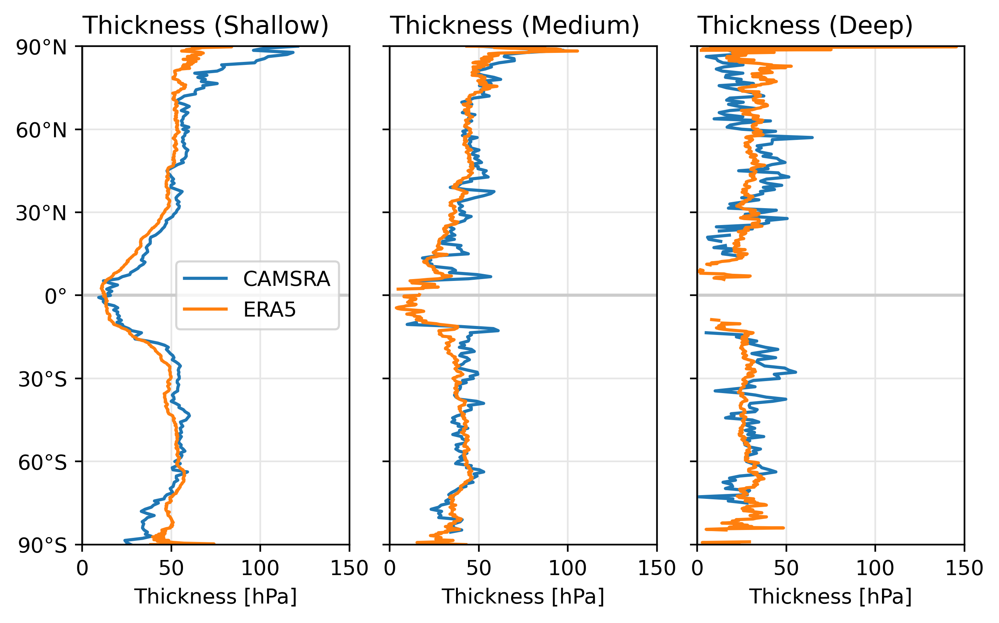

In [486]:
nrows = 1
ncols = 3

foldsets = [[cam_th_s_time, era_th_s_time],[cam_th_m_time, era_th_m_time],[cam_th_d_time, era_th_d_time]]
titles = ['Thickness (Shallow)', 'Thickness (Medium)', 'Thickness (Deep)']

fig,axs = plt.subplots(nrows,ncols,figsize=(2.3*1.1*ncols,4*1.1*nrows),sharey='all',dpi=400, gridspec_kw={'wspace':.15})

for cc in range(ncols):

    ax = axs[cc]
    ax.axhline(0,color='.8')
    ax.grid(c='.9')
    ax.axvline(0,c='.8')
    foldsets[cc][0].mean('lon').plot(ax=ax,y='lat',label='CAMSRA')
    foldsets[cc][1].mean('lon').plot(ax=ax,y='lat',label='ERA5')
    
    ax.set_ylim(-90,90)
    ax.set_ylabel('')
    ax.set_xlabel('Thickness [hPa]')
    ax.set_title(titles[cc],loc='left')
    ax.set_xlim((0,150))
    ax.set_yticks([-90,-60,-30,0,30,60,90])

axs[0].yaxis.set_major_formatter(LATITUDE_FORMATTER)
axs[0].legend() 

plt.tight_layout()


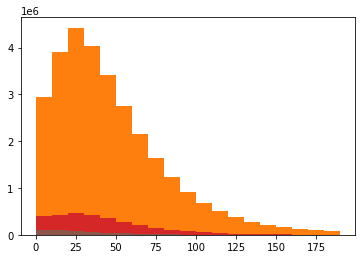

In [1139]:
listed = [cam_th_s, era_th_s,
          cam_th_m, era_th_m,
          cam_th_d, era_th_d]
bins = np.arange(0,200,10)

histdatas = []
for nn,data in enumerate(listed):
    test = data.plot.hist(bins=bins)
    counts = test[0]
    means = data.mean()
    medians = data.median()
    histdatas.append([counts,bins,means,medians])
    
del era_th_s
del era_th_m 
del era_th_d


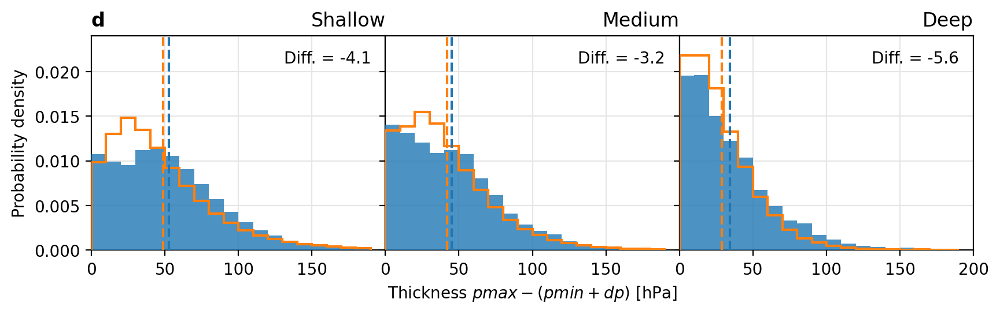

In [1143]:
titles = ['Shallow','Medium','Deep']
bins = np.arange(0,200,10)

# fac = .79
fac = .82
fig,axs = plt.subplots(1,3,figsize=(3*4*fac,3*fac),dpi=200,sharey=True,gridspec_kw={'wspace':0})

for ii,hh in enumerate(range(len(histdatas))[::2]):
    
    ax = axs.reshape(-1)[ii]
    ax.grid(c='.9')

    # CAM
    counts = histdatas[hh][0]
    mean = histdatas[hh][2]
    median = histdatas[hh][3]
    centroids = (bins[1:] + bins[:-1]) / 2
    ax.hist(centroids, bins=len(counts),weights=counts, range=(min(bins), max(bins)),density=True,orientation='vertical',label='',alpha=.8,zorder=4)
    ax.axvline(mean ,color='tab:blue',ls='--',label='',zorder=5)

    # ERA5
    counts = histdatas[hh+1][0]
    mean2 = histdatas[hh+1][2]
    median2 = histdatas[hh+1][3]
    centroids = (bins[1:] + bins[:-1]) / 2
    ax.hist(centroids, bins=len(counts),weights=counts, range=(min(bins), max(bins)),histtype='step',linewidth=1.5,density=True,orientation='vertical',label='',zorder=4)
    ax.axvline(mean2 ,color='tab:orange',ls='--',label='',zorder=5)
    
    diff = "{:0.1f}".format((mean2 - mean).values)
    ax.plot([],[],ls='none',label=f'Diff. = {diff}')

    ax.set_ylim(0,.024)
#     ax.set_ylim(0,1000000)
    ax.set_xlim(0,200)
    ax.set_title(titles[ii],loc='right')
    ax.legend(frameon=False)

    if ii == 0:
        ax.set_ylabel('Probability density')
        ax.set_title('d',loc='left',fontweight='bold')
        
    if ii == 1:
        ax.set_xlabel('Thickness $\mathit{pmax}-(\mathit{pmin}+\mathit{dp})$ [hPa]')
        
    if ii < 2:
        ax.set_xticks([0,50,100,150])
    


In [489]:
with pbar:
    cam_pmax_s = (dscam.pmax.where(camfolds)).compute()
    era_pmax_s = (dsera.pmax.where(erafolds)).compute()
    
    cam_pmax_m = (dscam.pmax.where(camfoldm)).compute()
    era_pmax_m = (dsera.pmax.where(erafoldm)).compute()

    cam_pmax_d = (dscam.pmax.where(camfoldd)).compute()
    era_pmax_d = (dsera.pmax.where(erafoldd)).compute()
    

[########################################] | 100% Completed |  2.9s
[########################################] | 100% Completed | 18.6s
[########################################] | 100% Completed |  2.9s
[########################################] | 100% Completed | 16.8s
[########################################] | 100% Completed |  3.0s
[########################################] | 100% Completed | 16.9s


In [490]:
with pbar:
    cam_pmin_s = (dscam.pmin.where(camfolds)).compute()
    era_pmin_s = (dsera.pmin.where(erafolds)).compute()
    
    cam_pmin_m = (dscam.pmin.where(camfoldm)).compute()
    era_pmin_m = (dsera.pmin.where(erafoldm)).compute()

    cam_pmin_d = (dscam.pmin.where(camfoldd)).compute()
    era_pmin_d = (dsera.pmin.where(erafoldd)).compute()
    

[########################################] | 100% Completed |  2.9s
[########################################] | 100% Completed | 16.9s
[########################################] | 100% Completed |  2.9s
[########################################] | 100% Completed | 16.0s
[########################################] | 100% Completed |  3.0s
[########################################] | 100% Completed | 15.9s


In [23]:
with pbar:
    cam_pmid_s = (dscam.pmin.where(camfolds) + dscam.dp.where(camfolds)).compute()
#     era_pmid_s = (dsera.pmin.where(erafolds) + dsera.dp.where(erafolds)).compute()
    
    cam_pmid_m = (dscam.pmin.where(camfoldm) + dscam.dp.where(camfoldm)).compute()
#     era_pmid_m = (dsera.pmin.where(erafoldm) + dsera.dp.where(erafoldm)).compute()

    cam_pmid_d = (dscam.pmin.where(camfoldd) + dscam.dp.where(camfoldd)).compute()
#     era_pmid_d = (dsera.pmin.where(erafoldd) + dsera.dp.where(erafoldd)).compute()
    

[########################################] | 100% Completed | 14.7s
[########################################] | 100% Completed |  4.2s
[########################################] | 100% Completed |  4.0s


# Fold thickness vs. resolution comparison (Fig. S3)

In [499]:
cam_dif_s = (cam_th_s - camres.sel(plev=cam_pmax_s,method='nearest').drop('plev'))
cam_dif_s.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dif_s.nc')
del cam_dif_s; gc.collect()
era_dif_s = (era_th_s - erares.sel(plev=era_pmax_s,method='nearest').drop('plev'))
era_dif_s.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dif_s.nc')
del era_dif_s; gc.collect()

cam_dif_m = (cam_th_m - camres.sel(plev=cam_pmax_m,method='nearest').drop('plev'))
cam_dif_m.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dif_m.nc')
del cam_dif_m; gc.collect()
era_dif_m = (era_th_m - erares.sel(plev=era_pmax_m,method='nearest').drop('plev'))
era_dif_m.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dif_m.nc')
del era_dif_m; gc.collect()

cam_dif_d = (cam_th_d - camres.sel(plev=cam_pmax_d,method='nearest').drop('plev'))
cam_dif_d.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/cam_dif_d.nc')
del cam_dif_d; gc.collect()
era_dif_d = (era_th_d - erares.sel(plev=era_pmax_d,method='nearest').drop('plev'))
era_dif_d.to_netcdf('/dx13/samuelb/trop_folds/comboedit2/era_dif_d.nc')
del era_dif_d; gc.collect()


10

In [1288]:
# Open:

cam_dif_s = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dif_s.nc')
era_dif_s = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dif_s.nc')

cam_dif_m = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dif_m.nc')
era_dif_m = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dif_m.nc')

cam_dif_d = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/cam_dif_d.nc')
era_dif_d = xr.open_dataarray('/dx13/samuelb/trop_folds/comboedit2/era_dif_d.nc')



[Text(0, 0.5, 'pmax [hPa]'),
 Text(0, 0.5, 'pmax [hPa]'),
 Text(0, 0.5, 'pmax [hPa]')]

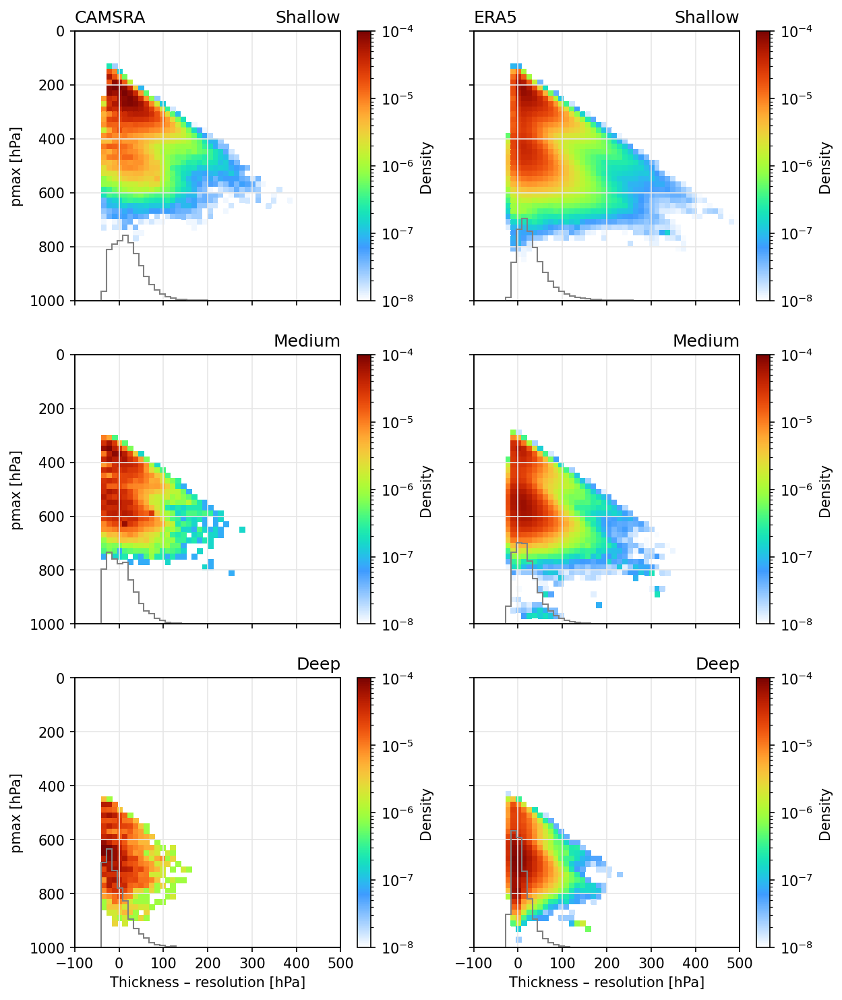

In [1289]:
time = slice(0,1465)

dsxs = [cam_dif_s, era_dif_s, 
        cam_dif_m, era_dif_m, 
        cam_dif_d, era_dif_d]
dsys = [cam_pmax_s, era_pmax_s, 
        cam_pmax_m, era_pmax_m, 
        cam_pmax_d, era_pmax_d]
lefttitles = ['CAMSRA','ERA5',
              '','',
              '','']
righttitles = ['Shallow','Shallow',
               'Medium','Medium',
               'Deep','Deep']

fig,axs = plt.subplots(3,2,figsize=(4*7/6*2,4*3),dpi=150,sharex=True,sharey=True)

for ax,dsx,dsy,lefttitle,righttitle in zip(axs.flat,dsxs,dsys,lefttitles,righttitles):

    ppx = dsx.isel(time=time).values.ravel()[np.isfinite(dsx.isel(time=time).values.ravel())]
    ppy = dsy.isel(time=time).values.ravel()[np.isfinite(dsy.isel(time=time).values.ravel())]

    pp = ax.hist2d(ppx,ppy,bins=50,range=[[-100, 500], [0, 1000]],cmap=cm.get_cmap('white_to_turbo'),norm=colors.LogNorm(vmin=1e-8,vmax=1e-4),density=True)
    ax.grid(c='.9',zorder=-1)

    ax.set_ylim(1000,0); ax.set_xlim(-100,500)
    ax.set_title(lefttitle,loc='left')
    ax.set_title(righttitle,loc='right')
    
    ax1 = ax.twinx()
    ax1.hist(ppx,bins=50,range=(-100,500),histtype='step',color='.5',density=True)
    ax1.set_ylim(0,.05); ax1.set_yticks([])

    plt.colorbar(pp[3],label='Density',ax=ax)
    
plt.setp(axs[-1, :], xlabel='Thickness – resolution [hPa]')
plt.setp(axs[:, 0], ylabel='pmax [hPa]')
